__author__ = 'Armando Collado-Villaverde'

__email__ = 'armando.collado@uah.es'

# 2 hours ahead SYM-H baseline model

Contains the comparison of the RMSE and the BFE metrics using a persistence model.
We first compare the metrics with all the SYM-H timeline minus the train and validation storms.
Then only for the test storms.
After that we compare the test storms individually using the proposed dates and extending the dates 10 days before and after.
Finally we create the plots used in the paper

* [Training settings](#section_1)
    * [Read data, fill missing values, add labels](#section_1_1)
    * [Plot the storms](#section_1_2)
    * [Scale the data](#section_1_3)
    * [Create TensorFlow datasets for the training and validation](#section_1_4)
    * [Definition of the model](#section_1_5)
    * [Training of the model](#section_1_6)
* [Evaluation of the model](#section_2)
    * [Evaluate the test storms](#section_2_1)
    * [Evaluate the test key storms](#section_2_2)
    * [Comparison to the 1 hour ahead model](#section_2_3)

In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
import copy
import matplotlib.pyplot as plt
import storm_dates
import utils
import pickle
import metrics

2024-01-17 12:13:34.894422: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-01-17 12:13:34.919125: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-17 12:13:34.919144: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-17 12:13:34.919158: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-17 12:13:34.923552: I tensorflow/core/platform/cpu_feature_g

In [2]:
physical_devices = tf.config.list_physical_devices('GPU')
try:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
except:
    pass
print(physical_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


2024-01-17 12:13:35.966605: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-01-17 12:13:35.969502: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-01-17 12:13:35.969600: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

# Training settings <a class="anchor" id="section_1"></a>

In [3]:
COLS_TO_USE = ['Bmag', 'Bx', 'By', 'Bz', 'Proton_density', 'Proton_speed_x',
       'Proton_temp', 'Pressure', 'E_field', 'SYM_H']

COLS_ORDER = [
    'Bmag', 'Bx', 'By', 'Bz', 'Proton_density', 'Proton_speed_x',
    'Proton_temp', 'Pressure', 'E_field', 'SYM_H',    
    'SYM_H-t120']

train_data_path = './data/preprocessed_data/train_storms'
val_data_path = './data/preprocessed_data/validation_storms'
test_data_path = './data/preprocessed_data/test_storms'
test_key_data_path = './data/preprocessed_data/test_key_storms'

INDEX_COL = "SYM_H"

plot_graphs = True

LABEL_COLUMN = 'SYM_H-t120'
SHIFT_VALUE = -24

checkpoint_filepath = './model_checkpoints/basic_2h_sym_e_field_36_lb'

batch_size = 128
lookback = 12 * 3
d_model = 128

RETRAIN = False

## Read data, fill missing values, add labels <a class="anchor" id="section_1_1"></a>

In [4]:
train_storms = utils.read_data(train_data_path)
val_storms = utils.read_data(val_data_path)
test_storms = utils.read_data(test_data_path)
test_key_storms = utils.read_data(test_key_data_path)

In [5]:
for i, _ in enumerate(train_storms):
    train_storms[i] = train_storms[i].interpolate()
    train_storms[i] = train_storms[i].ffill()
    train_storms[i] = train_storms[i].bfill()
    train_storms[i] = train_storms[i].fillna(0)
    train_storms[i] = utils.calculate_derived_params(train_storms[i])
    train_storms[i][LABEL_COLUMN] = train_storms[i][INDEX_COL].shift(SHIFT_VALUE).dropna()
    
for i, _ in enumerate(val_storms):
    val_storms[i] = val_storms[i].interpolate()
    val_storms[i] = val_storms[i].ffill()
    val_storms[i] = val_storms[i].bfill()
    val_storms[i] = val_storms[i].fillna(0)
    val_storms[i] = utils.calculate_derived_params(val_storms[i])
    val_storms[i][LABEL_COLUMN] = val_storms[i][INDEX_COL].shift(SHIFT_VALUE).dropna()
    
for i, _ in enumerate(test_storms):
    test_storms[i] = test_storms[i].interpolate()
    test_storms[i] = test_storms[i].ffill()
    test_storms[i] = test_storms[i].bfill()
    test_storms[i] = test_storms[i].fillna(0)
    test_storms[i] = utils.calculate_derived_params(test_storms[i])
    test_storms[i][LABEL_COLUMN] = test_storms[i][INDEX_COL].shift(SHIFT_VALUE).dropna()
    
for i, _ in enumerate(test_key_storms):
    test_key_storms[i] = test_key_storms[i].interpolate()
    test_key_storms[i] = test_key_storms[i].ffill()
    test_key_storms[i] = test_key_storms[i].bfill()
    test_key_storms[i] = test_key_storms[i].fillna(0)
    test_key_storms[i] = utils.calculate_derived_params(test_key_storms[i])
    test_key_storms[i][LABEL_COLUMN] = test_key_storms[i][INDEX_COL].shift(SHIFT_VALUE).dropna()

In [6]:
for i, storm in enumerate(train_storms):
    dts = utils.convert_to_datetime(storm_dates.TRAIN_STORMS[i][0])
    dte = utils.convert_to_datetime(storm_dates.TRAIN_STORMS[i][1])
    train_storms[i] = train_storms[i][dts:dte]
    
for i, storm in enumerate(val_storms):
    dts = utils.convert_to_datetime(storm_dates.VALIDATION_STORMS[i][0])
    dte = utils.convert_to_datetime(storm_dates.VALIDATION_STORMS[i][1])
    val_storms[i] = val_storms[i][dts:dte]

## Plot the storms <a class="anchor" id="section_1_2"></a>

train storm 1


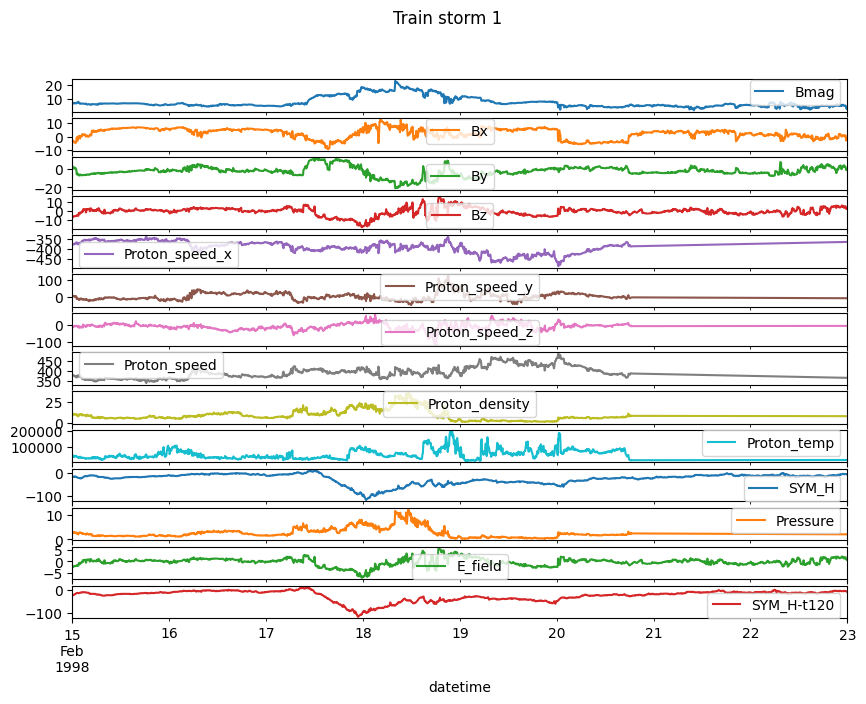

train storm 2


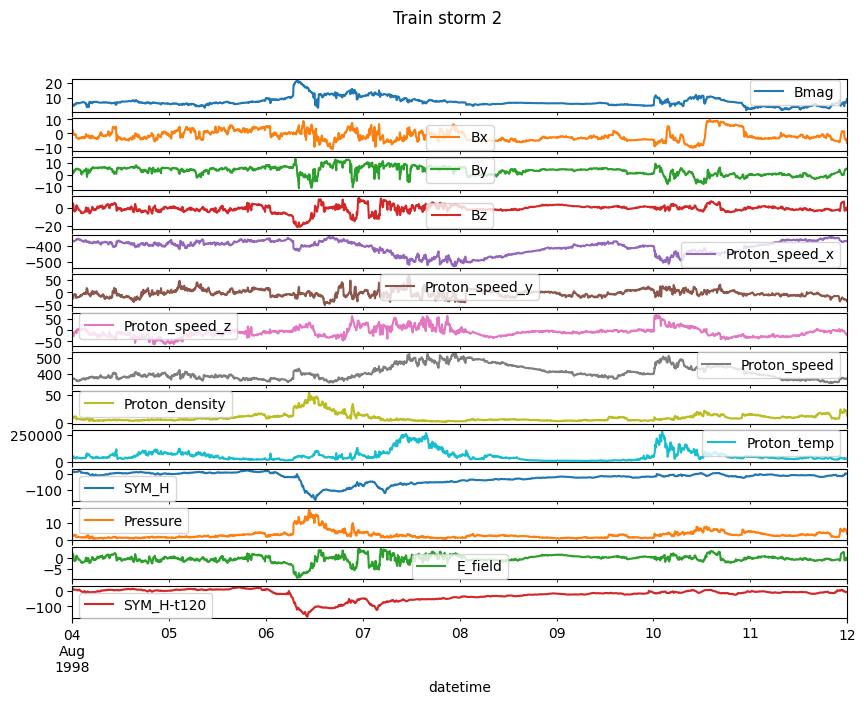

train storm 3


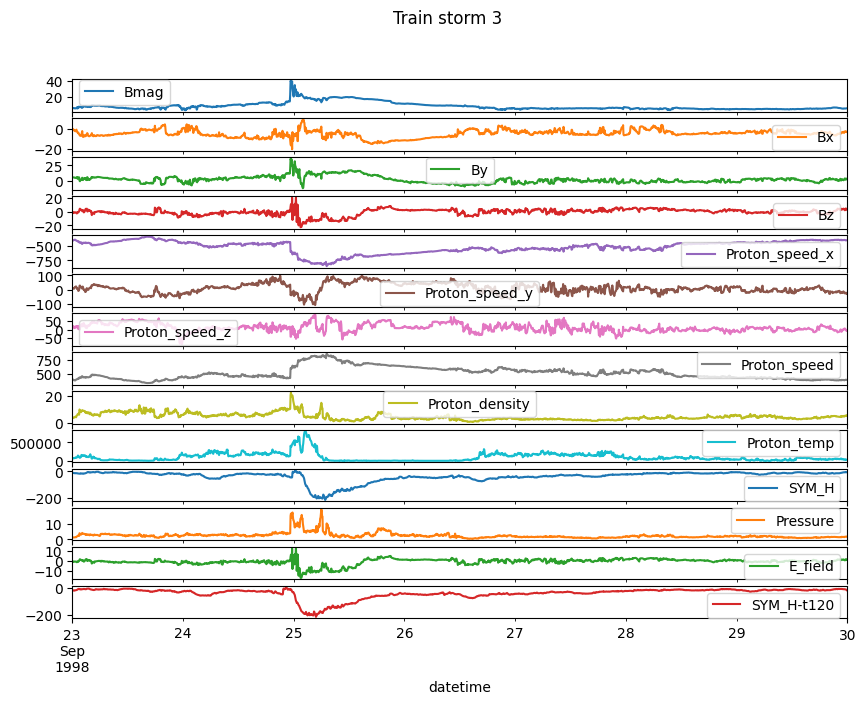

train storm 4


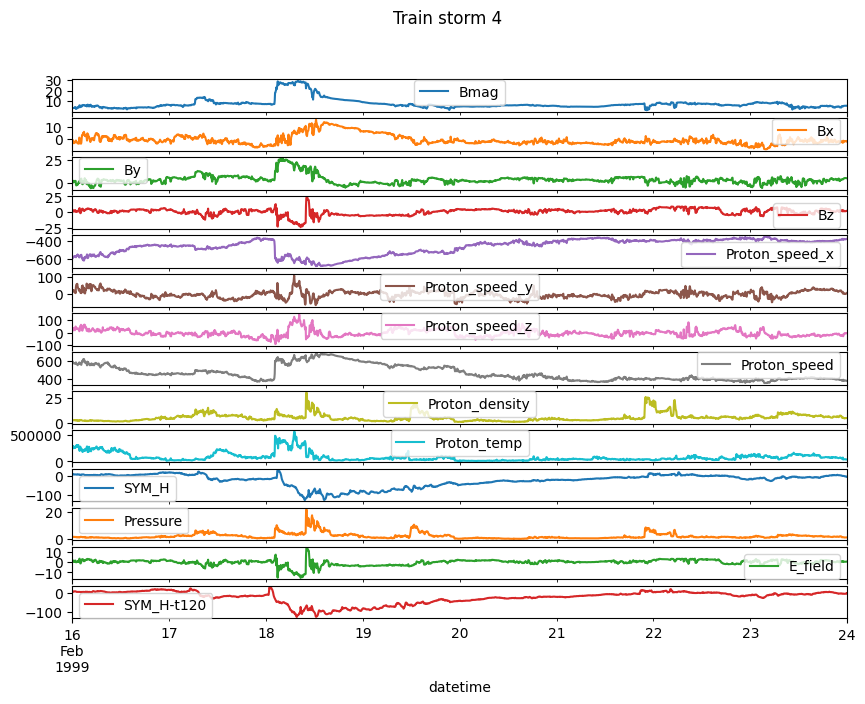

train storm 5


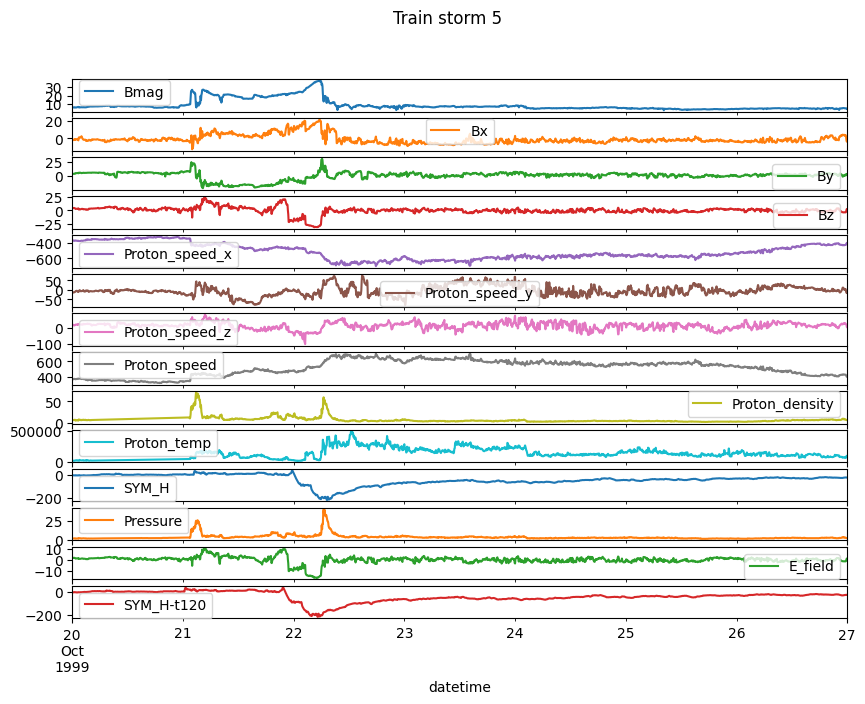

train storm 6


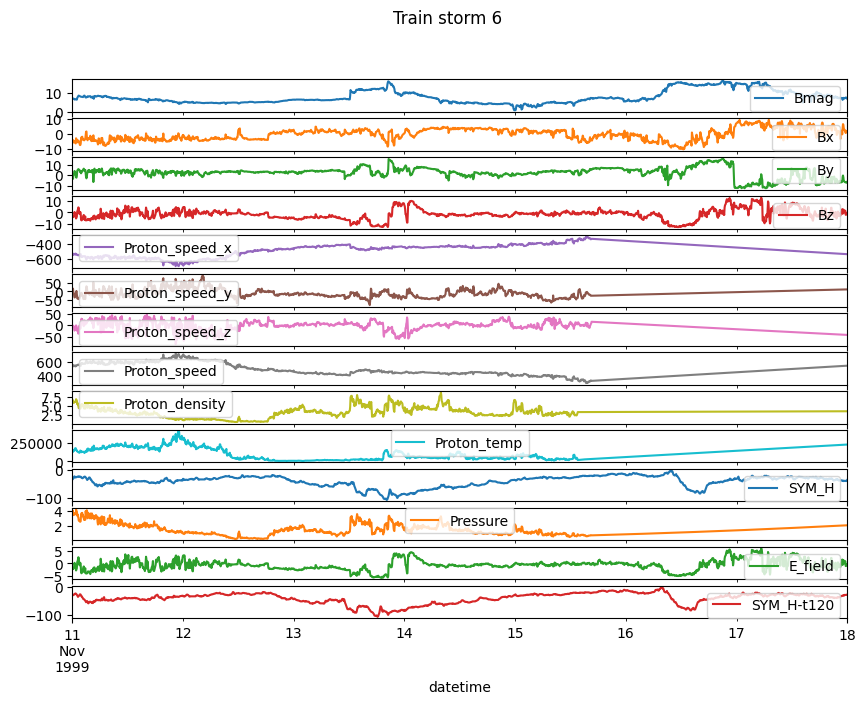

train storm 7


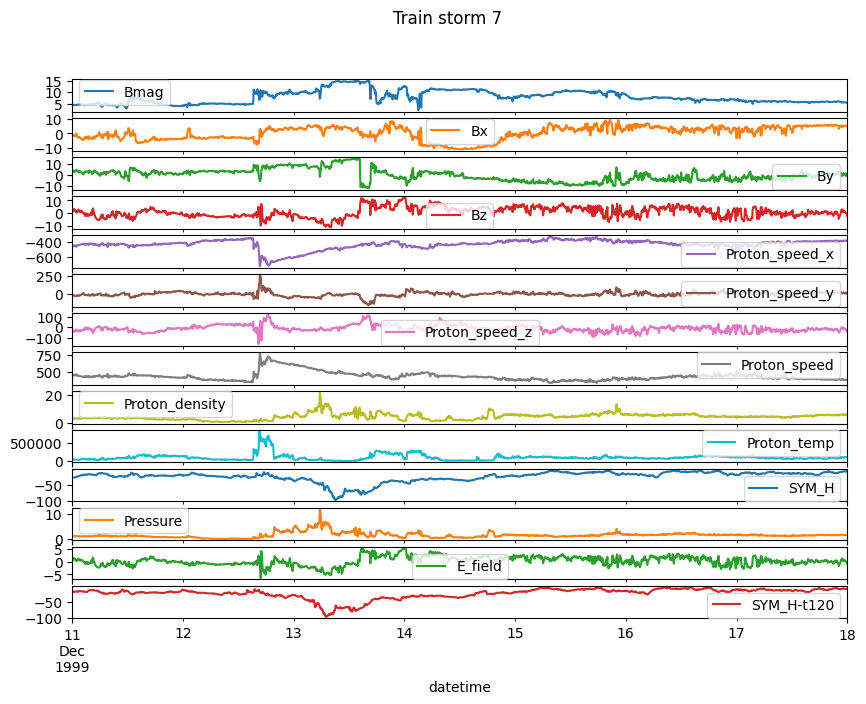

train storm 8


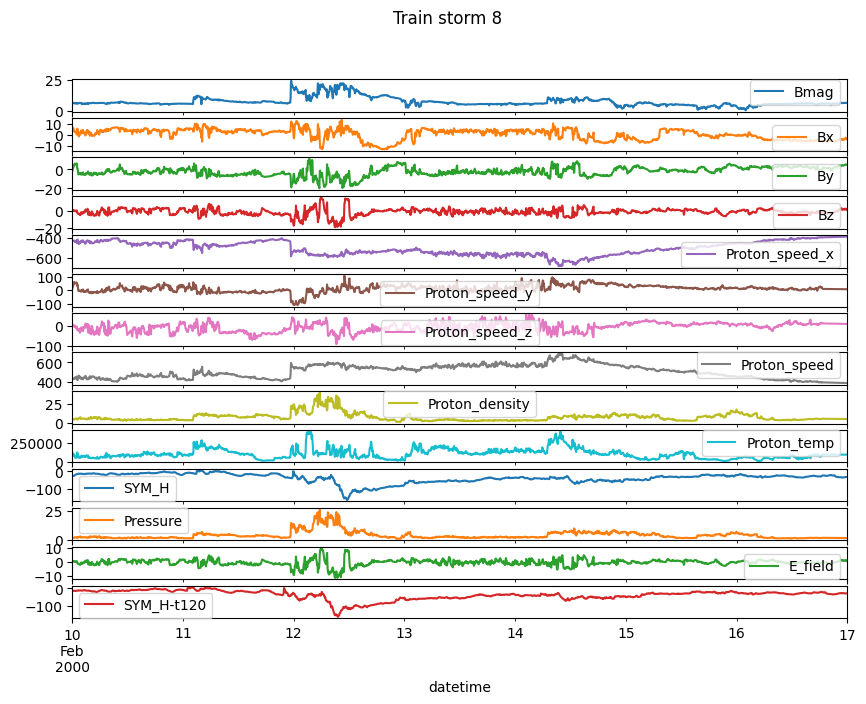

train storm 9


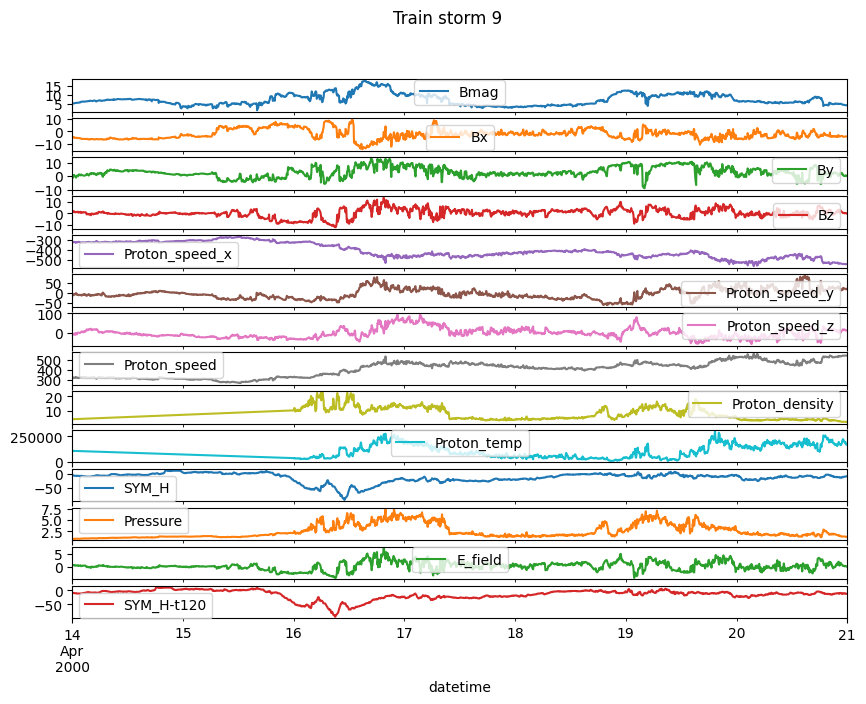

train storm 10


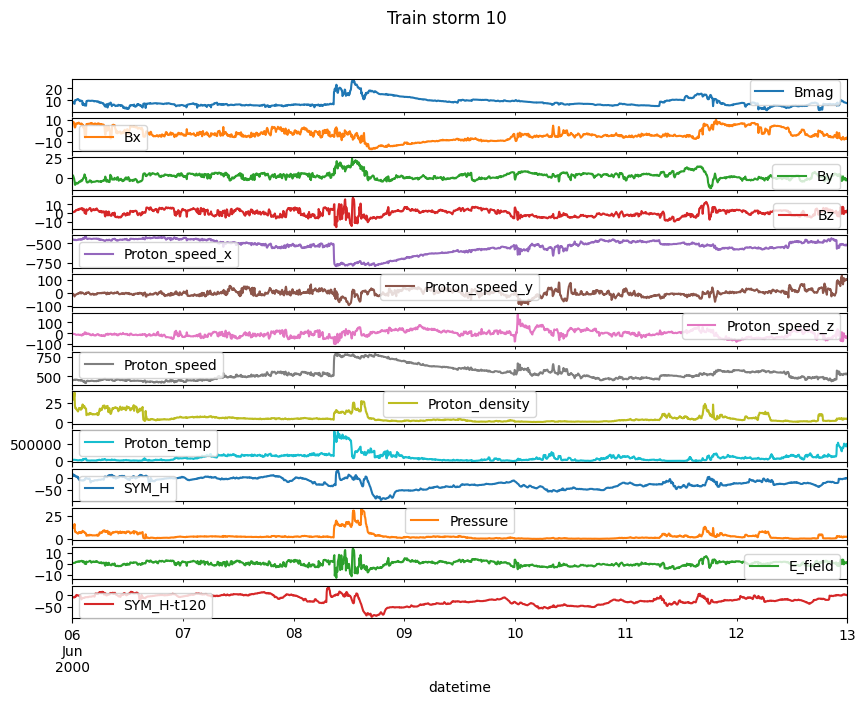

train storm 11


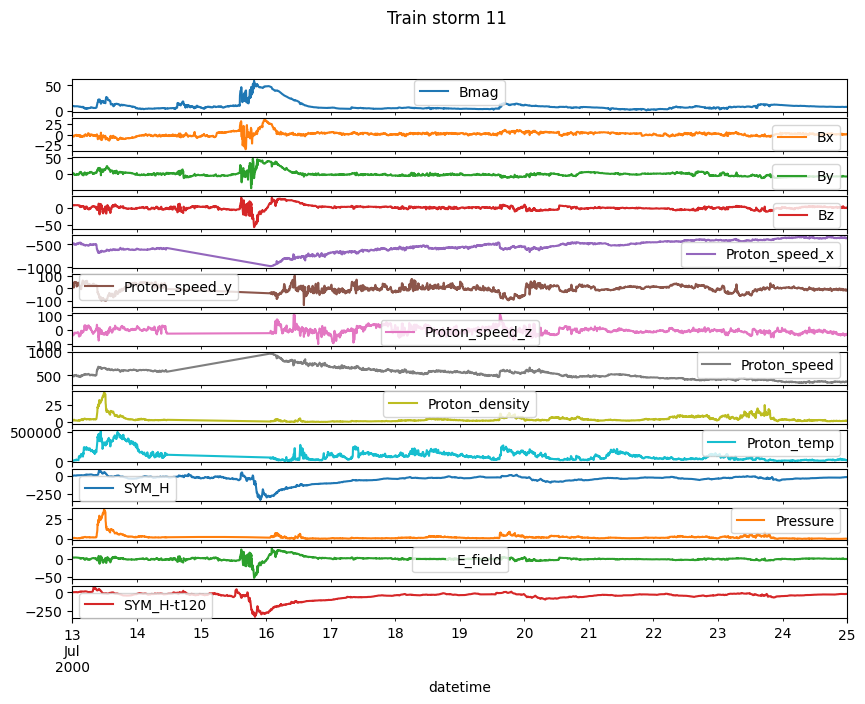

train storm 12


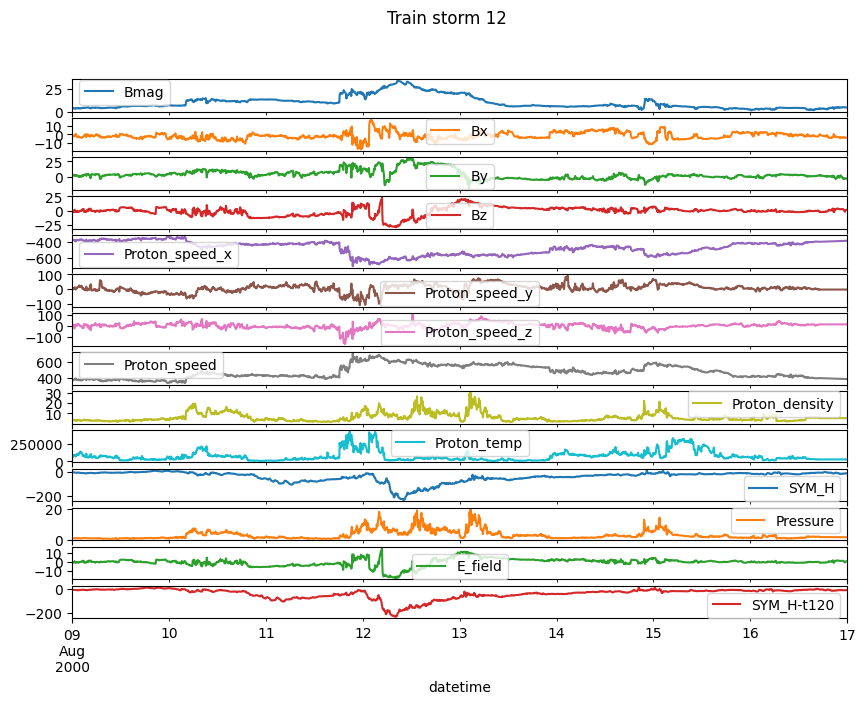

train storm 13


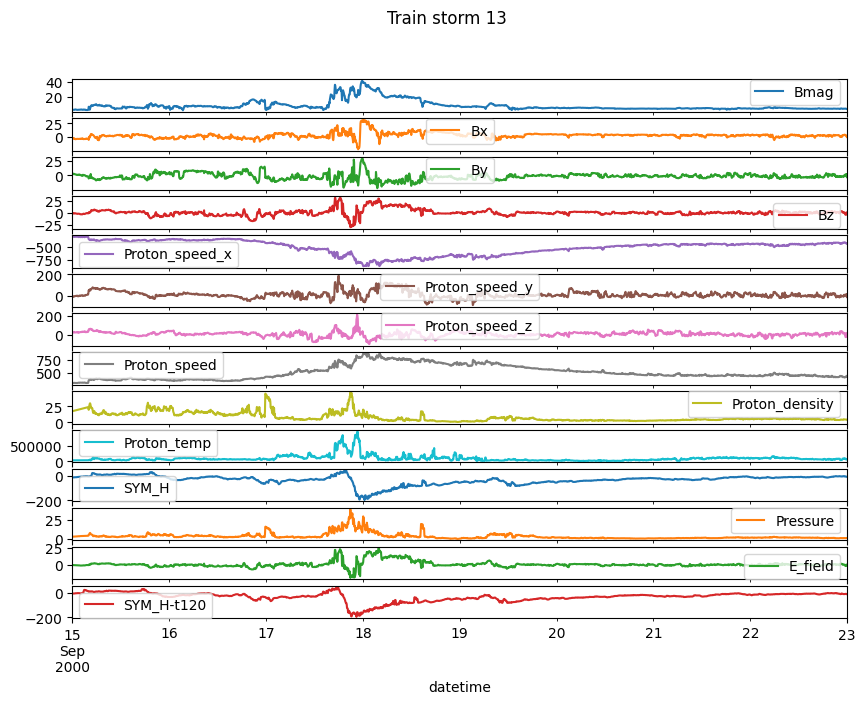

train storm 14


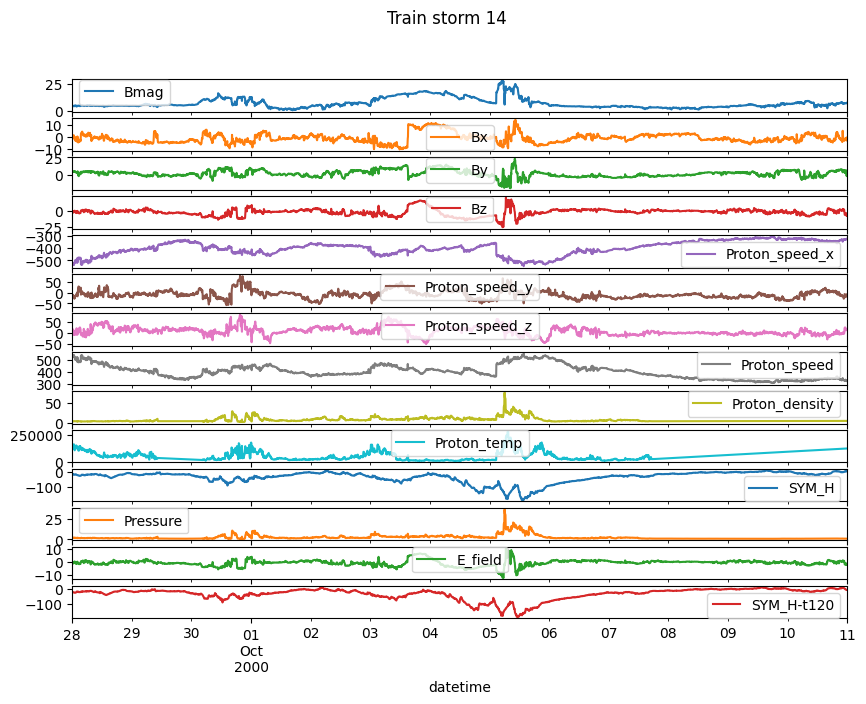

train storm 15


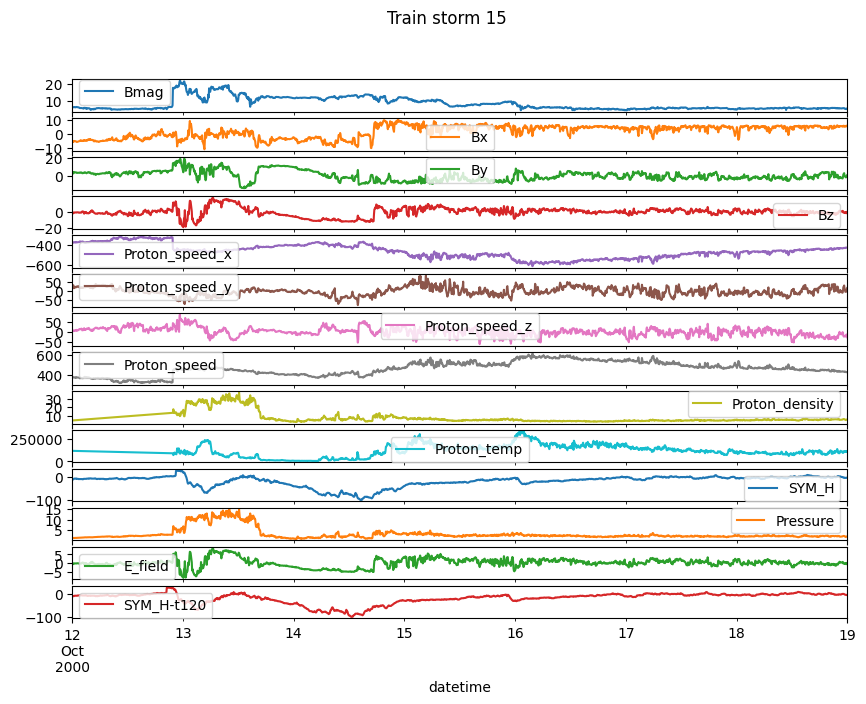

train storm 16


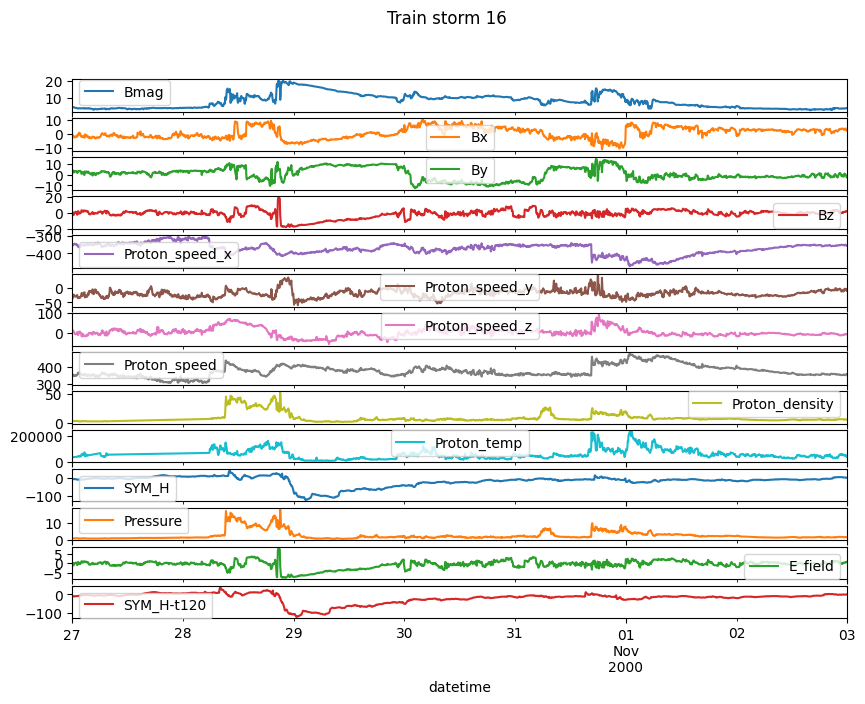

train storm 17


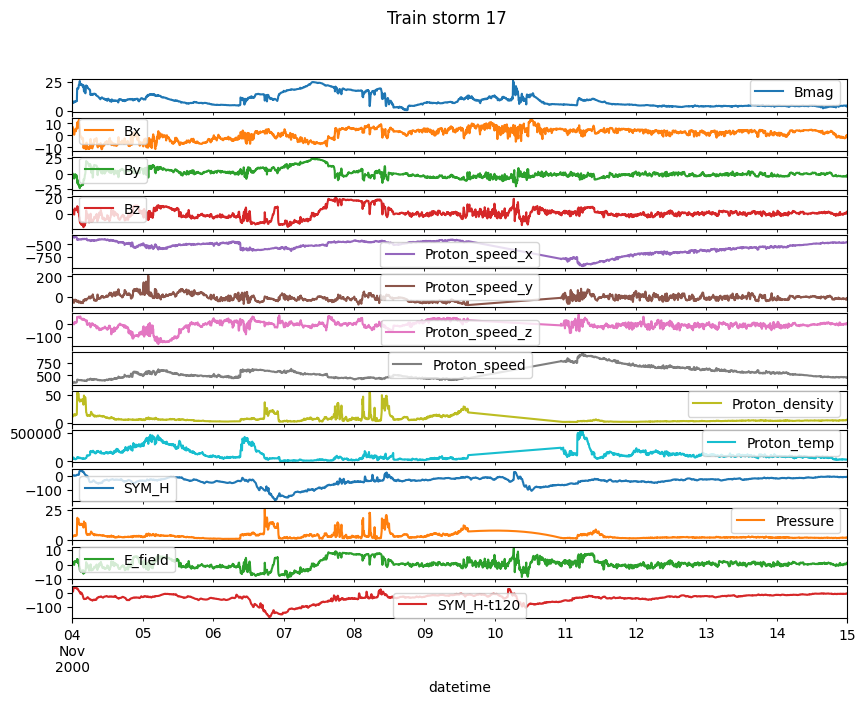

train storm 18


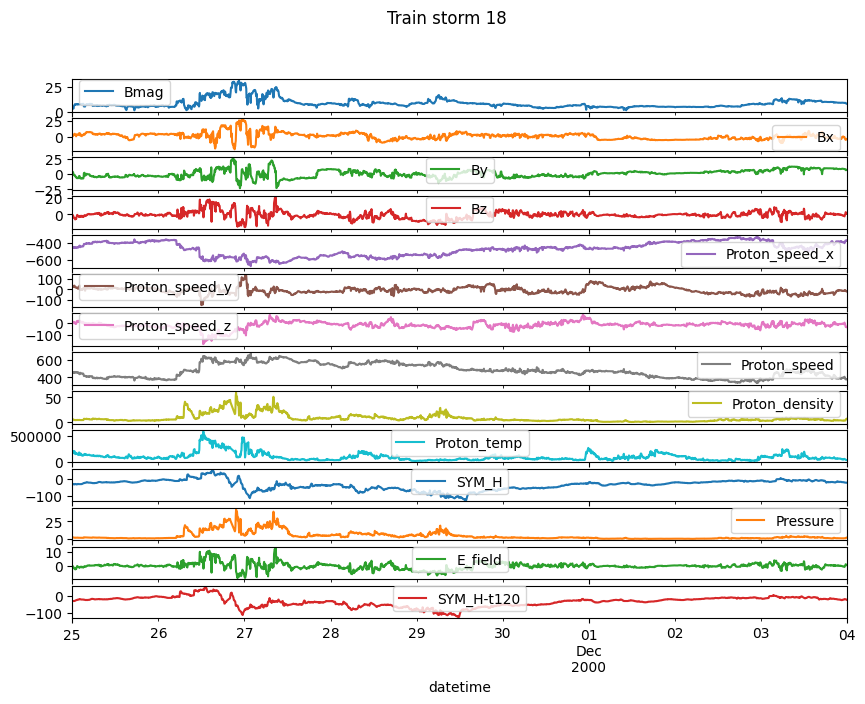

train storm 19


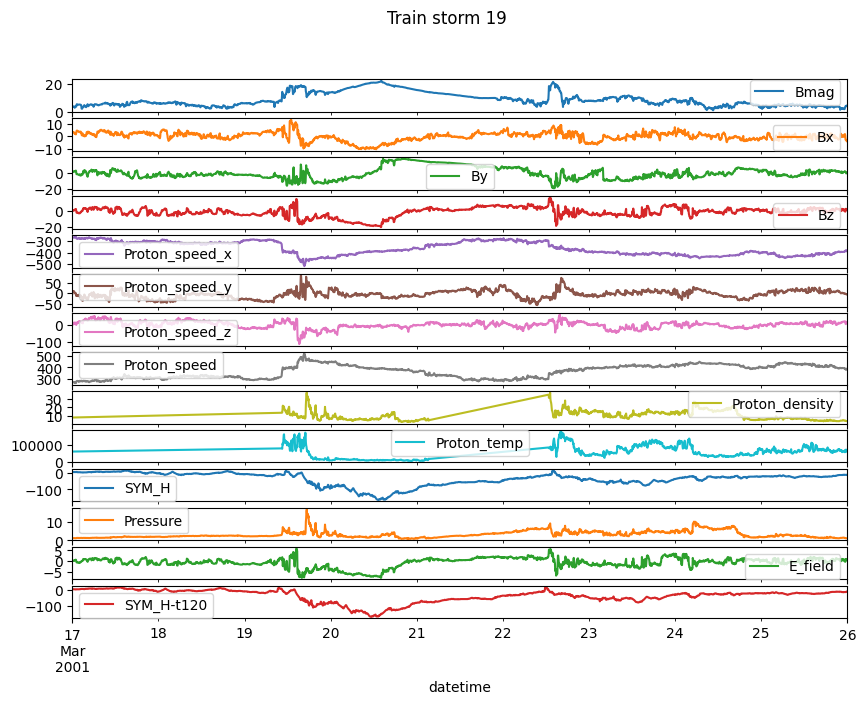

train storm 20


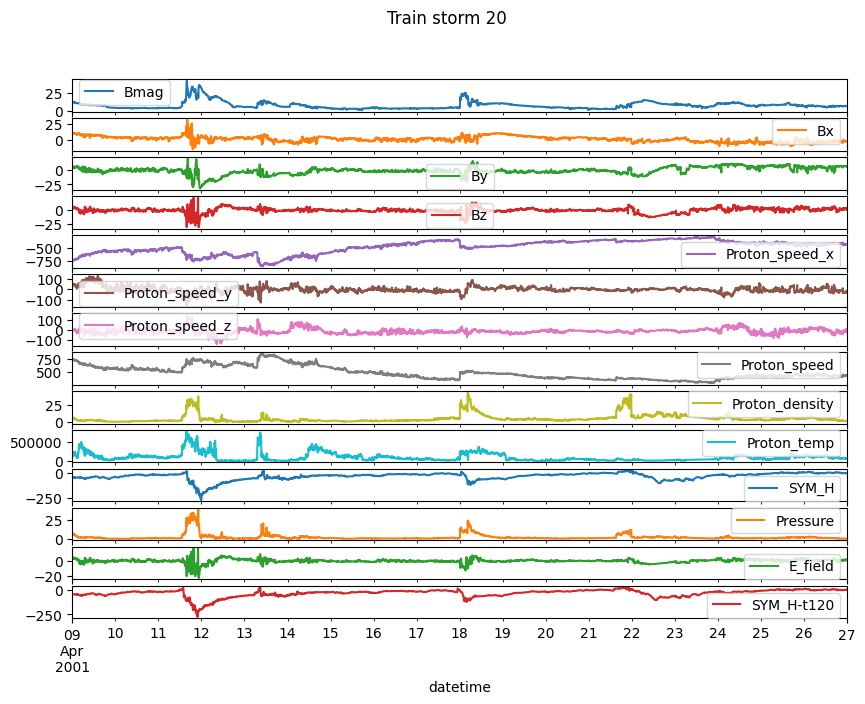

train storm 21


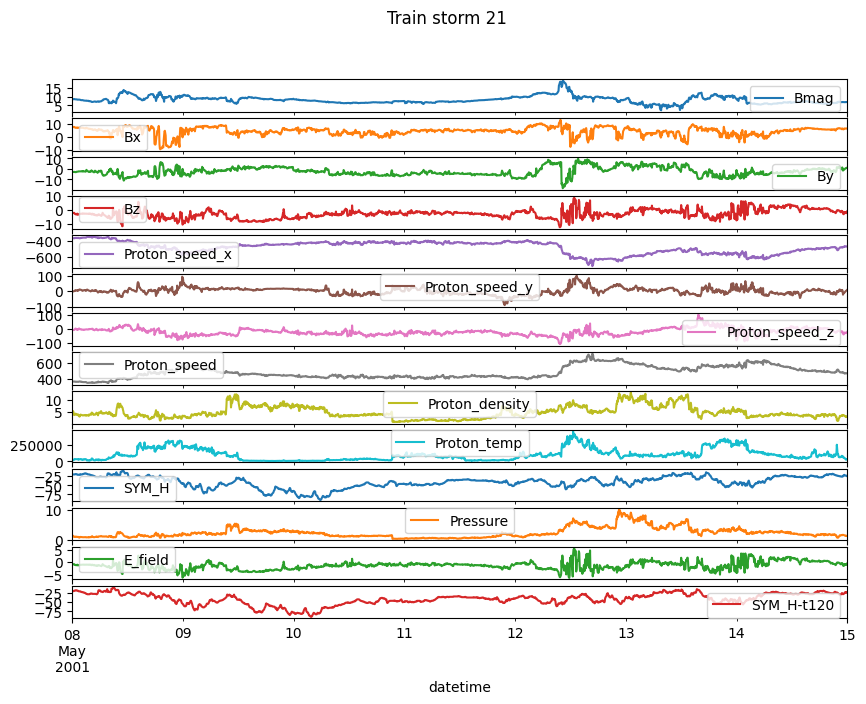

train storm 22


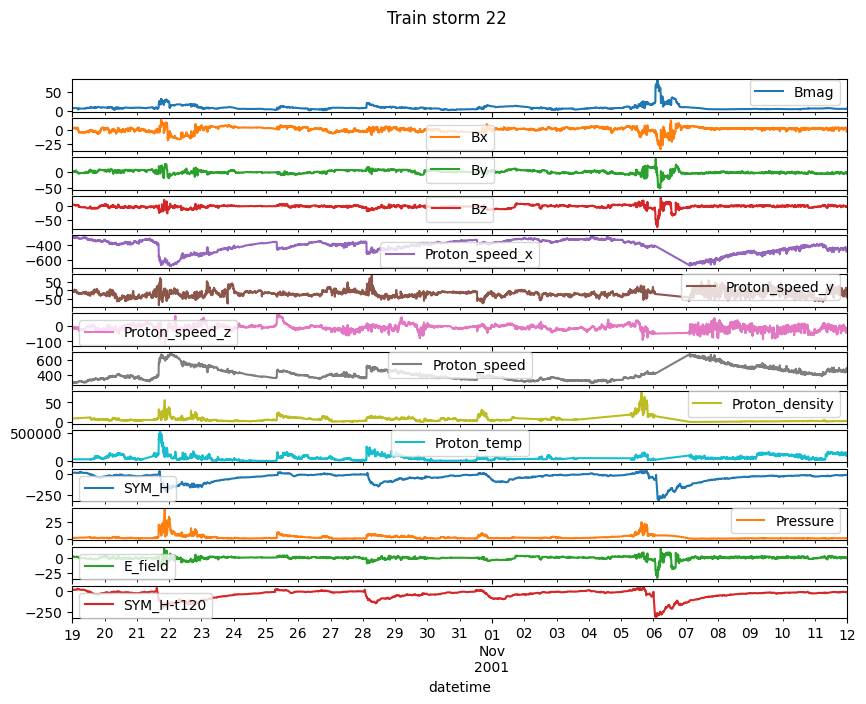

train storm 23


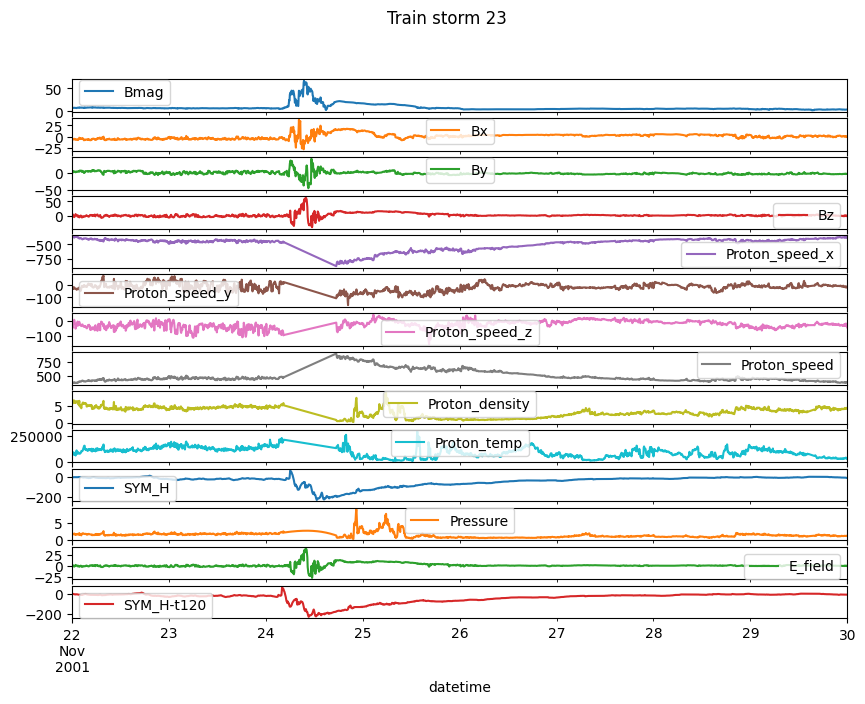

train storm 24


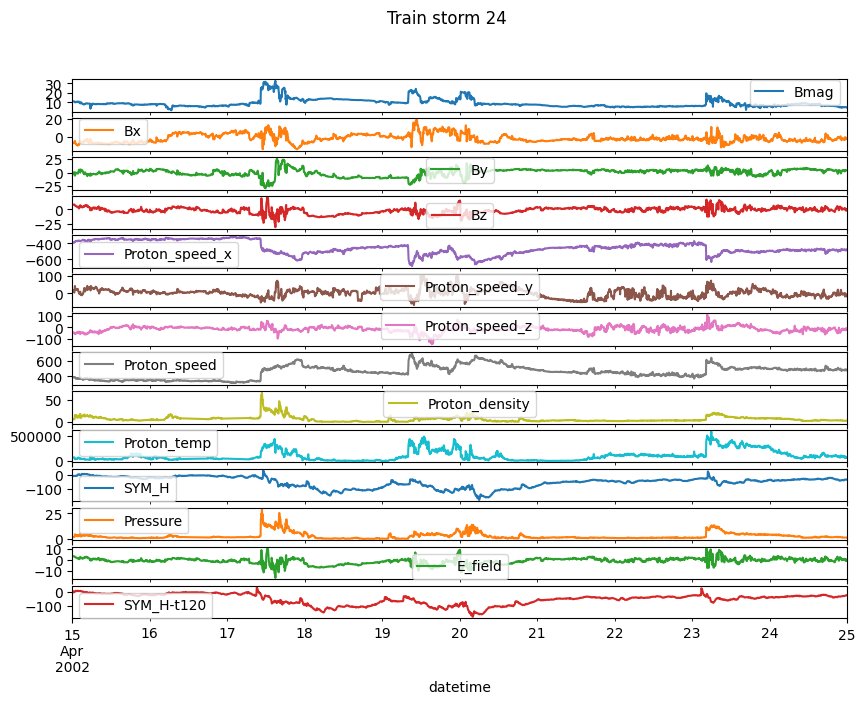

train storm 25


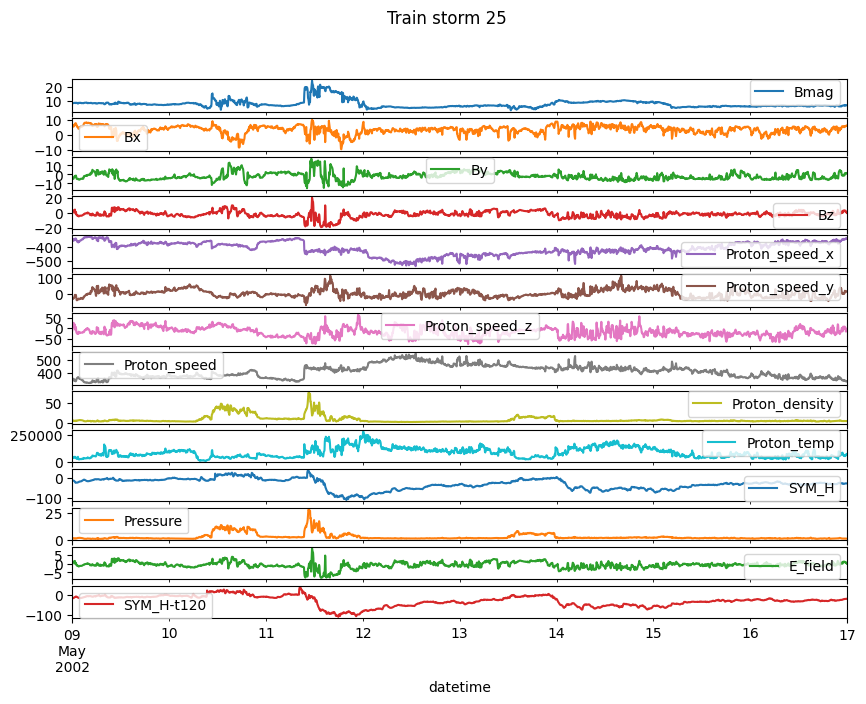

train storm 26


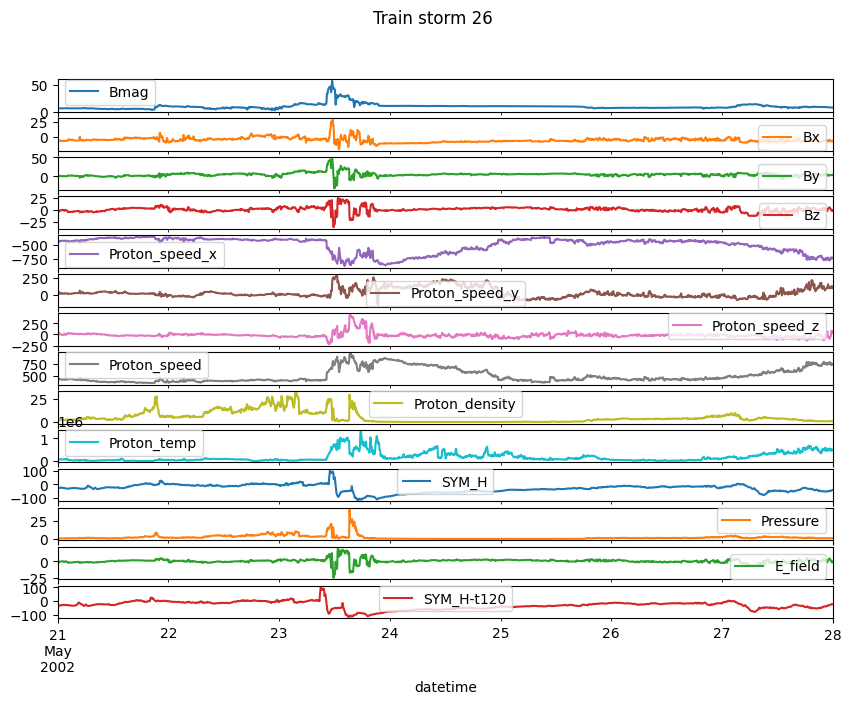

train storm 27


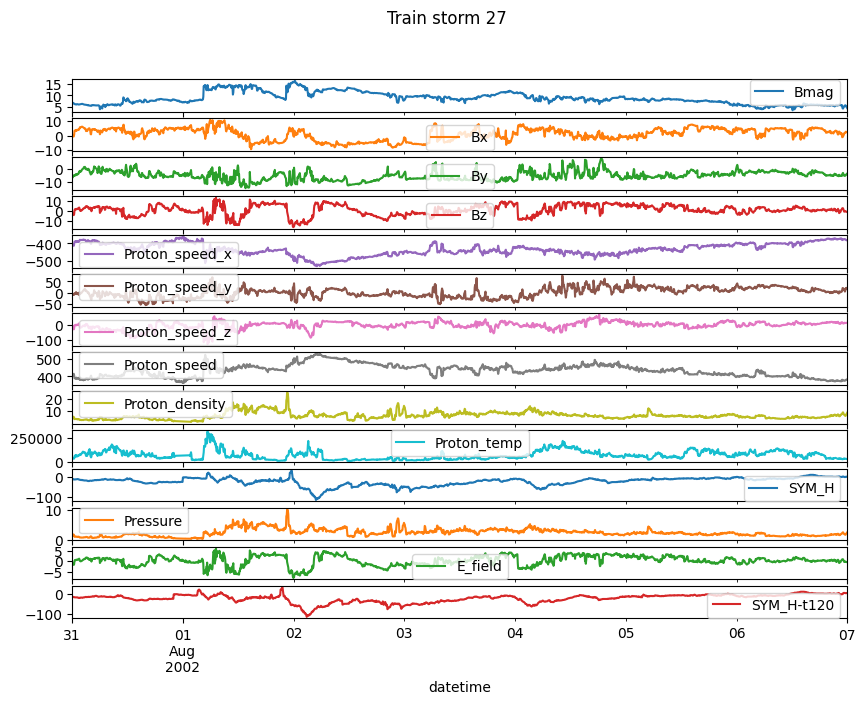

train storm 28


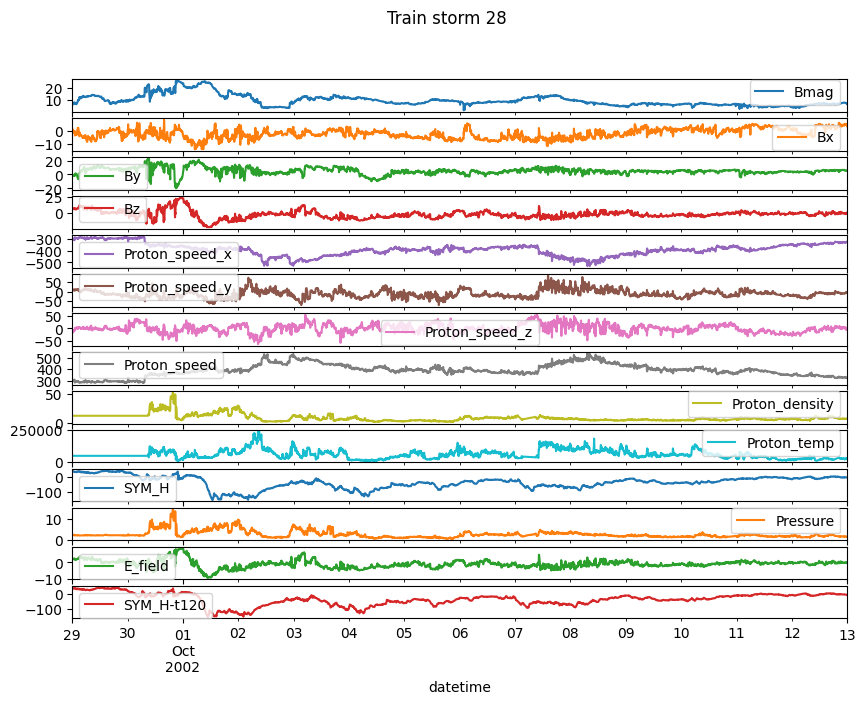

train storm 29


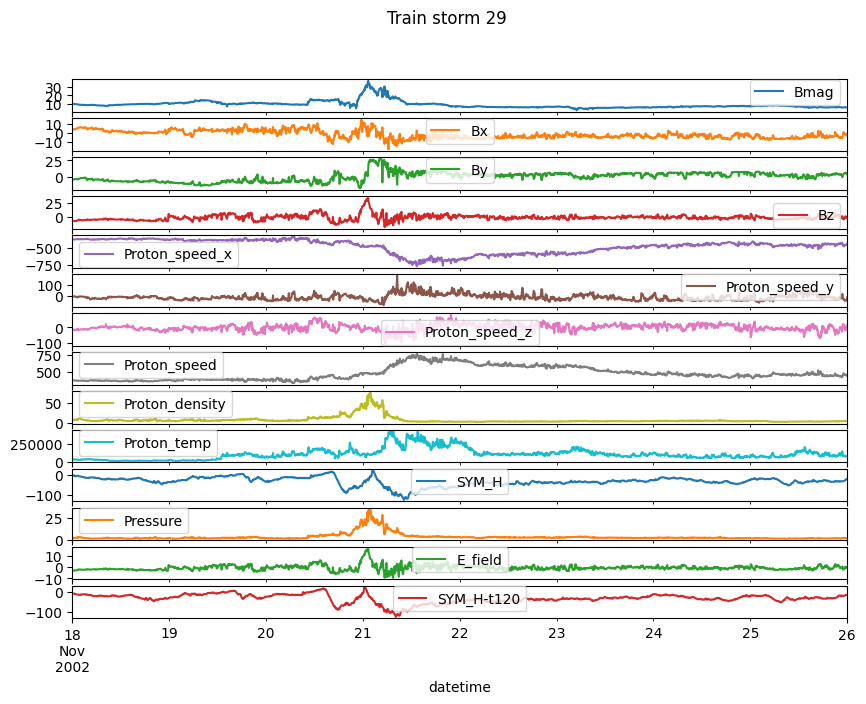

train storm 30


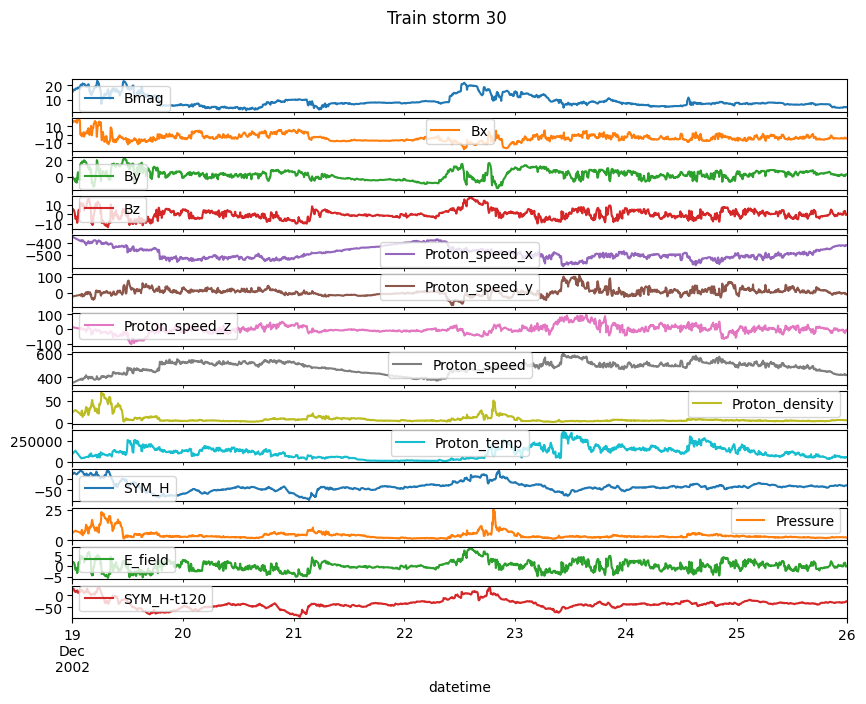

train storm 31


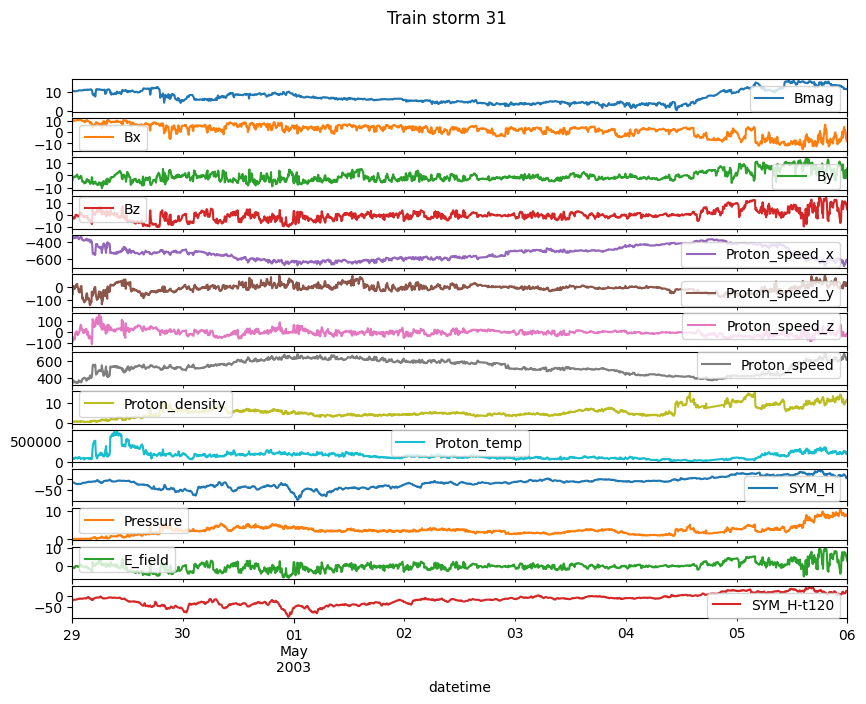

train storm 32


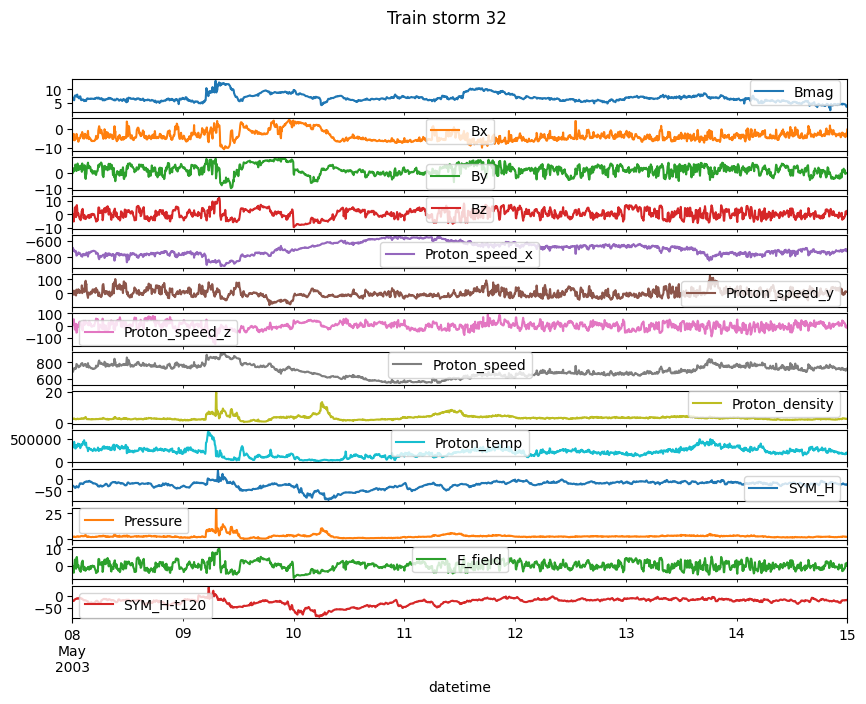

train storm 33


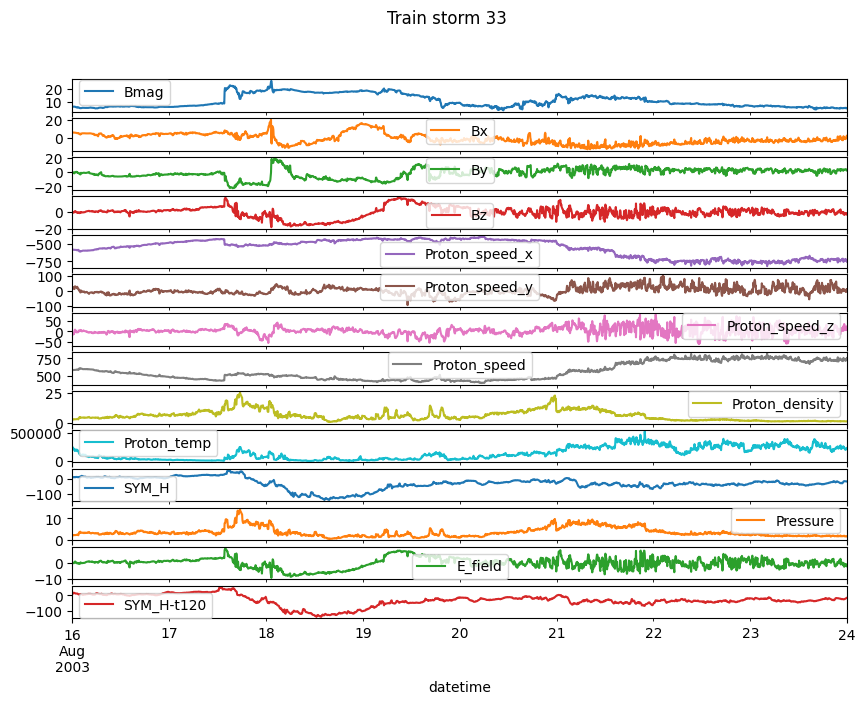

train storm 34


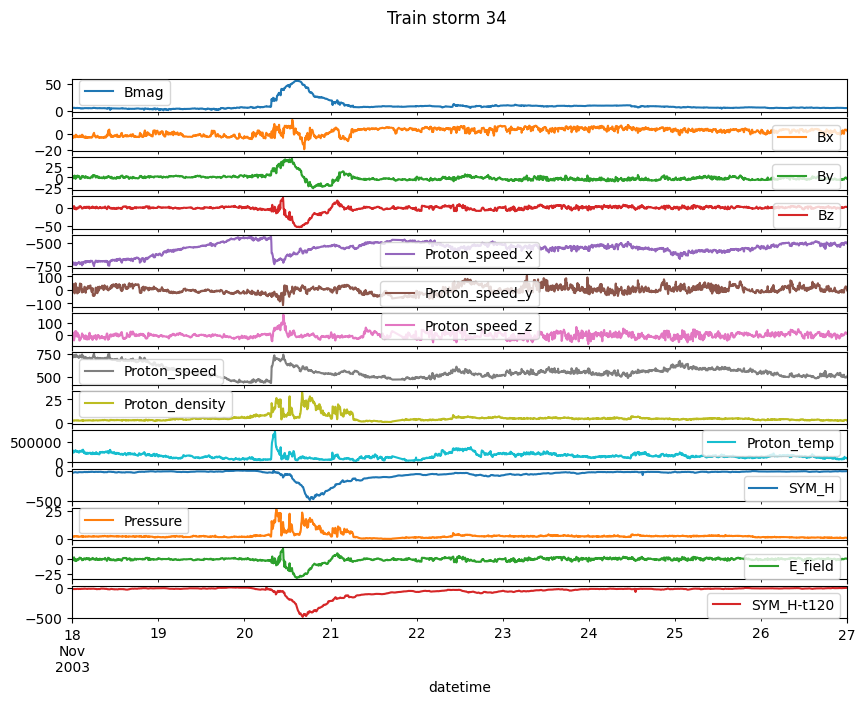

train storm 35


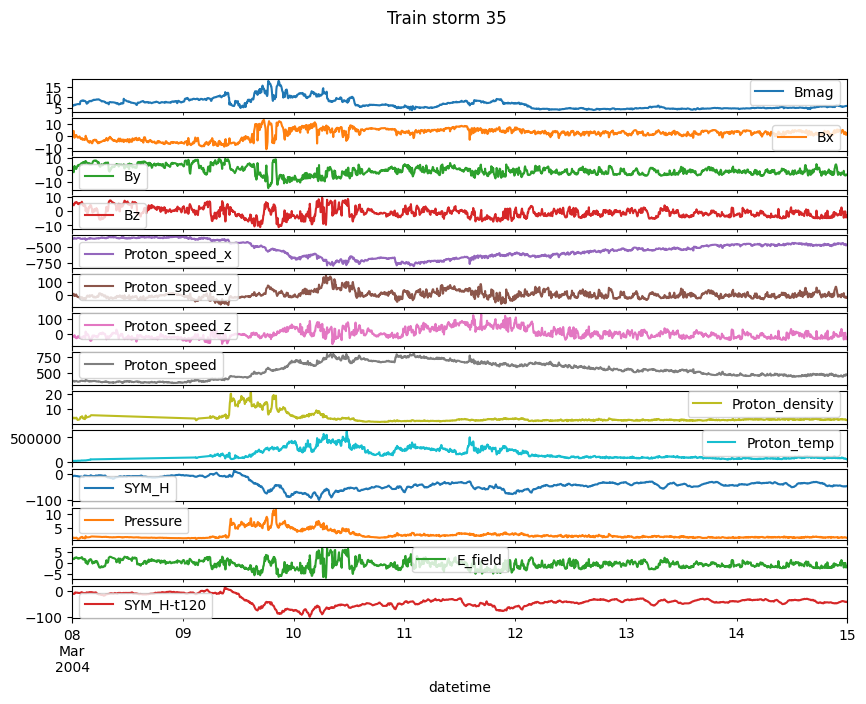

train storm 36


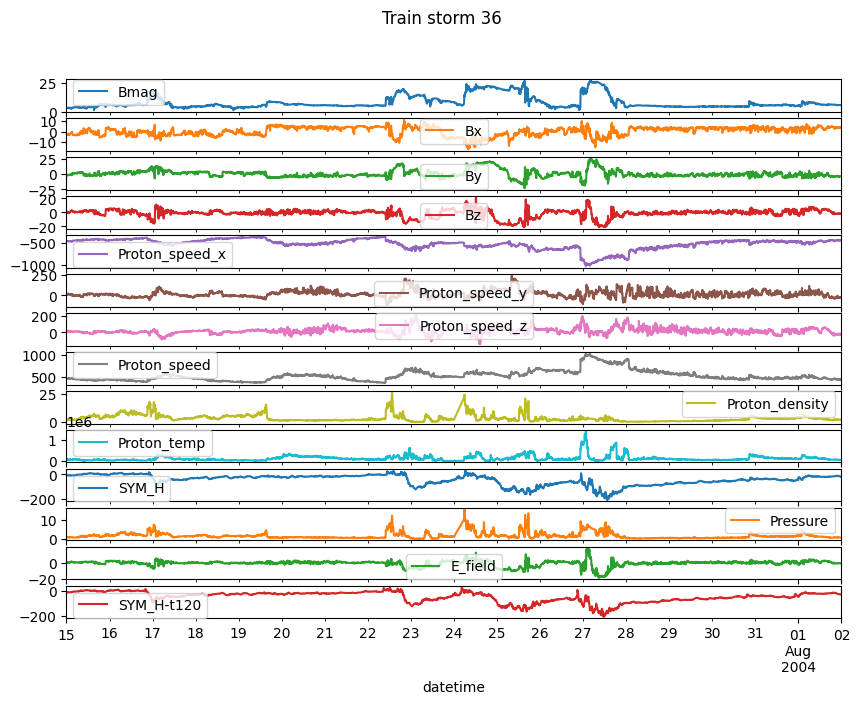

train storm 37


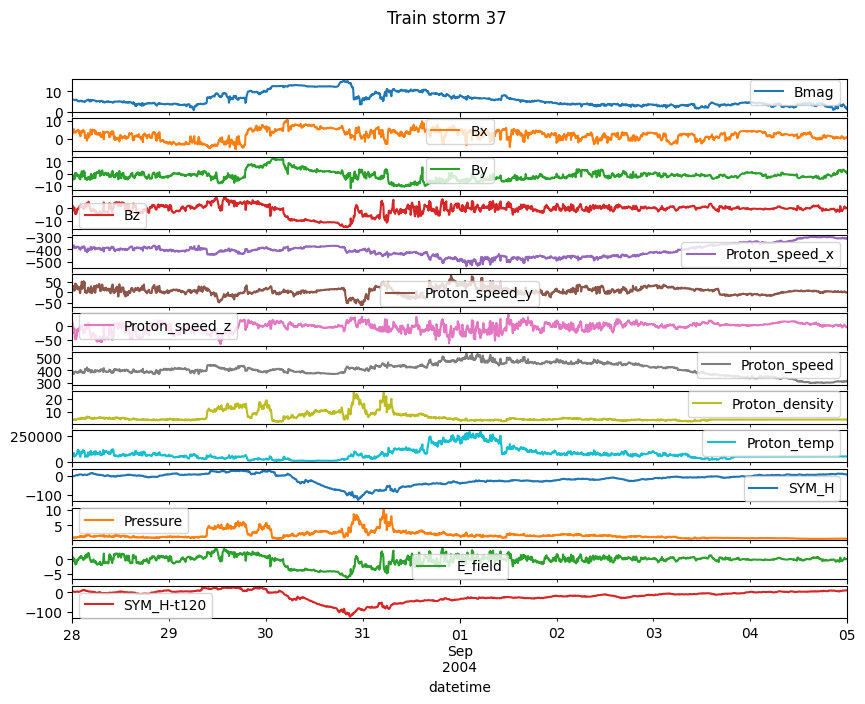

train storm 38


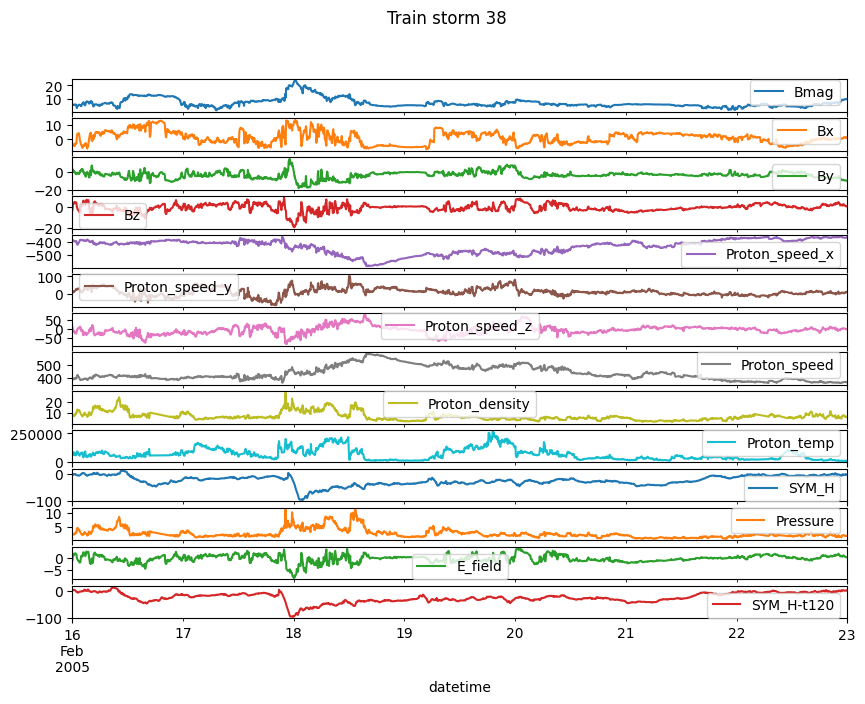

train storm 39


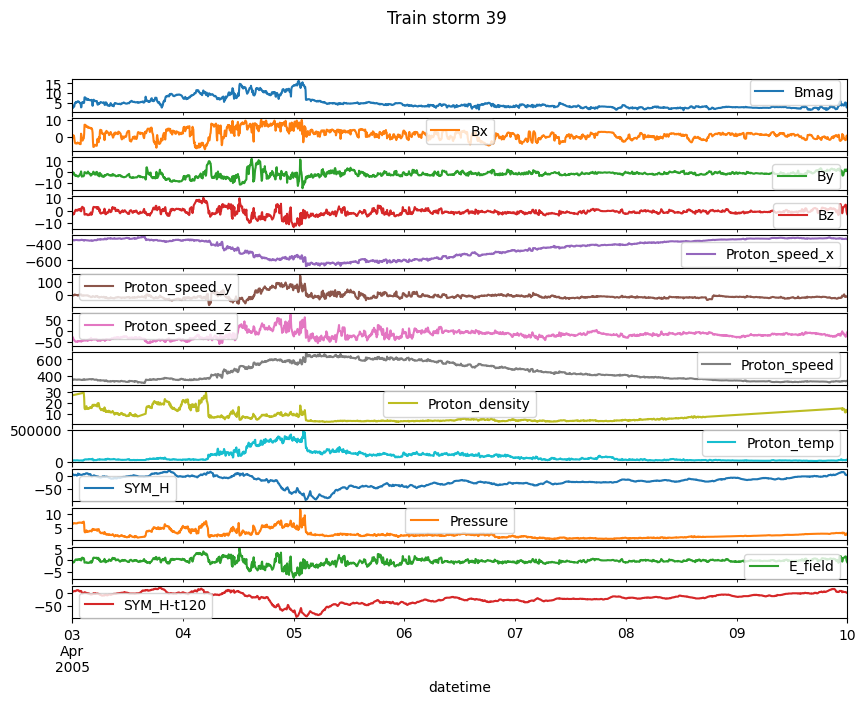

train storm 40


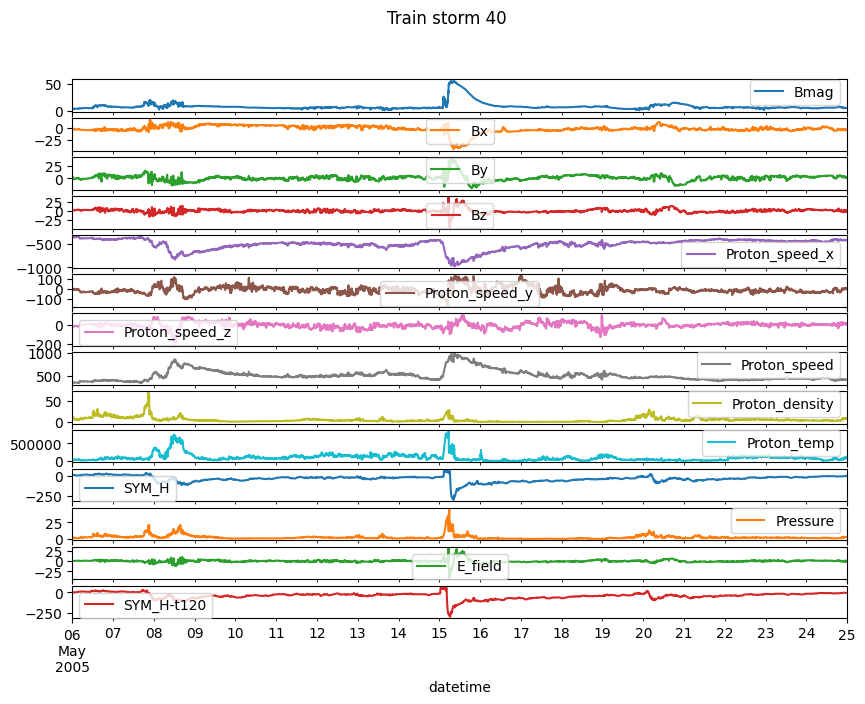

train storm 41


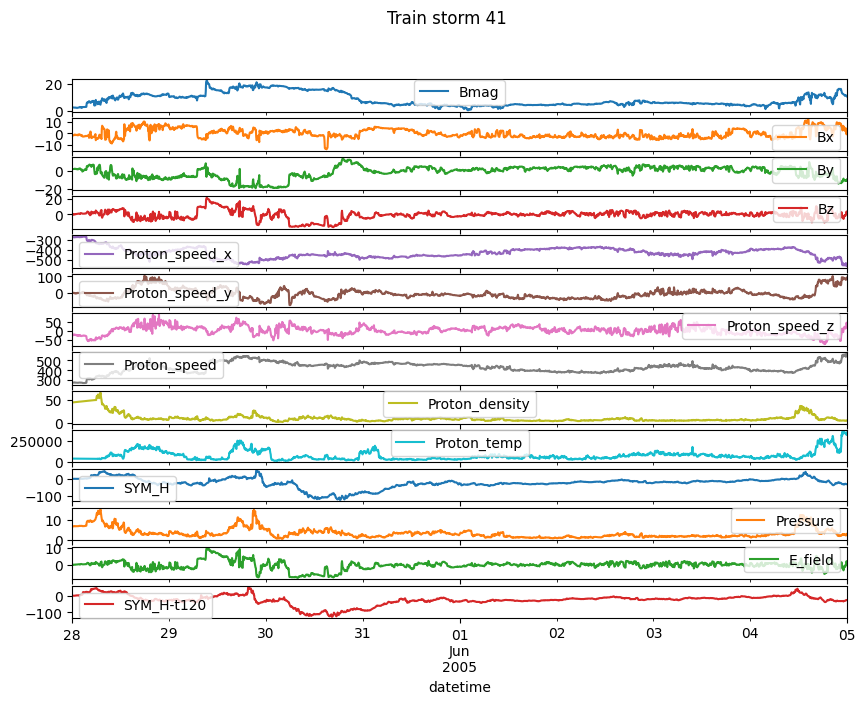

train storm 42


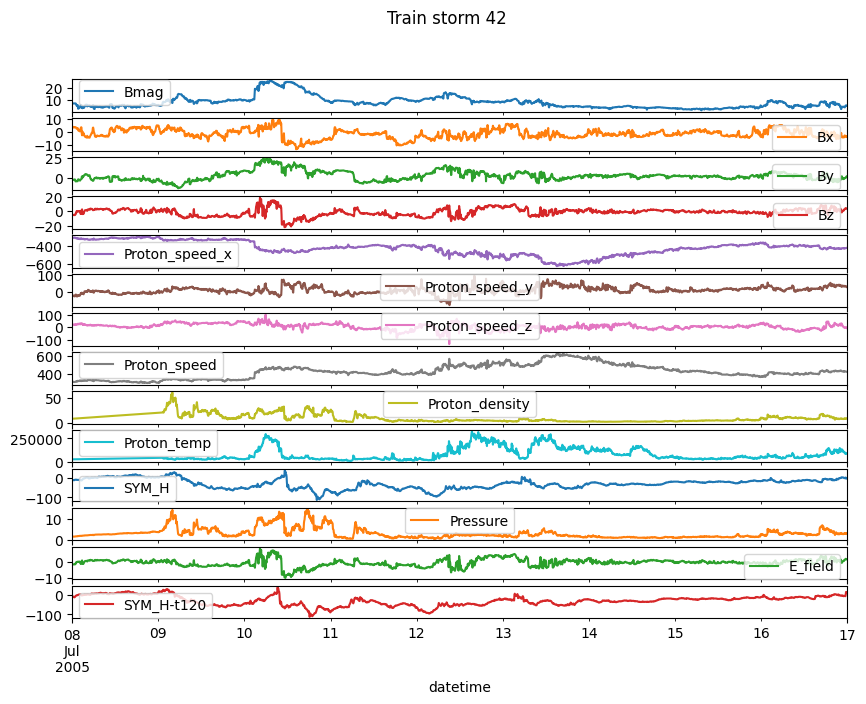

train storm 43


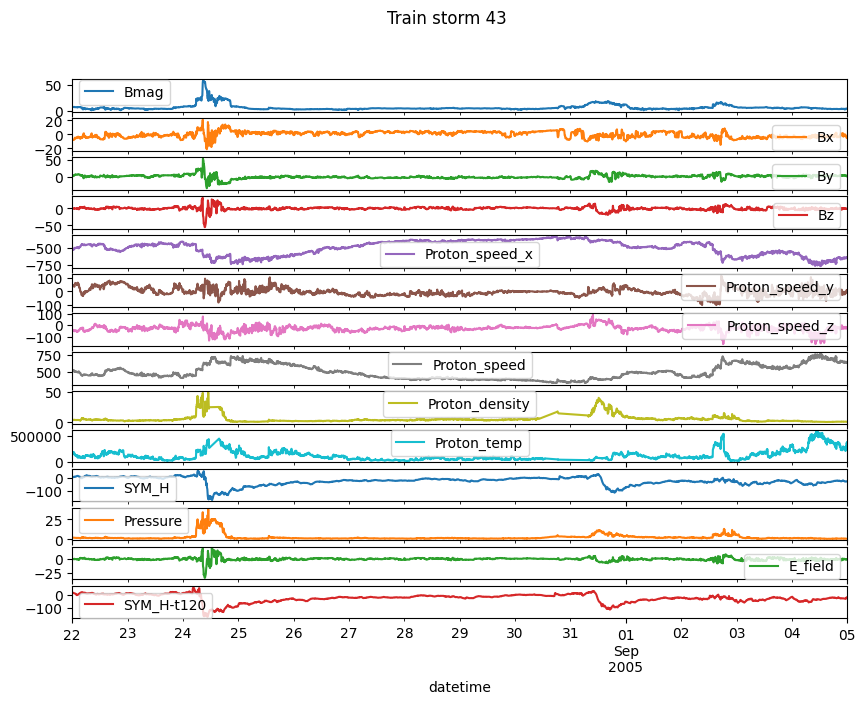

train storm 44


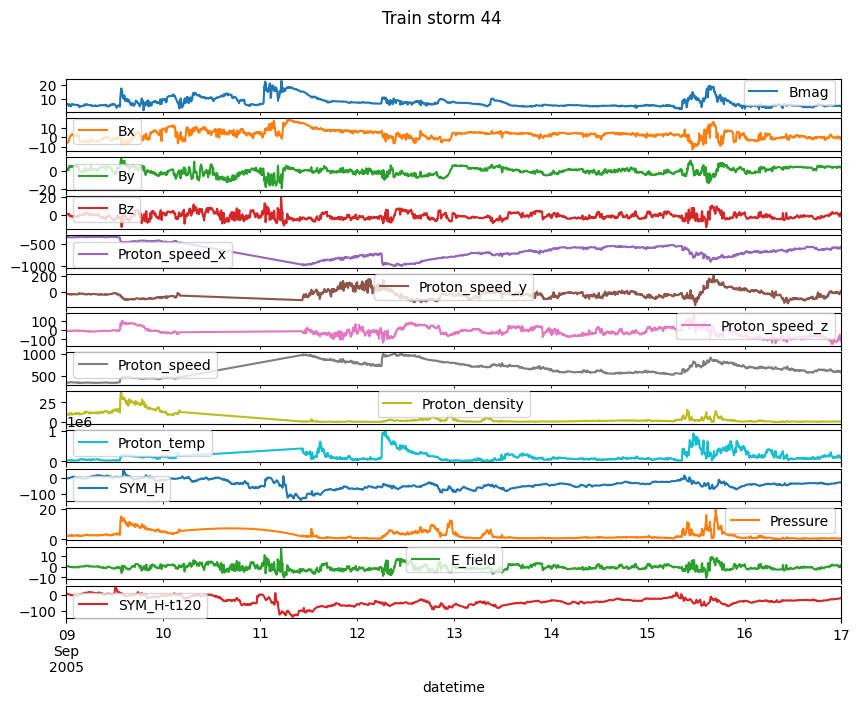

train storm 45


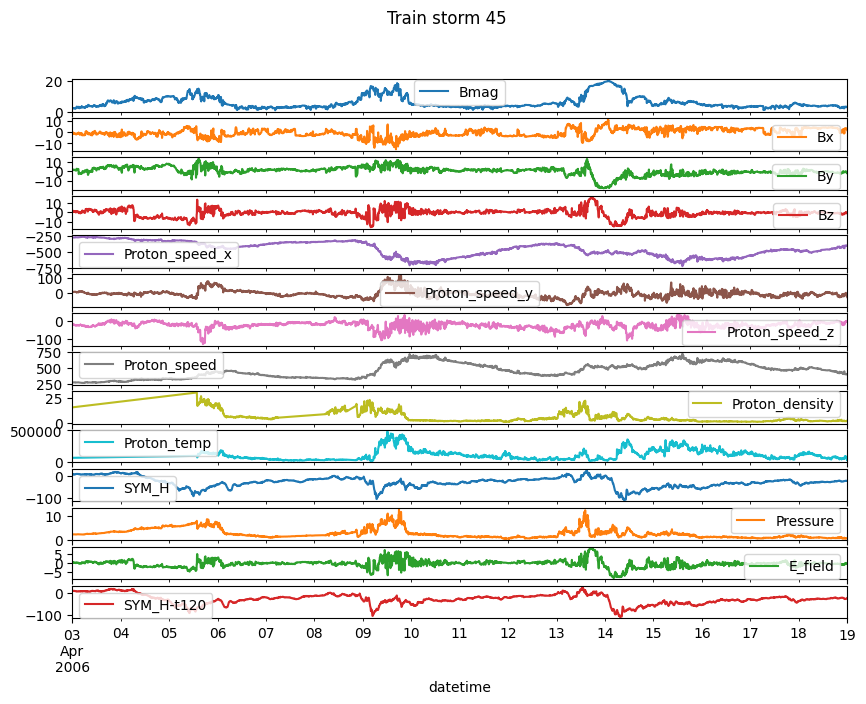

train storm 46


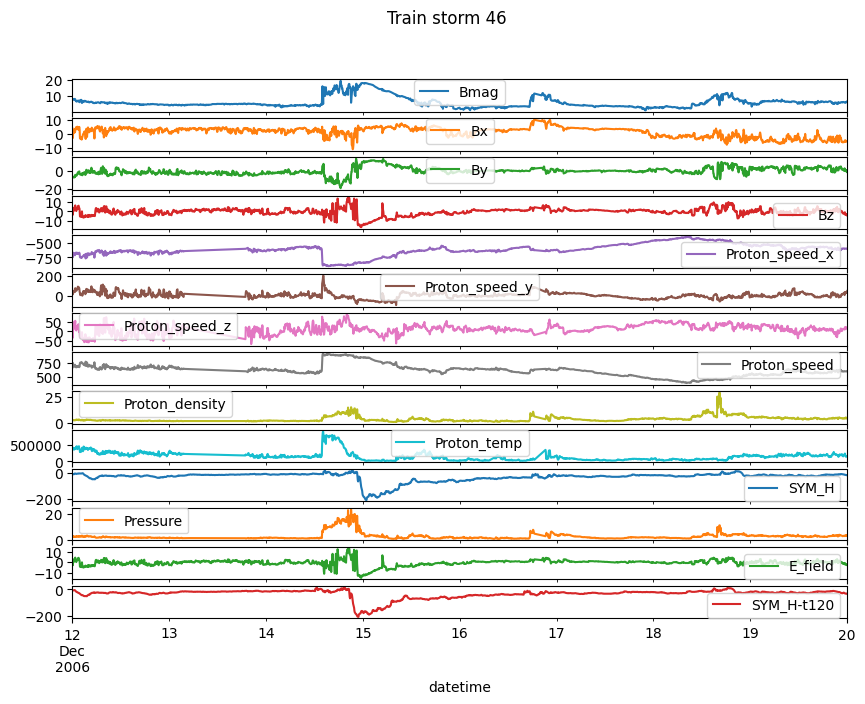

train storm 47


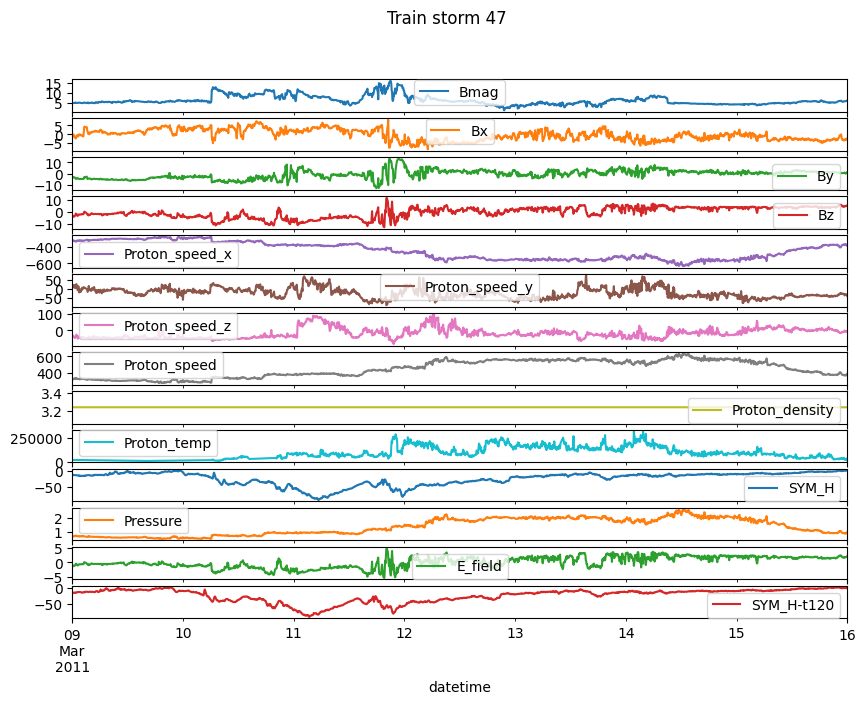

train storm 48


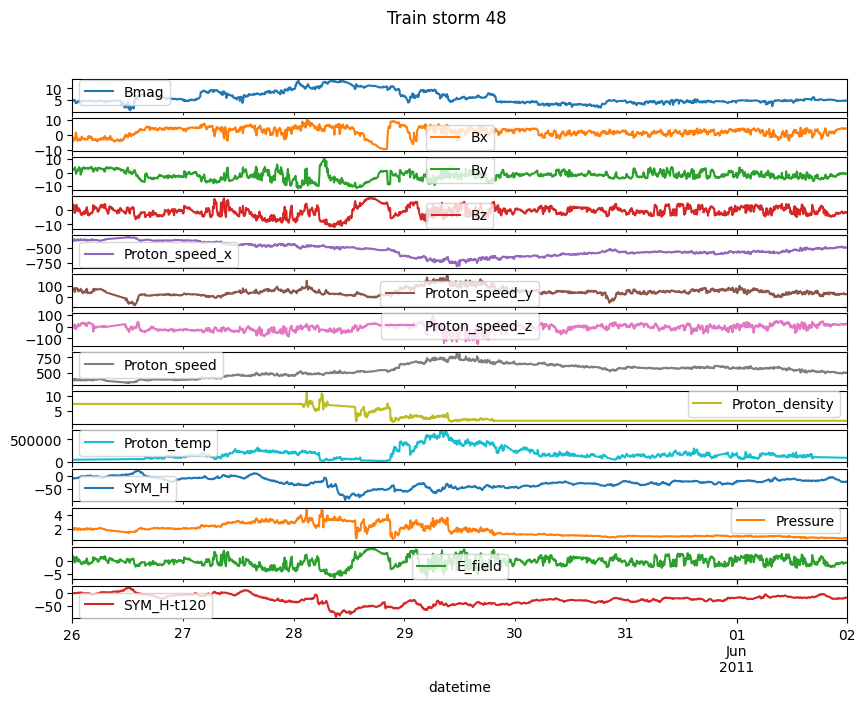

train storm 49


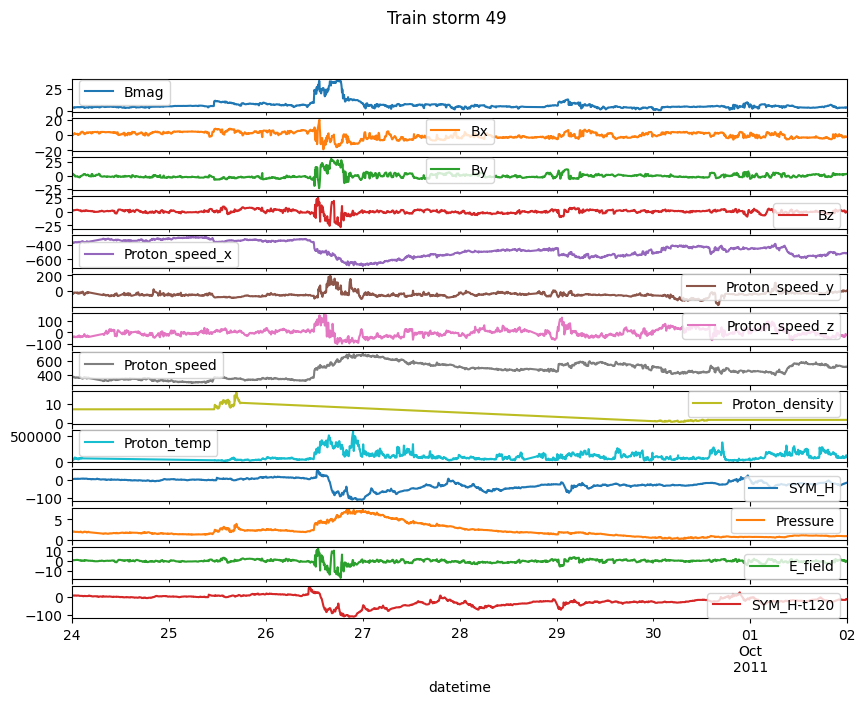

train storm 50


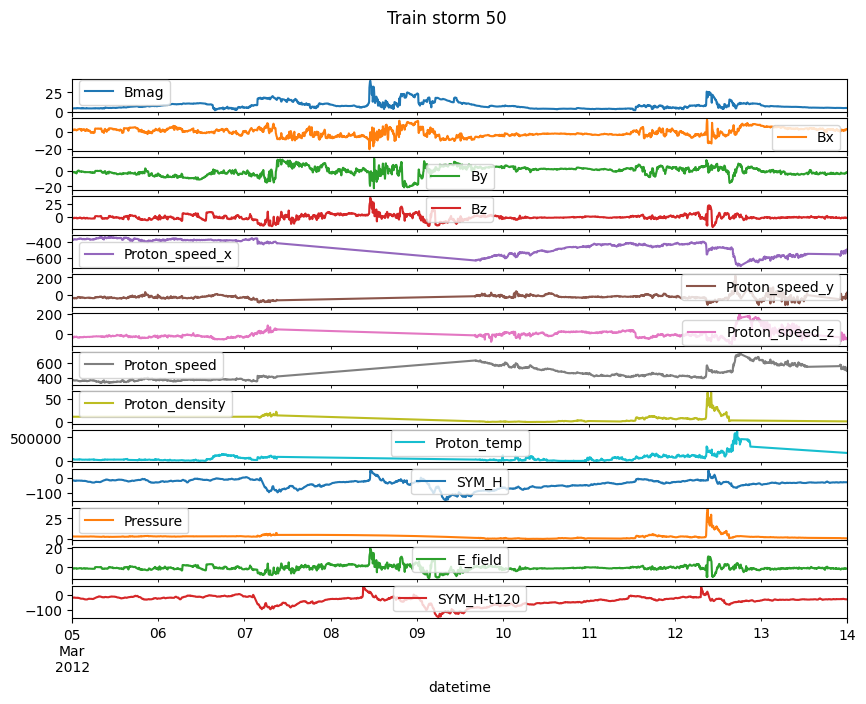

train storm 51


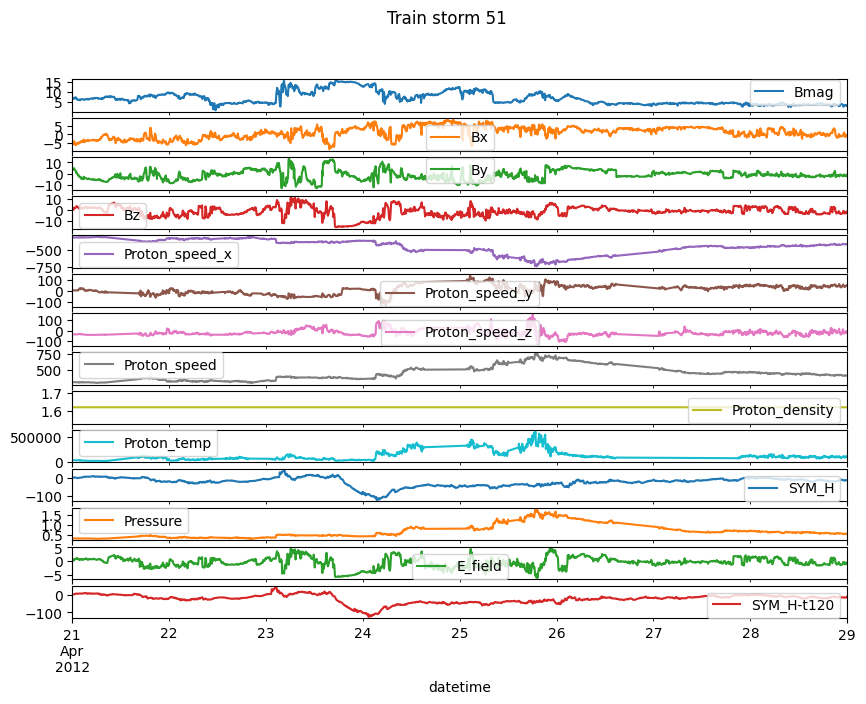

train storm 52


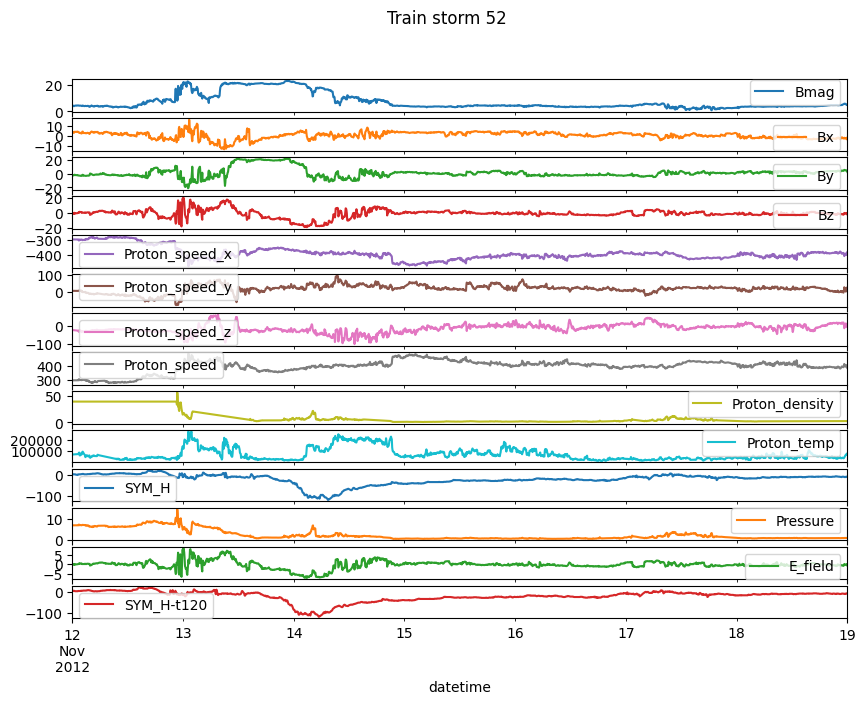

train storm 53


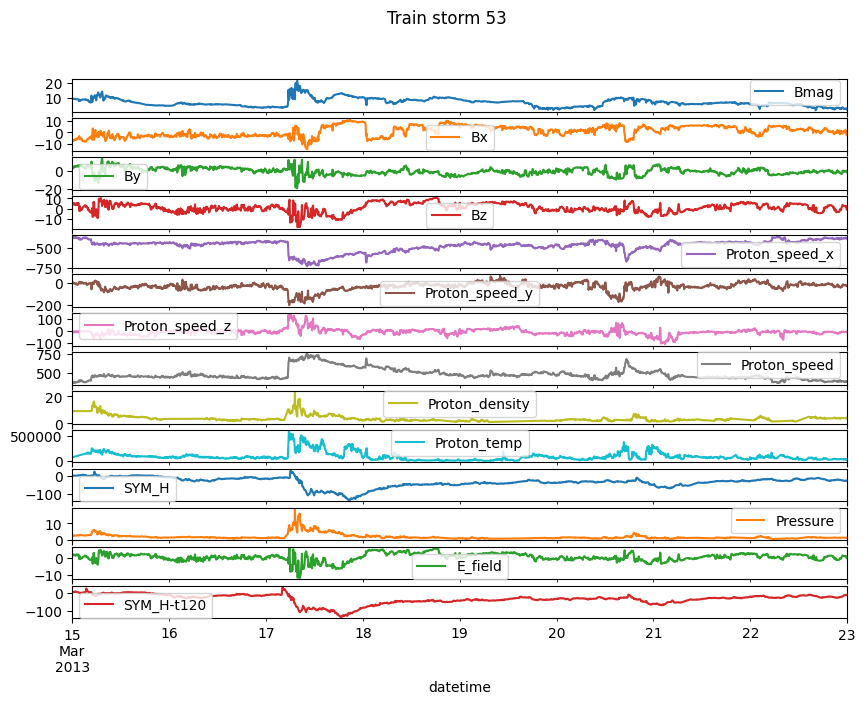

train storm 54


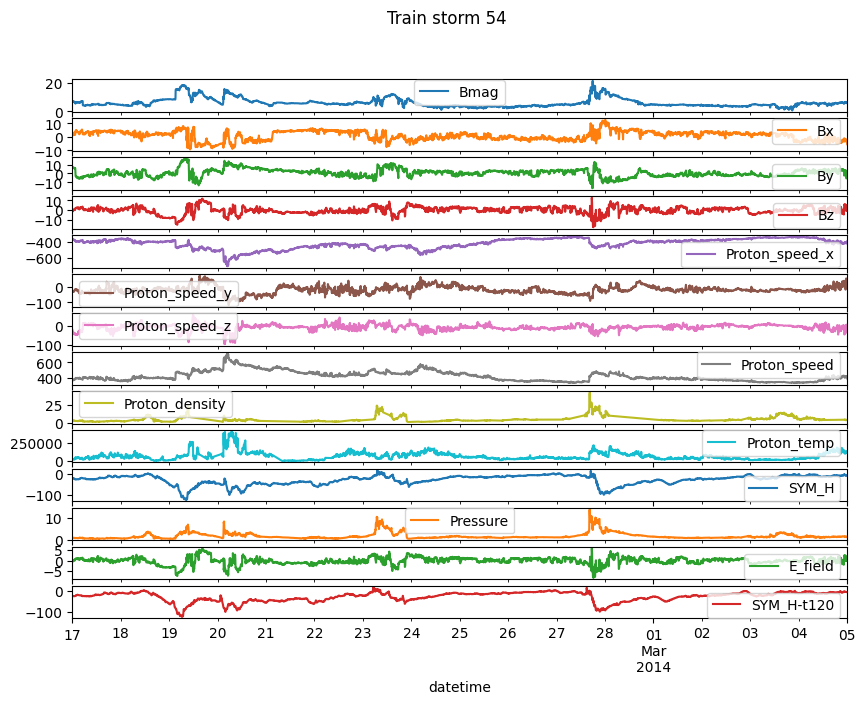

train storm 55


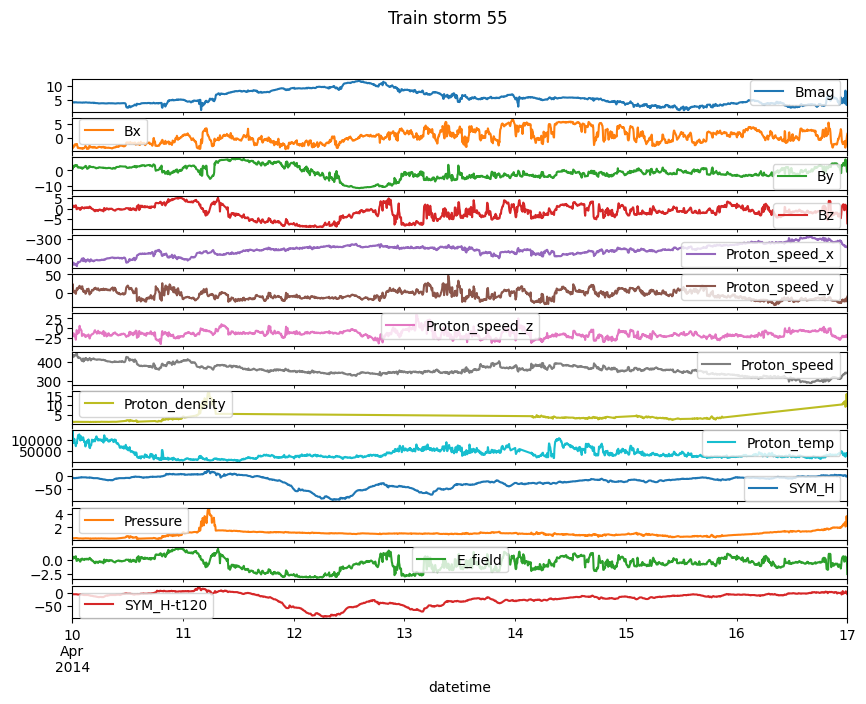

train storm 56


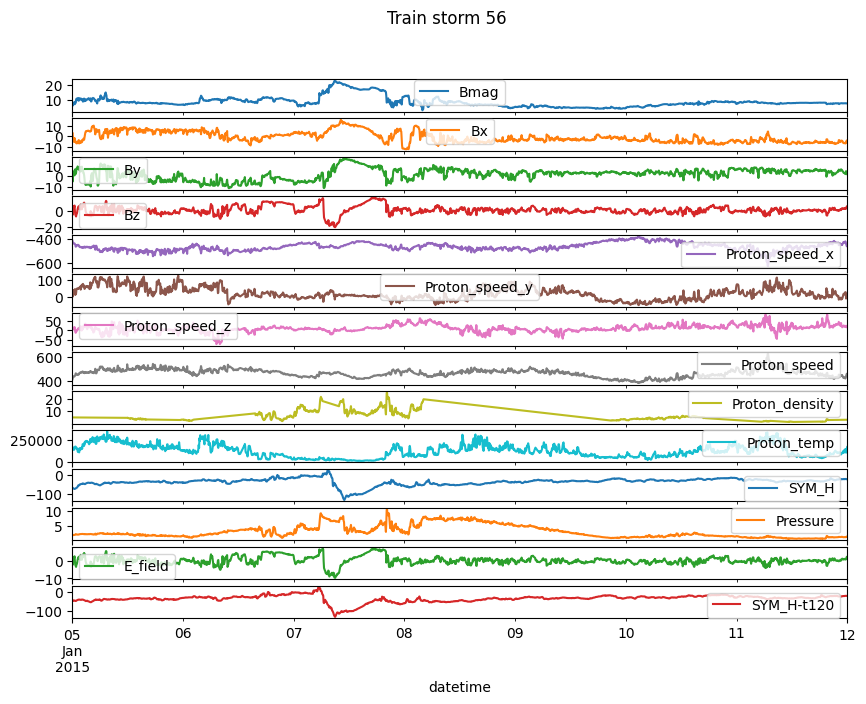

train storm 57


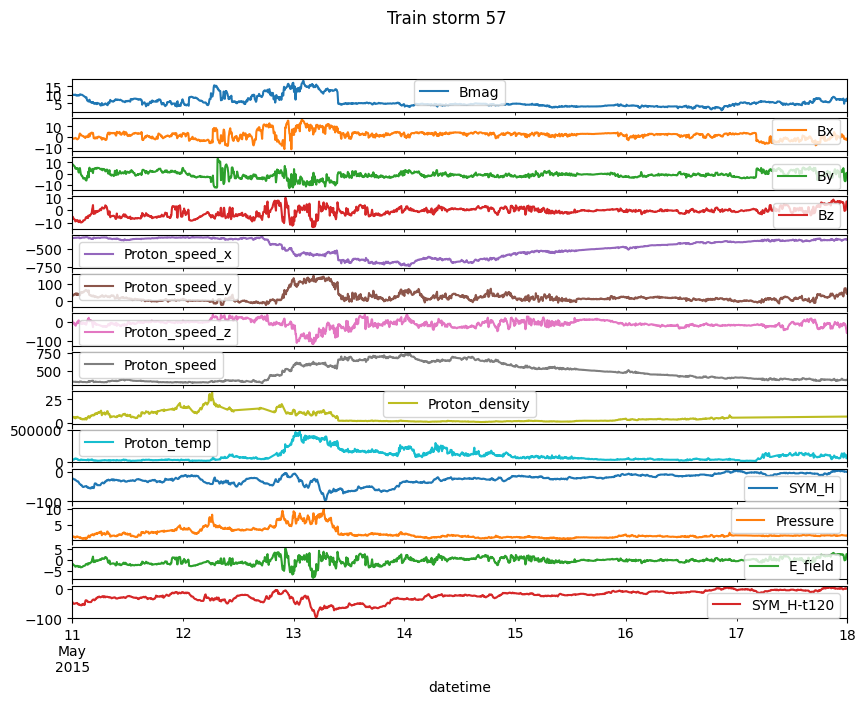

train storm 58


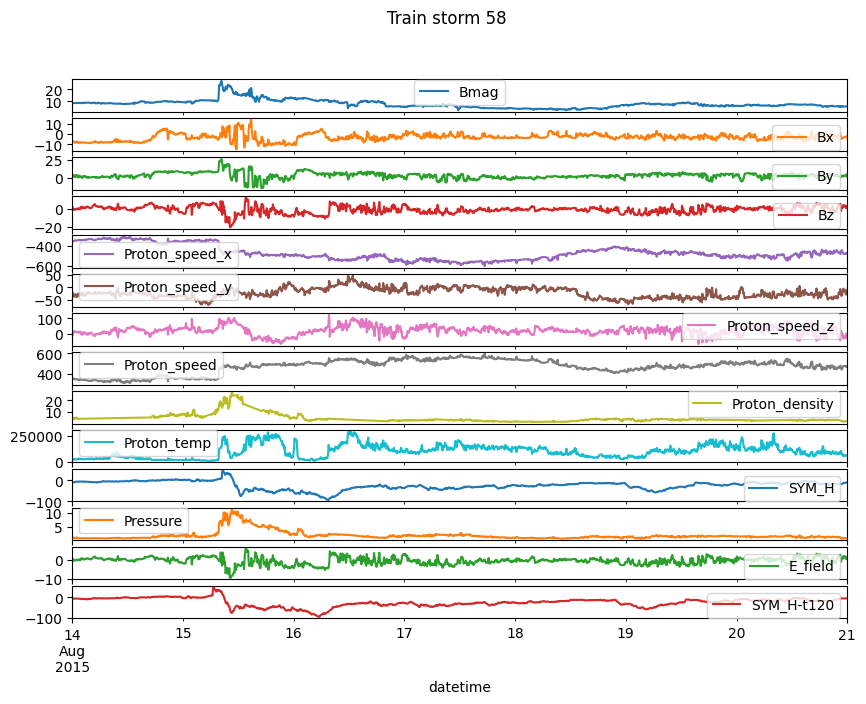

train storm 59


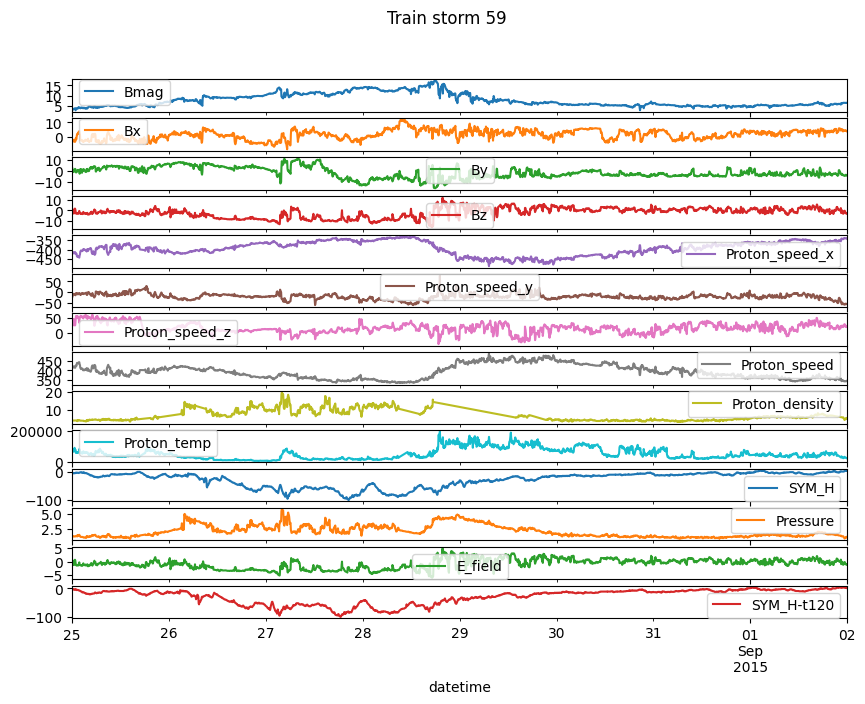

train storm 60


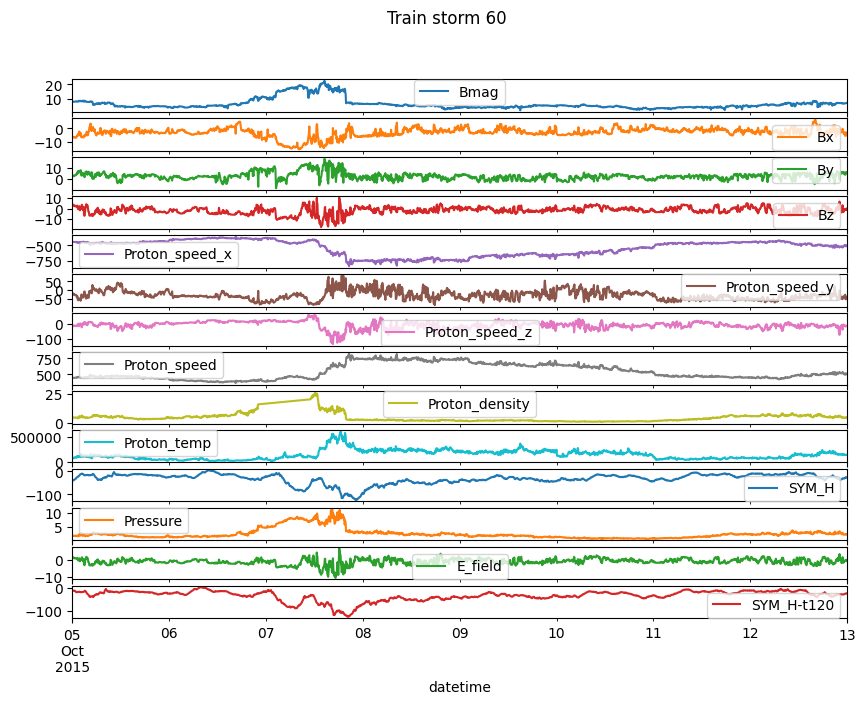

train storm 61


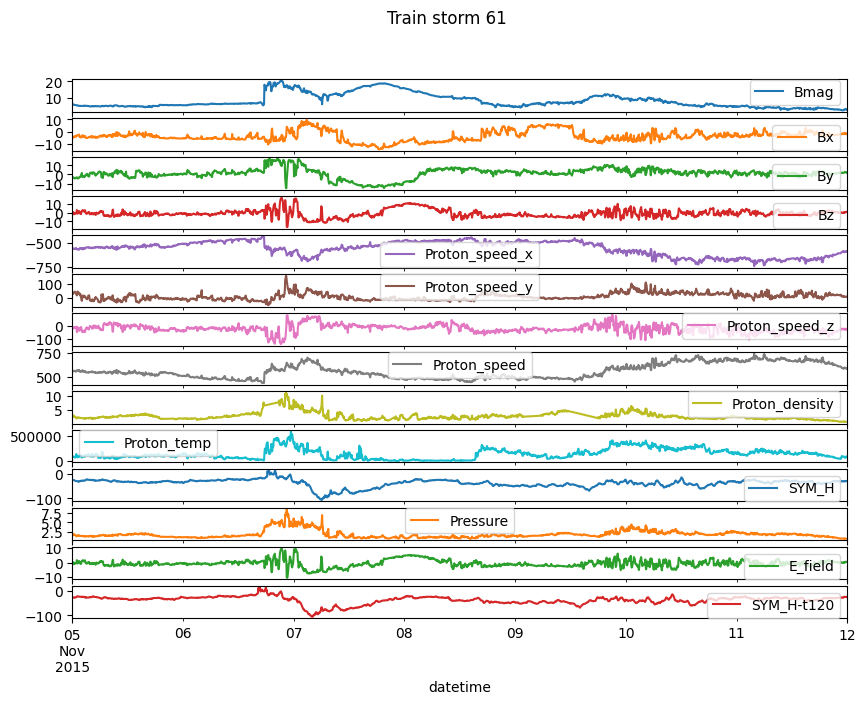

train storm 62


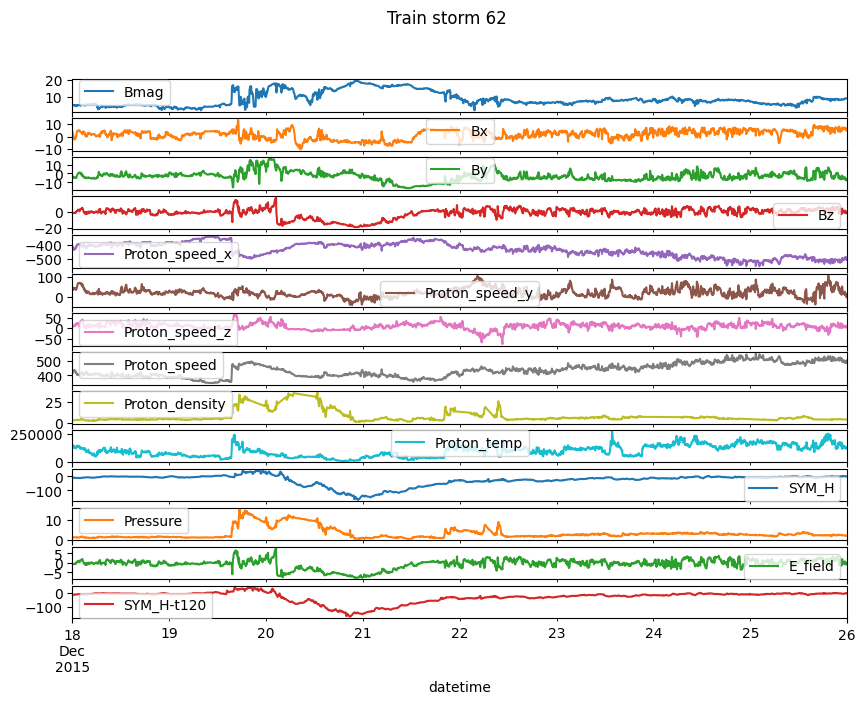

train storm 63


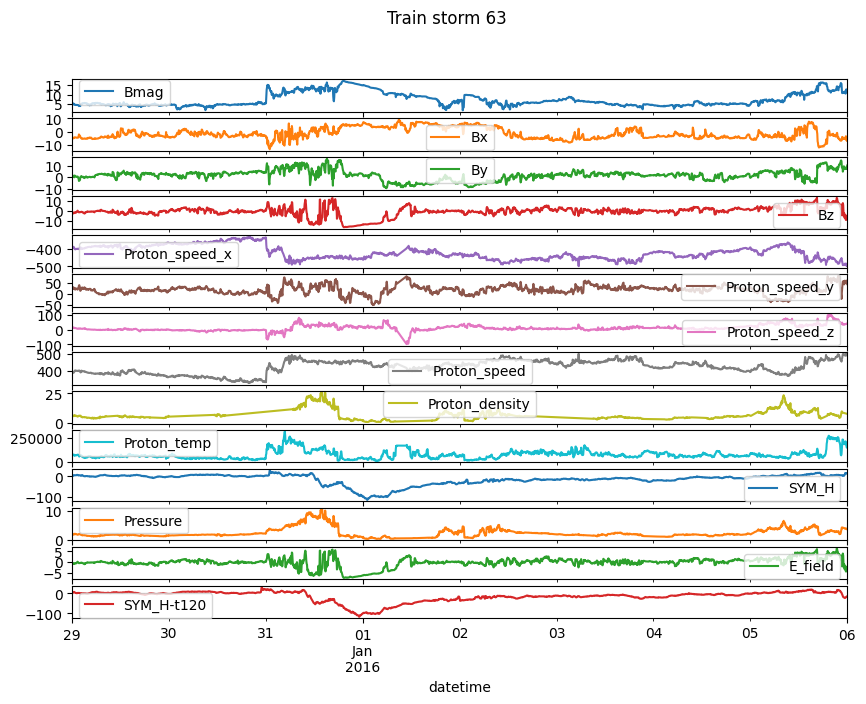

train storm 64


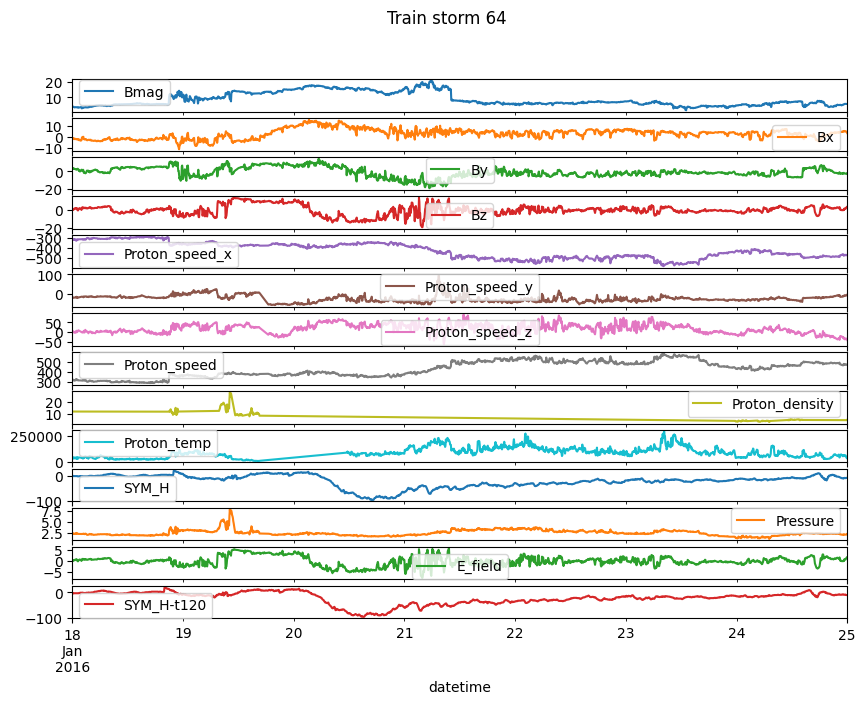

train storm 65


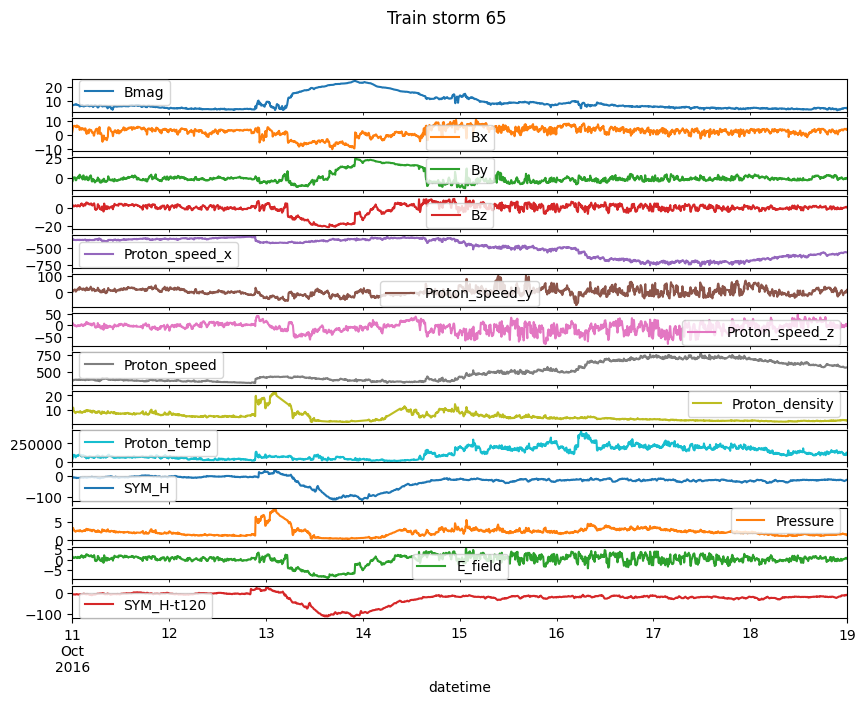

In [7]:
if plot_graphs:
    global_index_storm = 1
    for storm in train_storms:
        print('train storm', global_index_storm)
        storm.plot(subplots=True, title=f'Train storm {global_index_storm}', figsize = (10, 7))
        global_index_storm += 1
        plt.show();

val storm 66


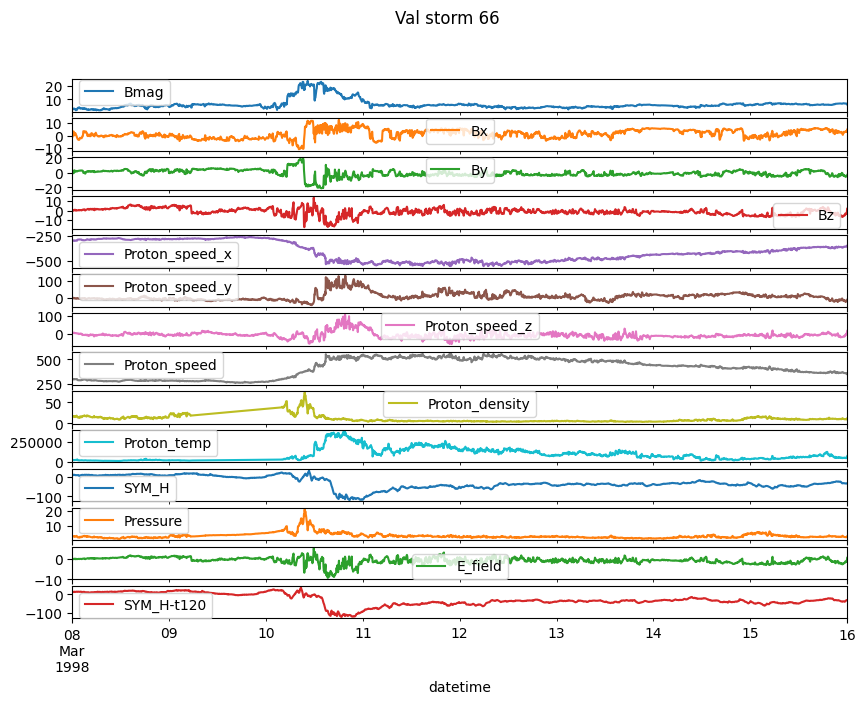

val storm 67


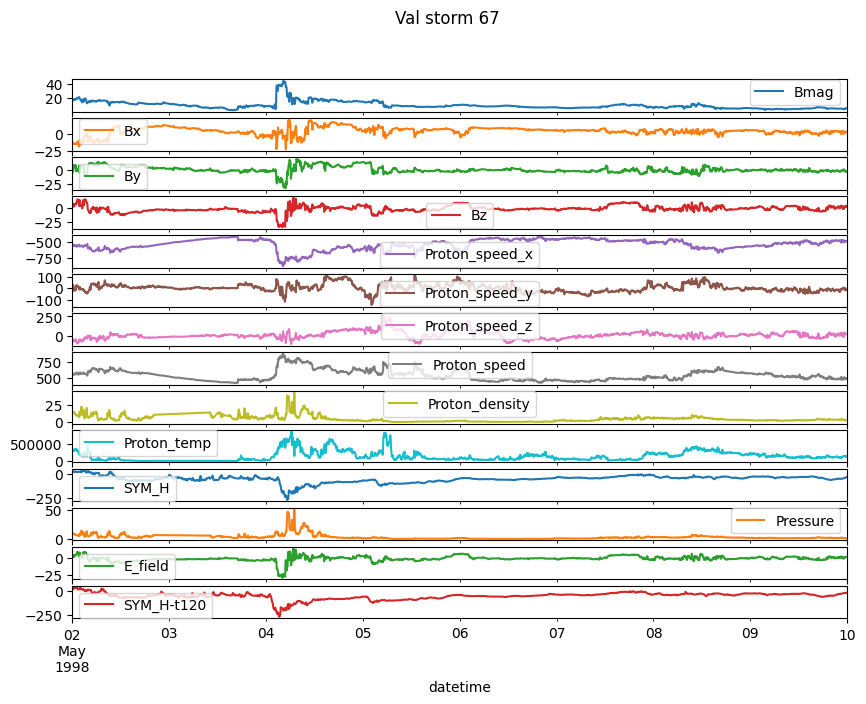

val storm 68


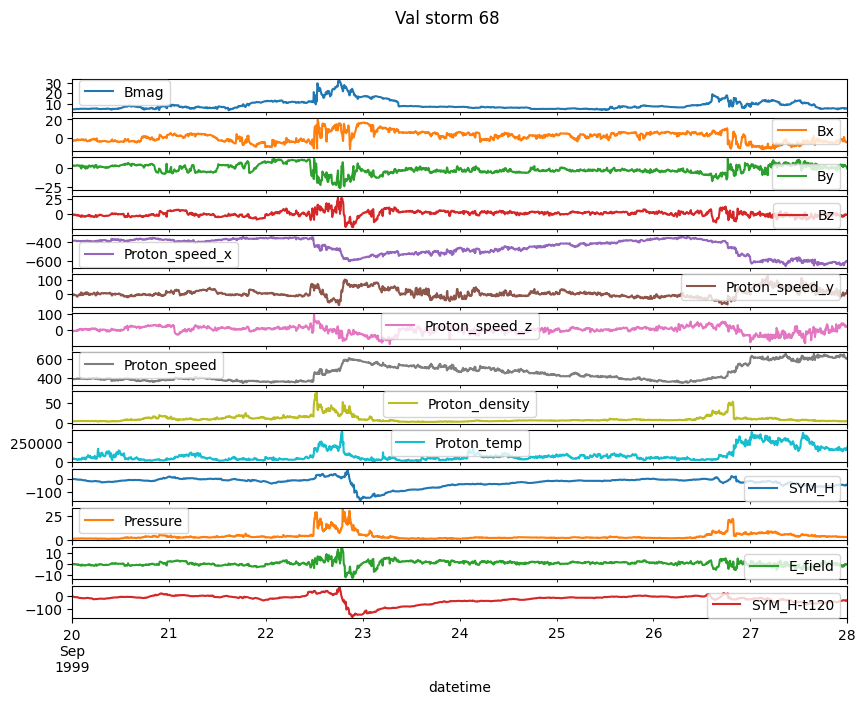

val storm 69


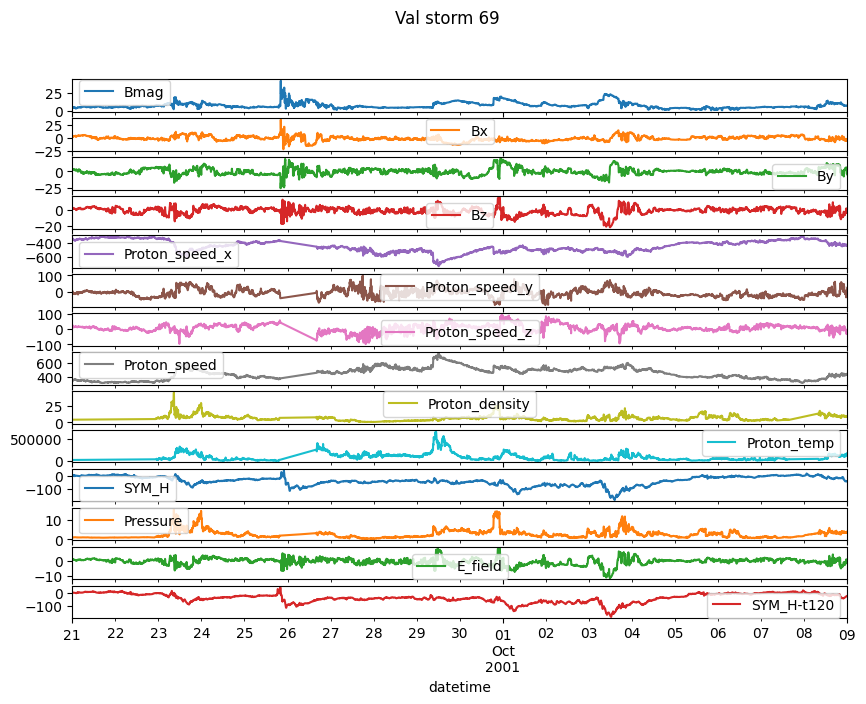

val storm 70


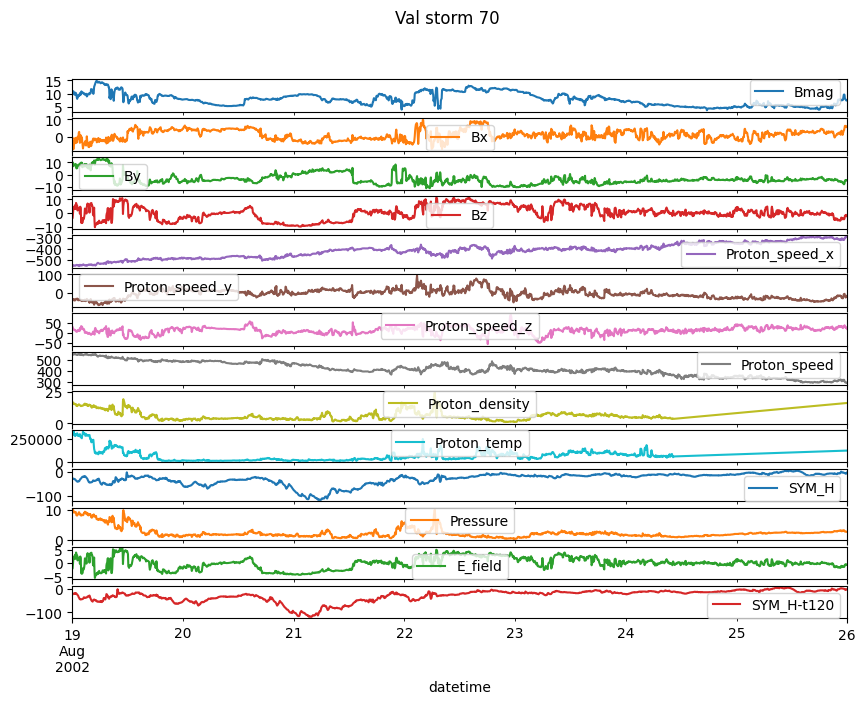

val storm 71


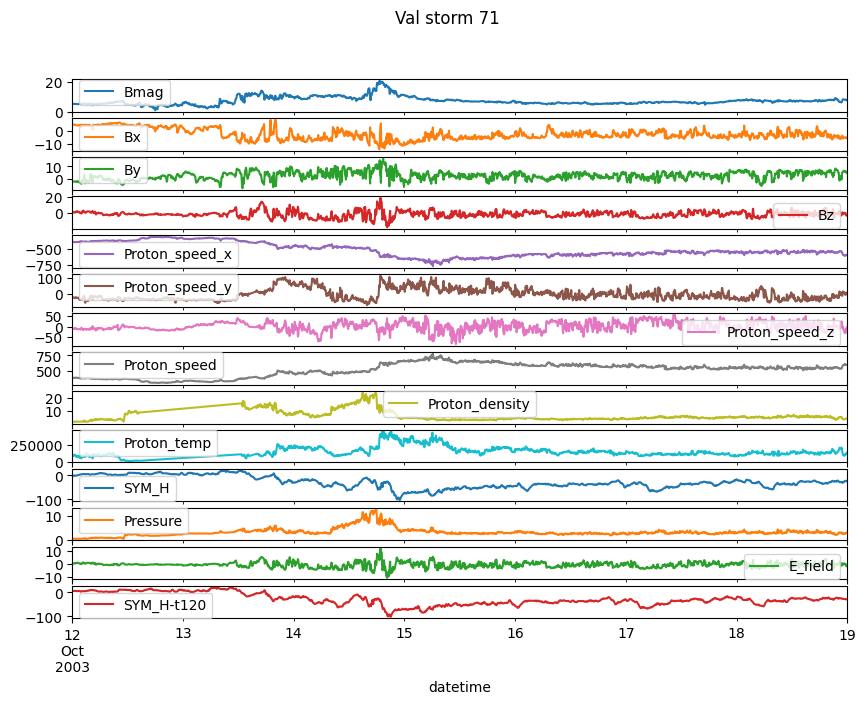

val storm 72


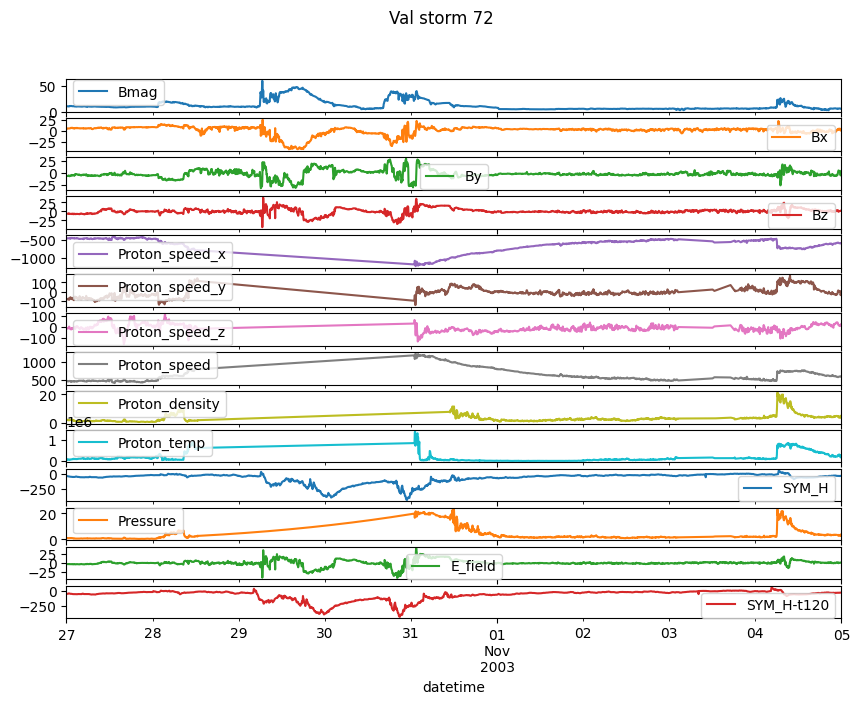

val storm 73


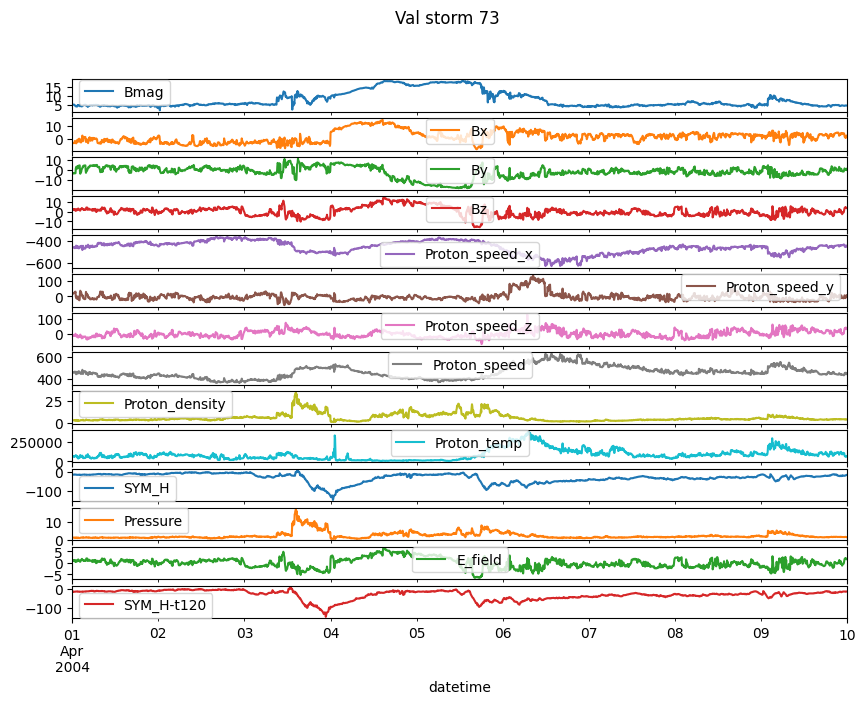

val storm 74


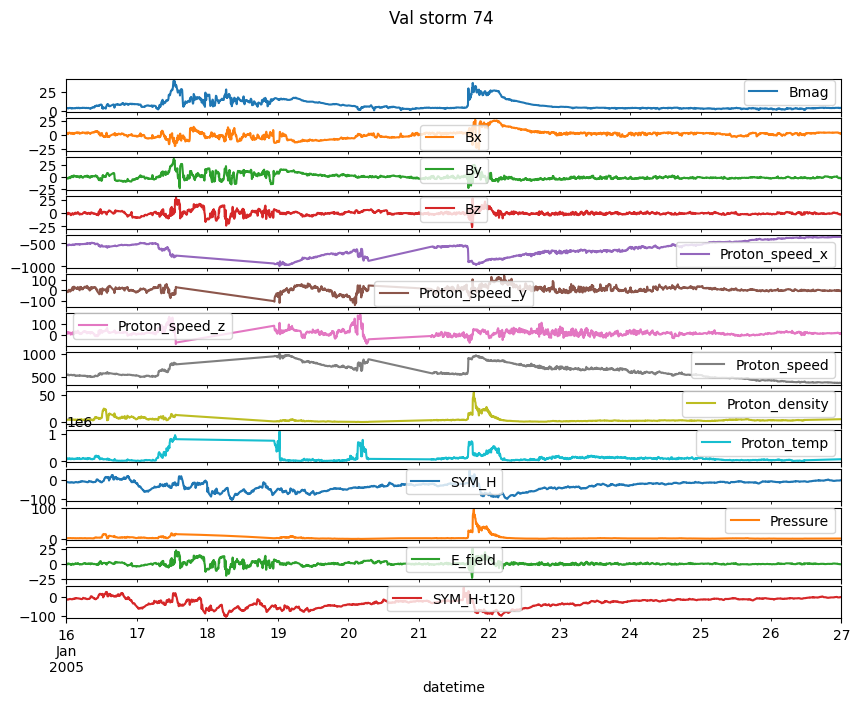

val storm 75


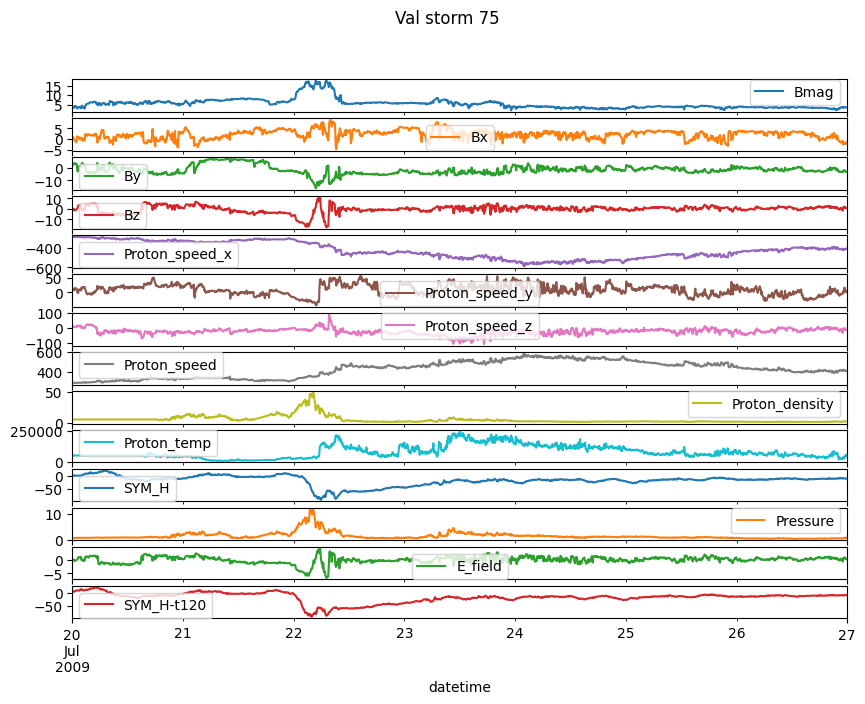

val storm 76


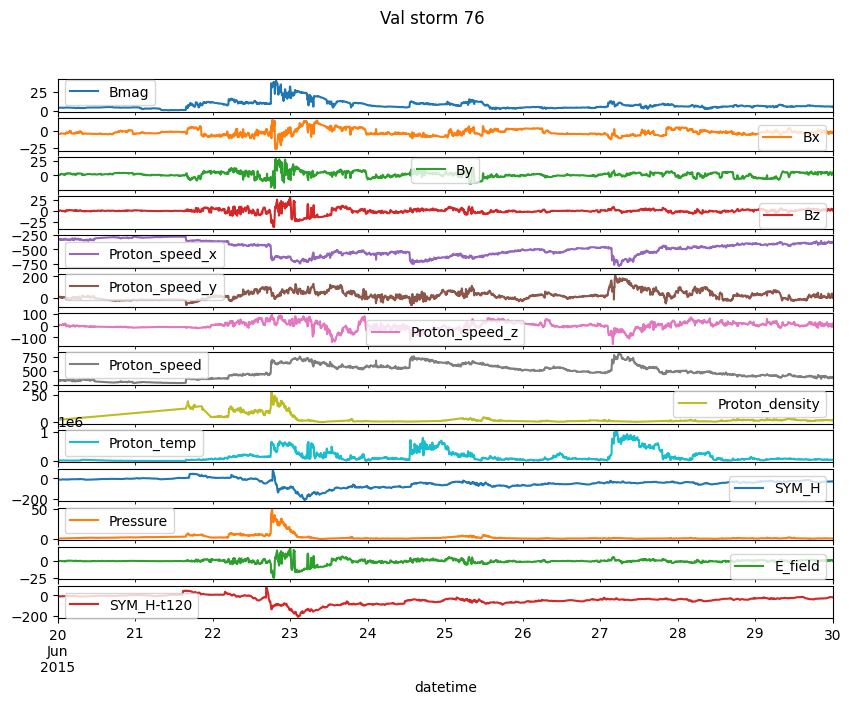

val storm 77


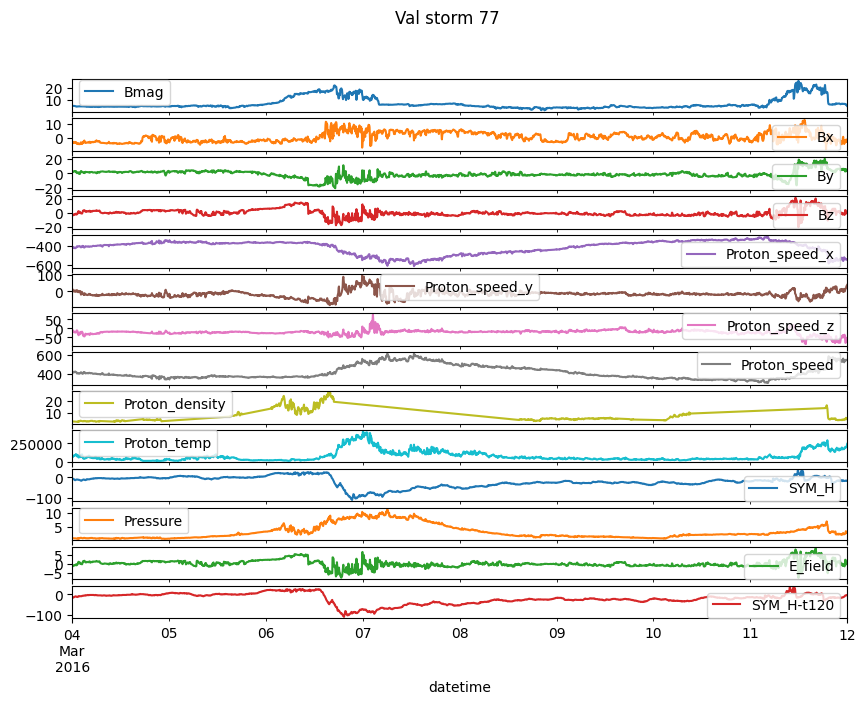

val storm 78


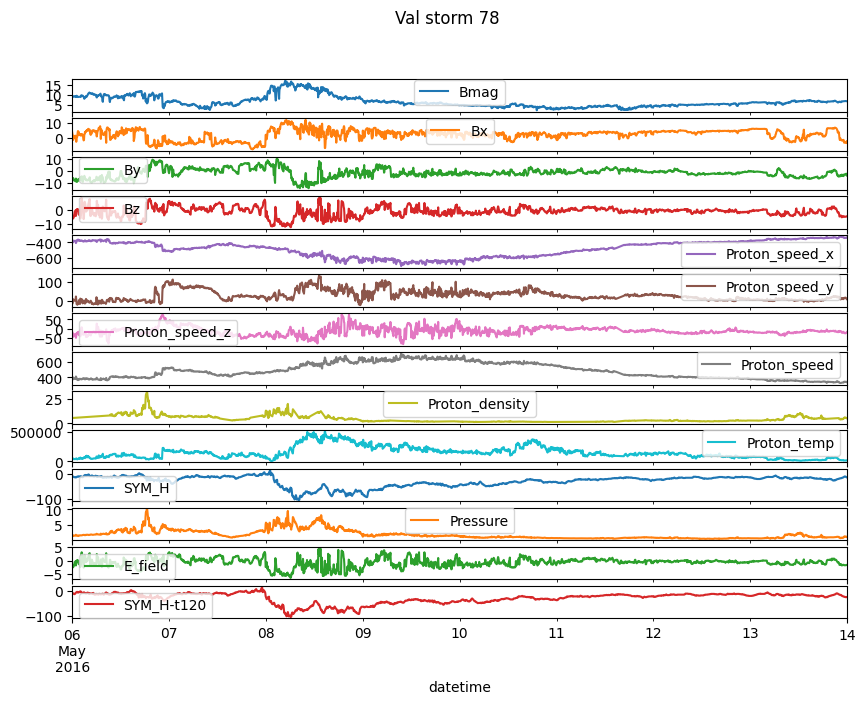

val storm 79


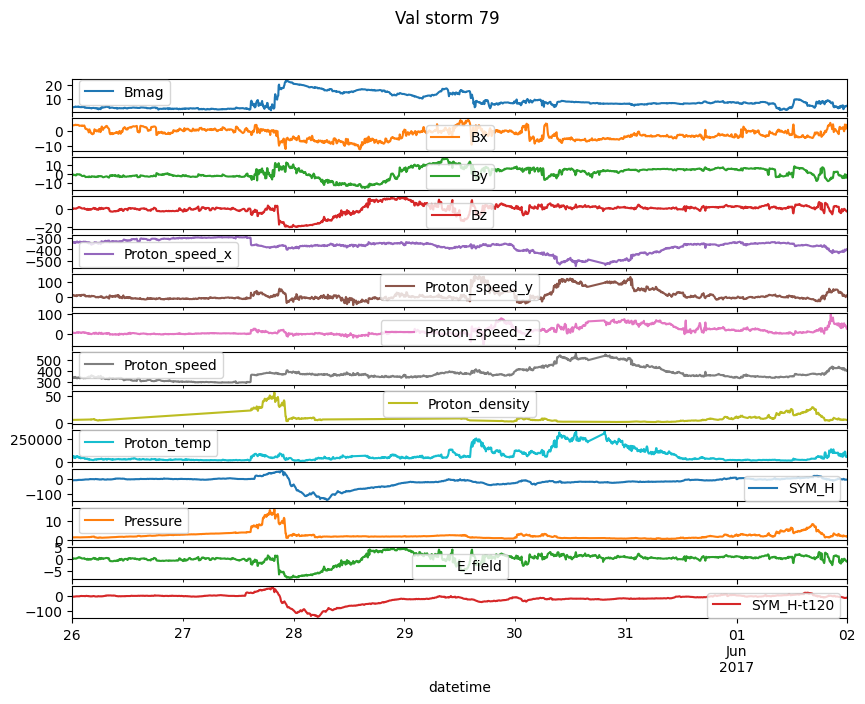

val storm 80


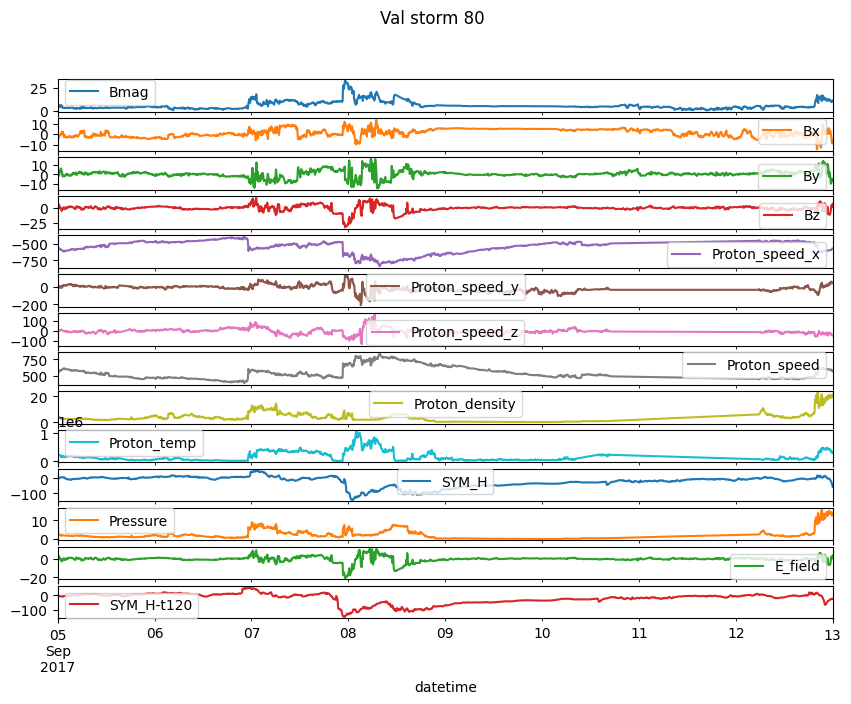

In [8]:
if plot_graphs:
    for storm in val_storms:
        print('val storm', global_index_storm)
        storm.plot(subplots=True, title=f'Val storm {global_index_storm}', figsize = (10, 7))
        global_index_storm += 1
        plt.show();

test storm 81


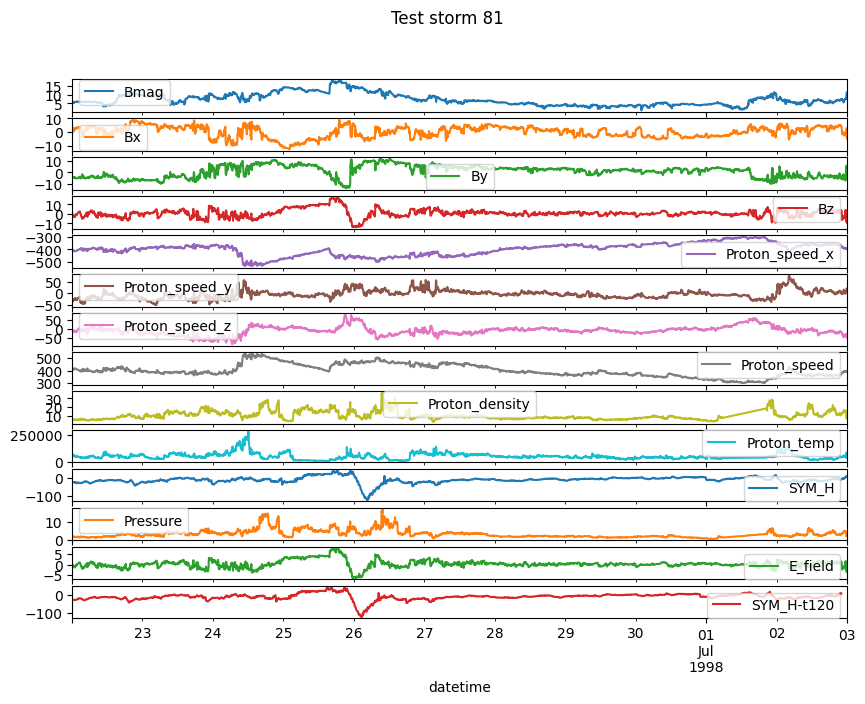

test storm 82


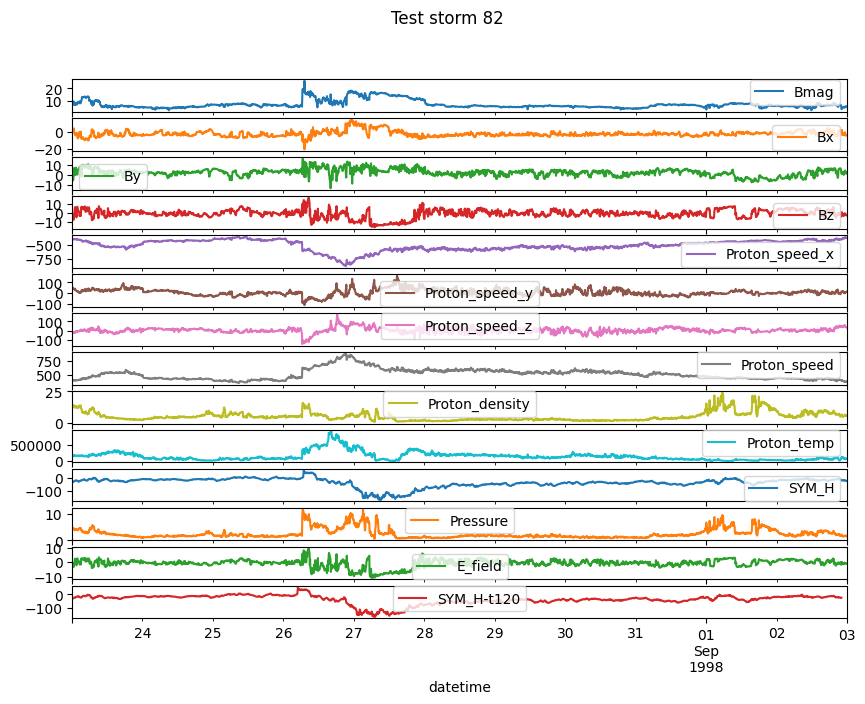

test storm 83


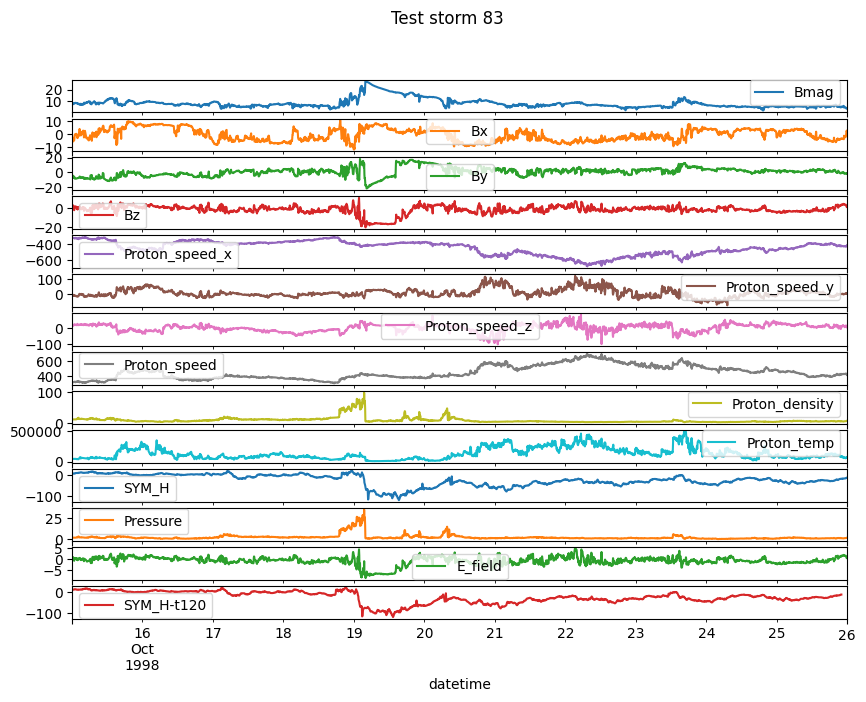

test storm 84


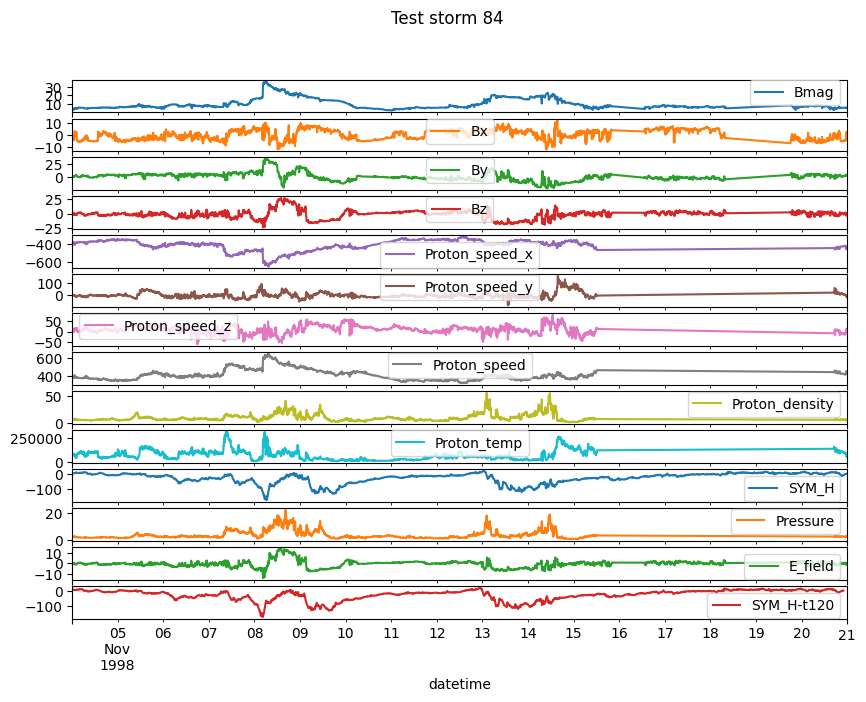

test storm 85


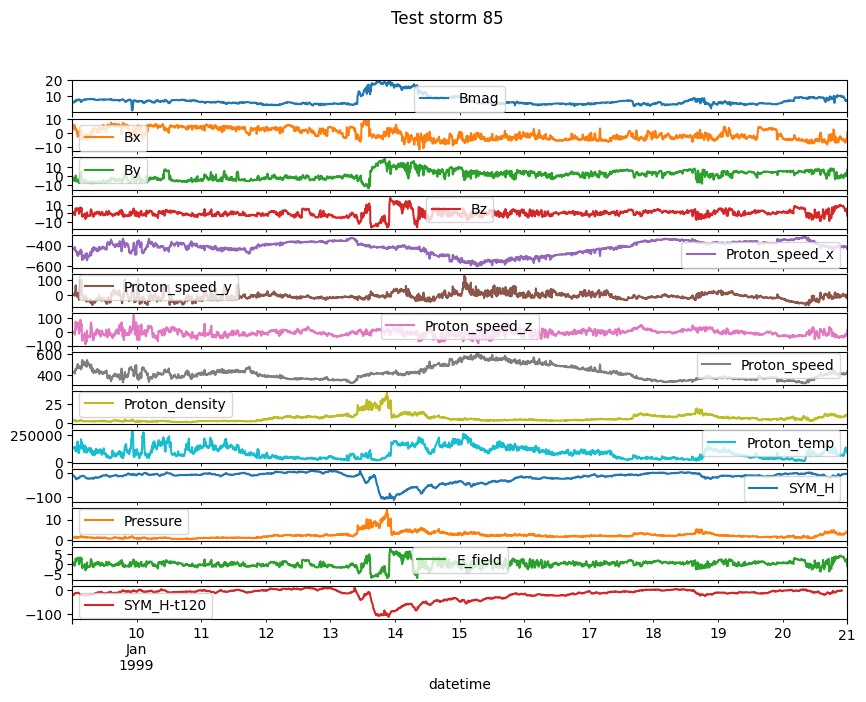

test storm 86


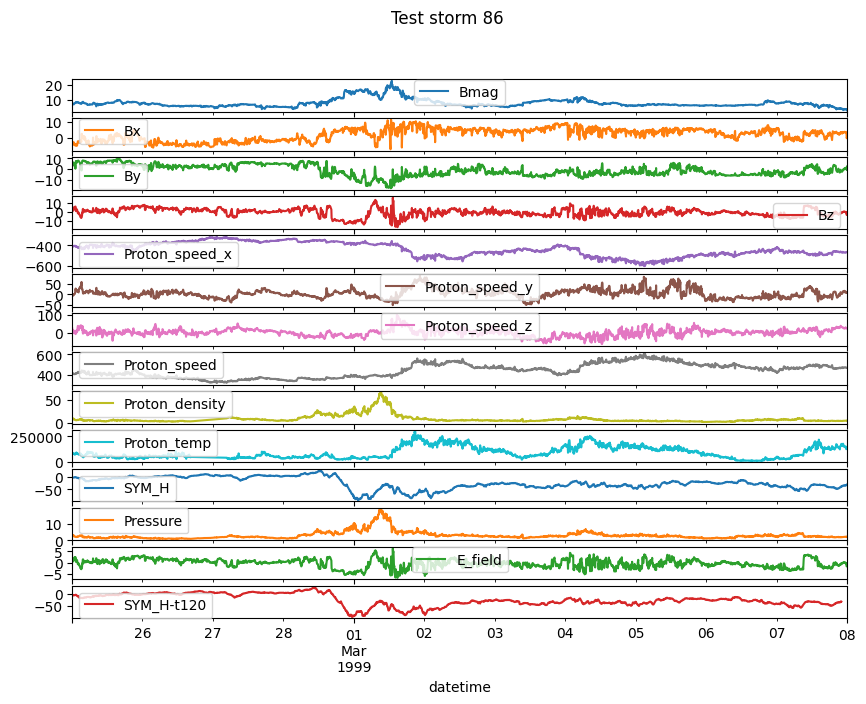

test storm 87


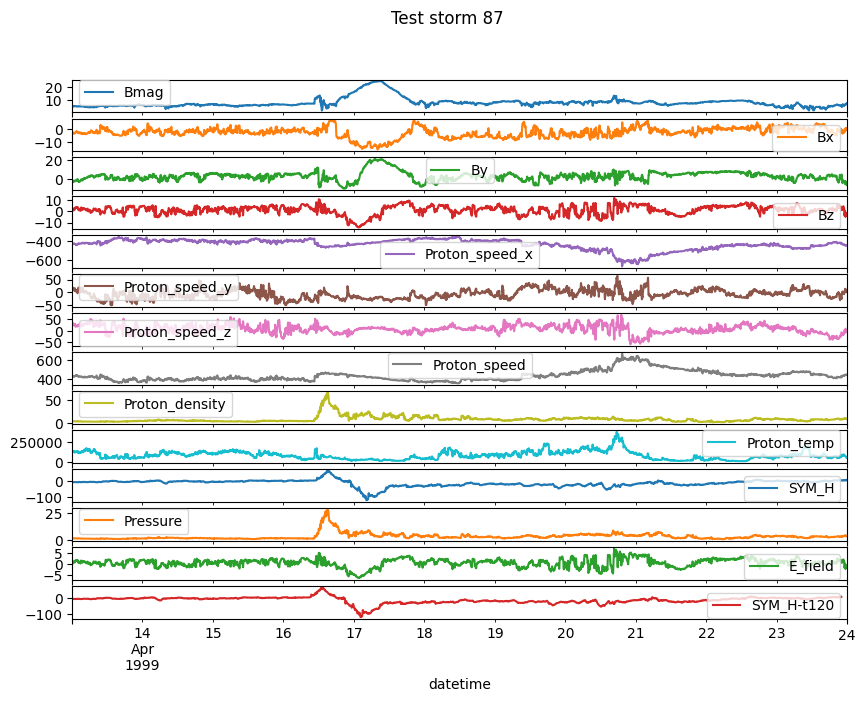

test storm 88


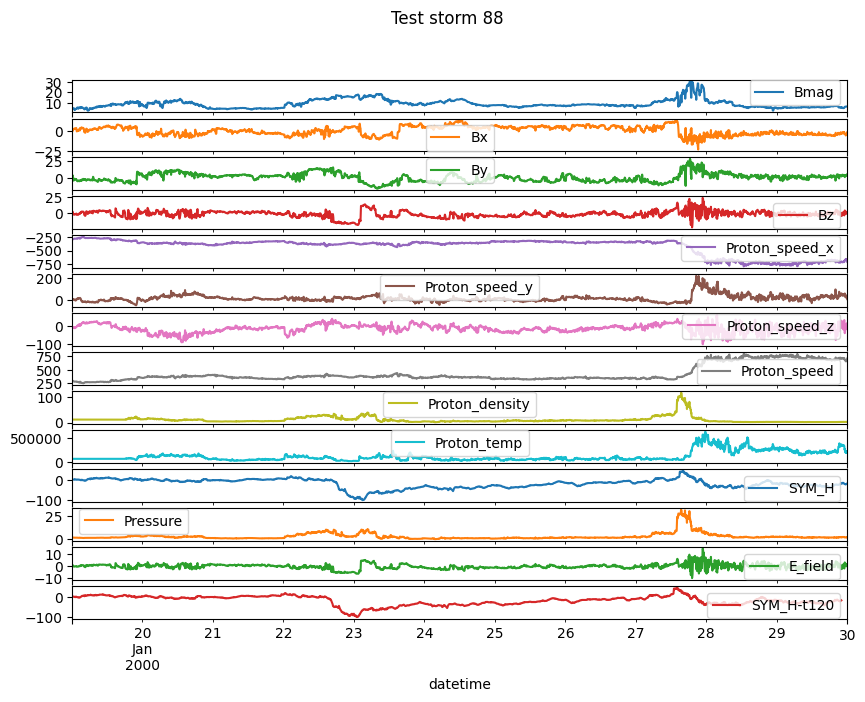

test storm 89


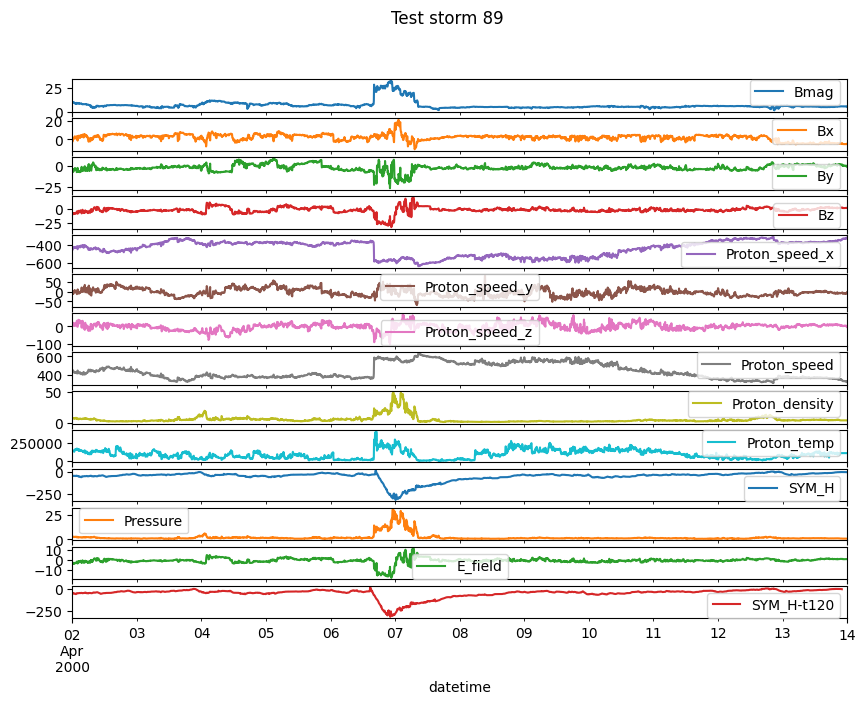

test storm 90


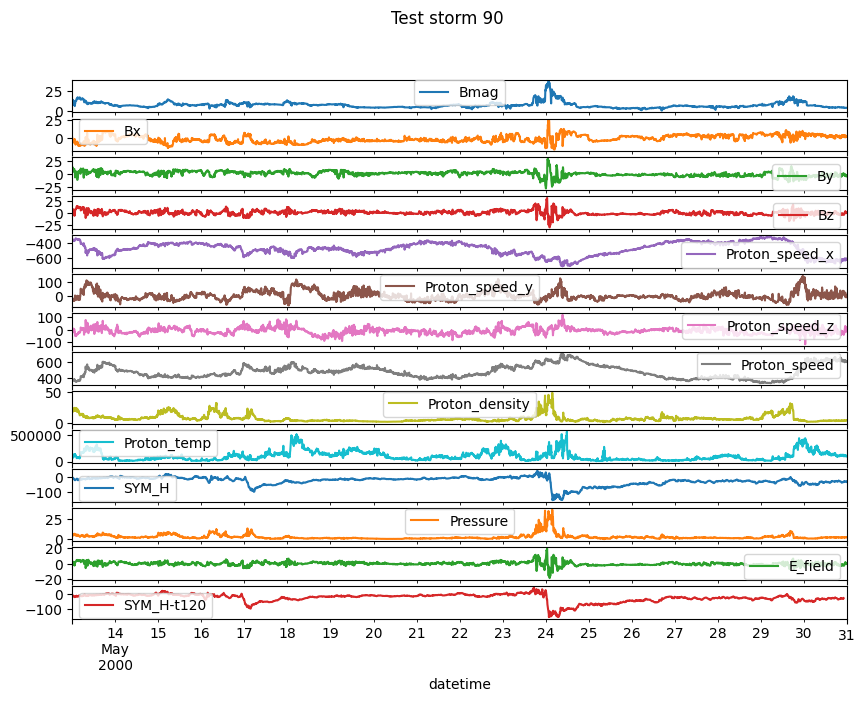

test storm 91


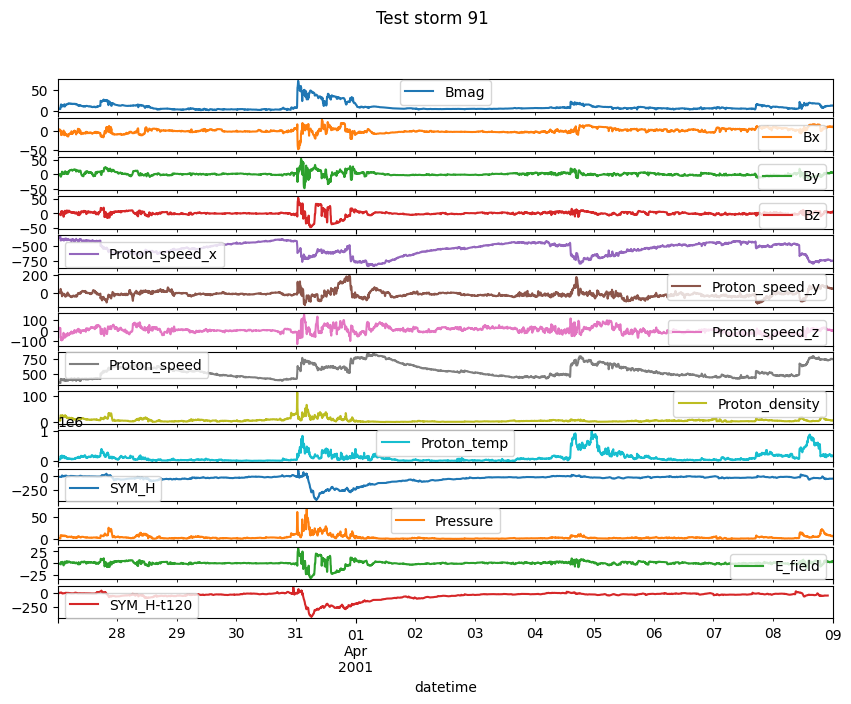

test storm 92


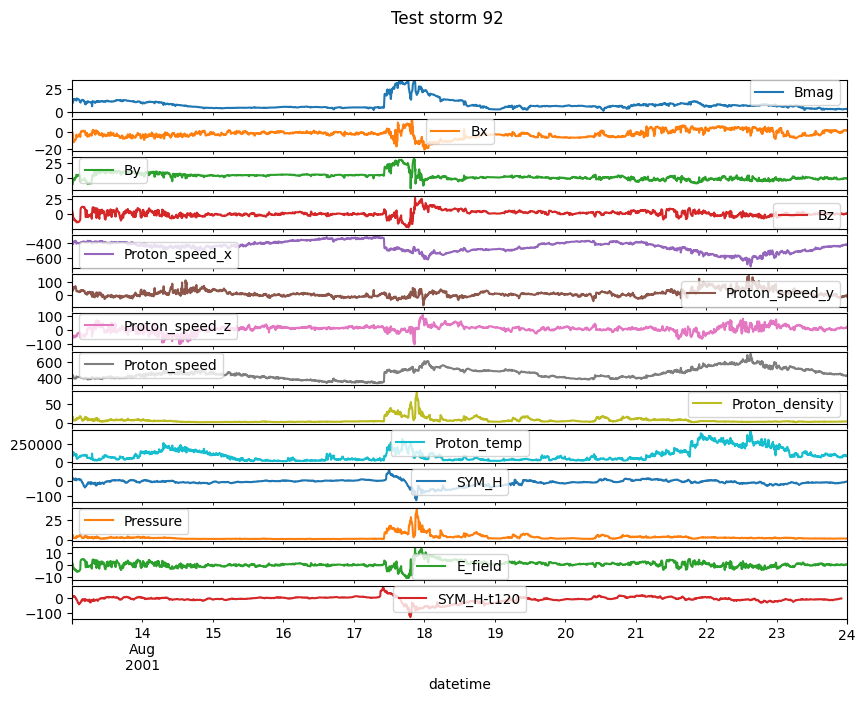

test storm 93


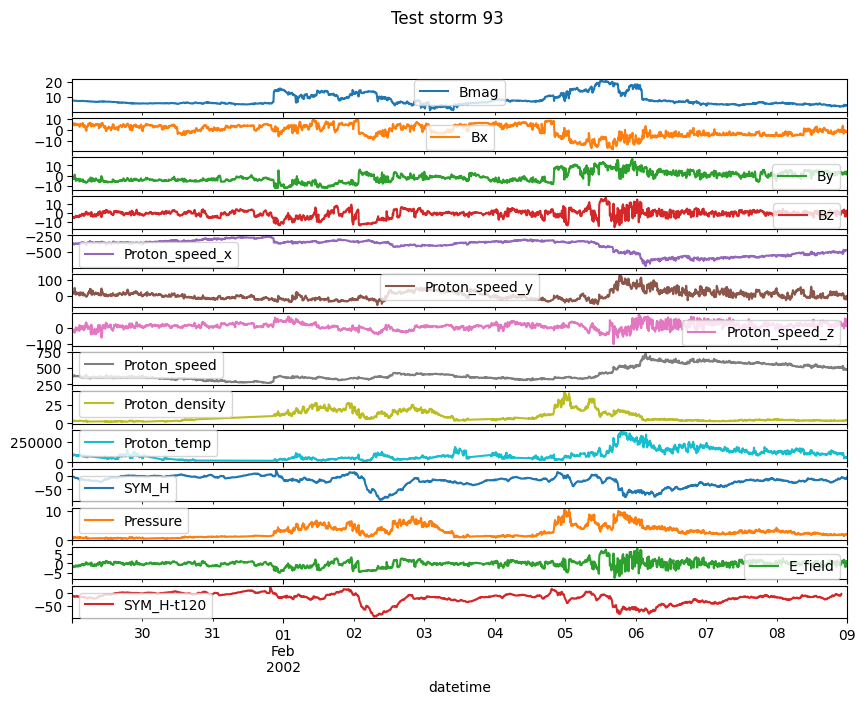

test storm 94


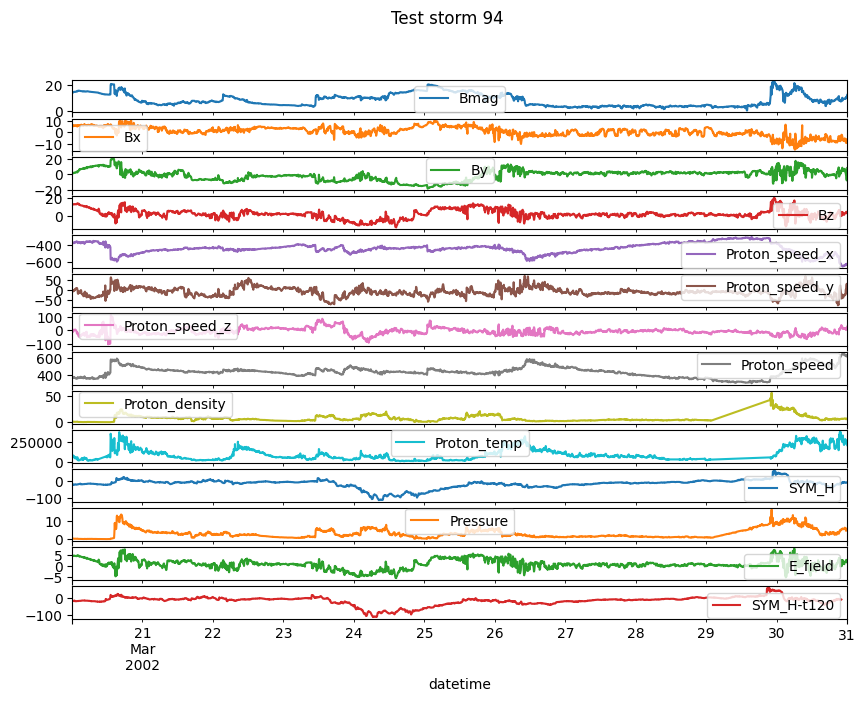

test storm 95


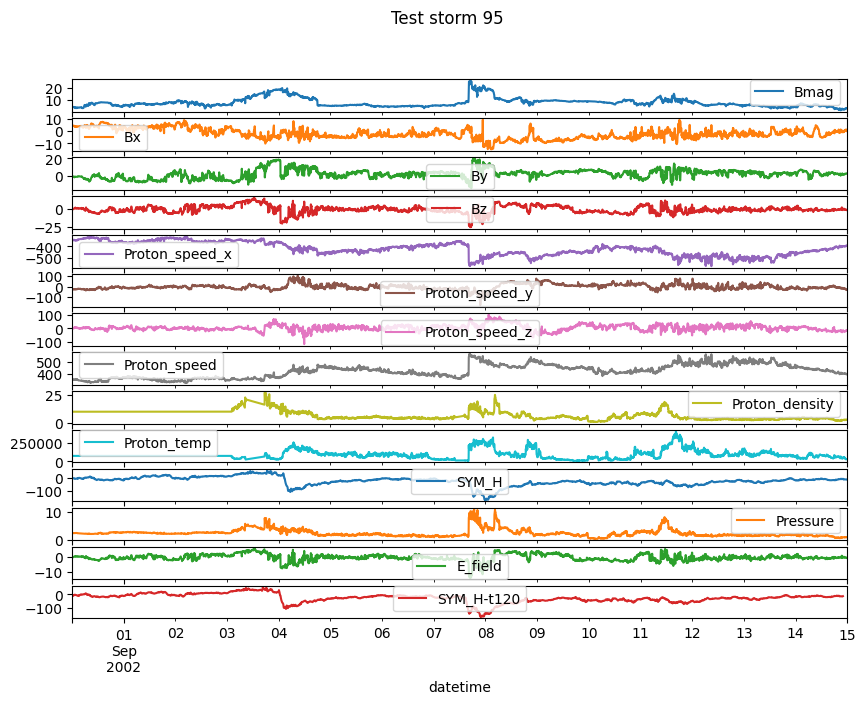

test storm 96


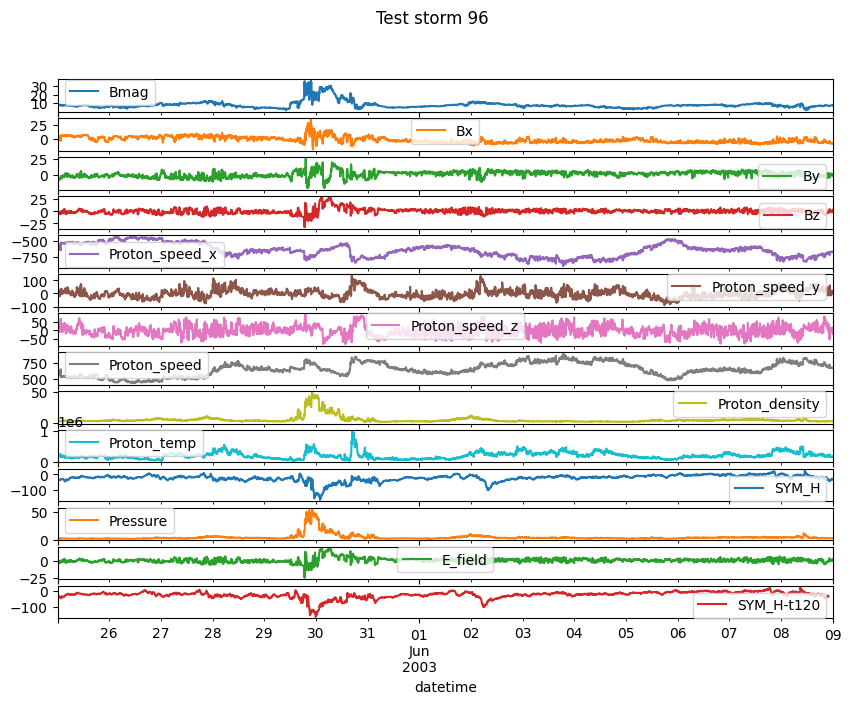

test storm 97


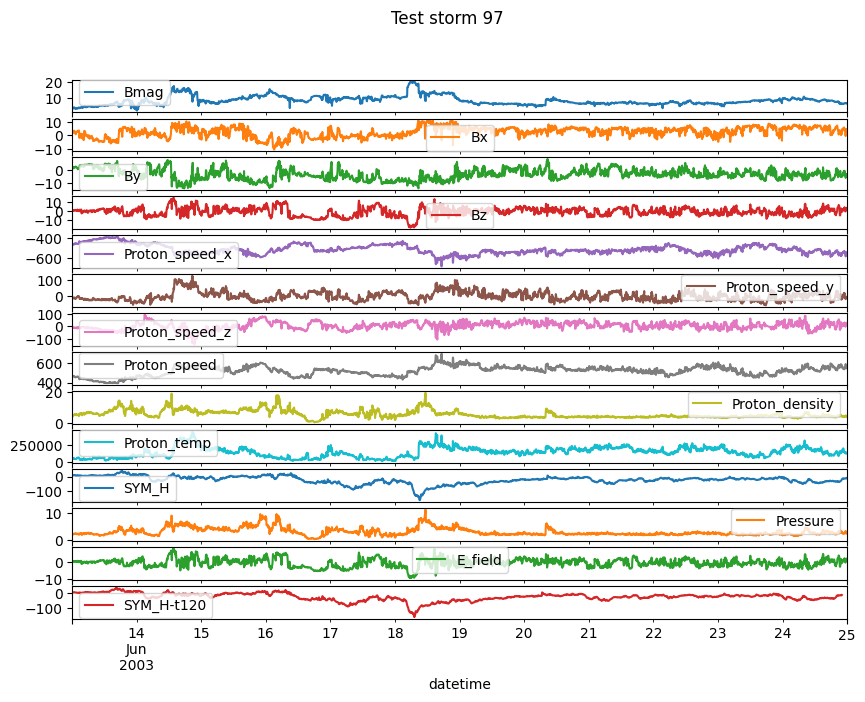

test storm 98


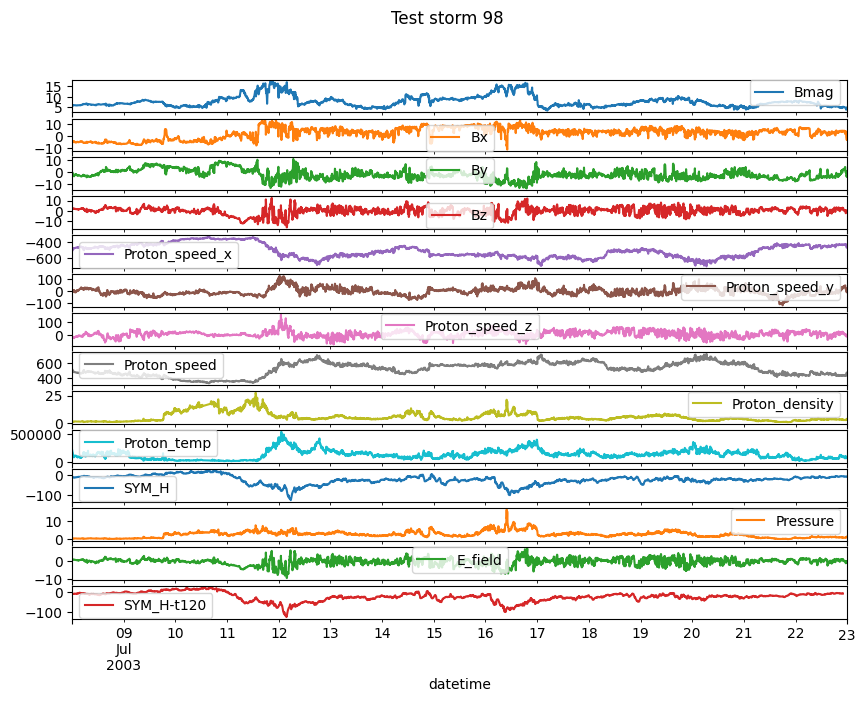

test storm 99


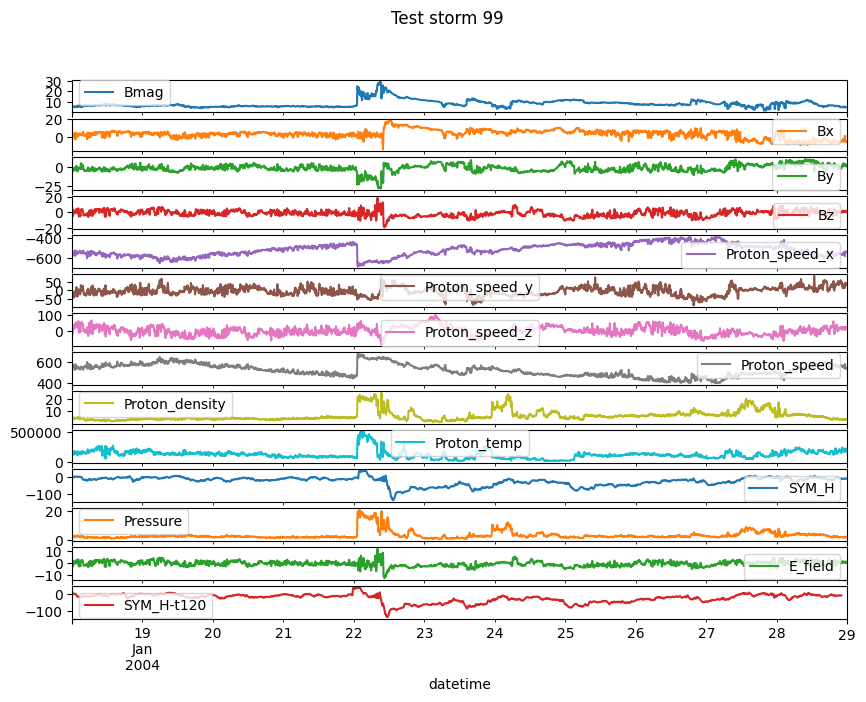

test storm 100


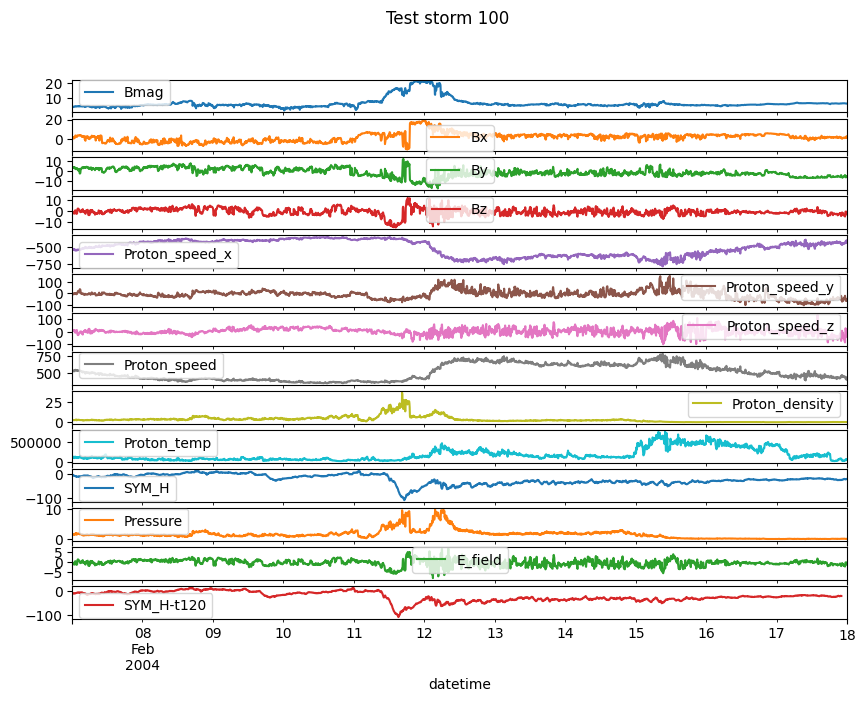

test storm 101


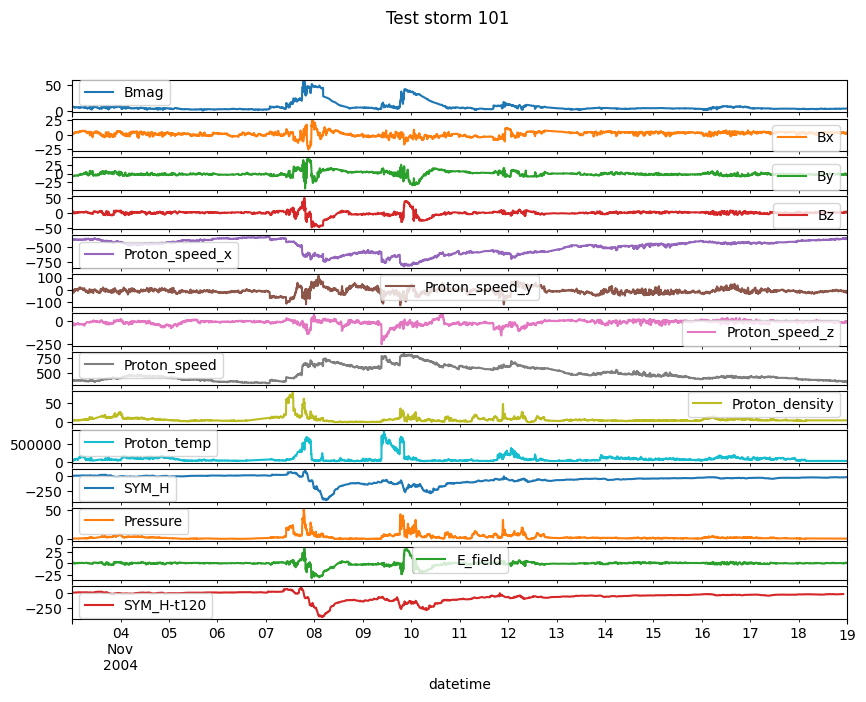

test storm 102


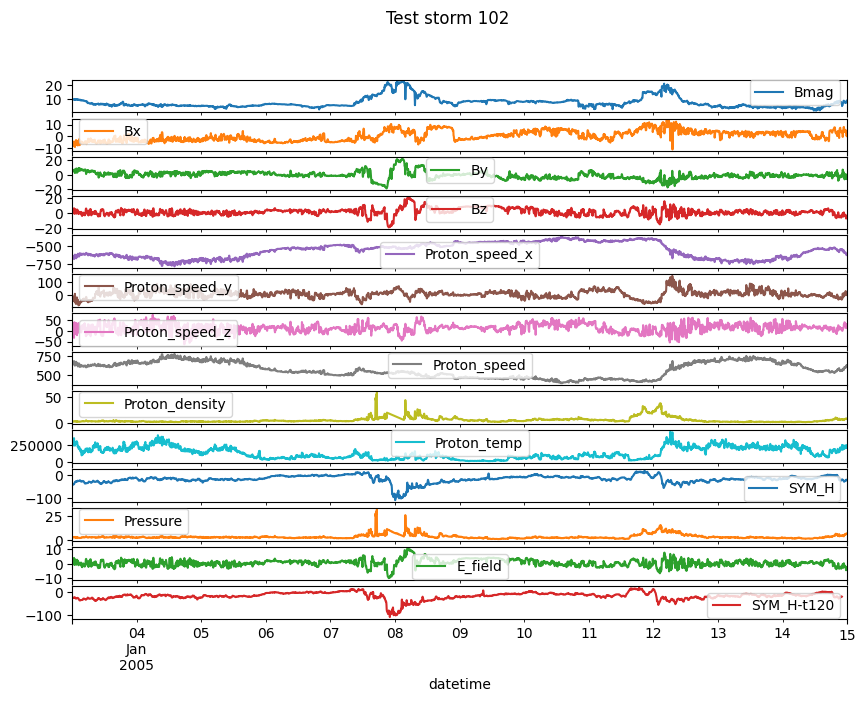

test storm 103


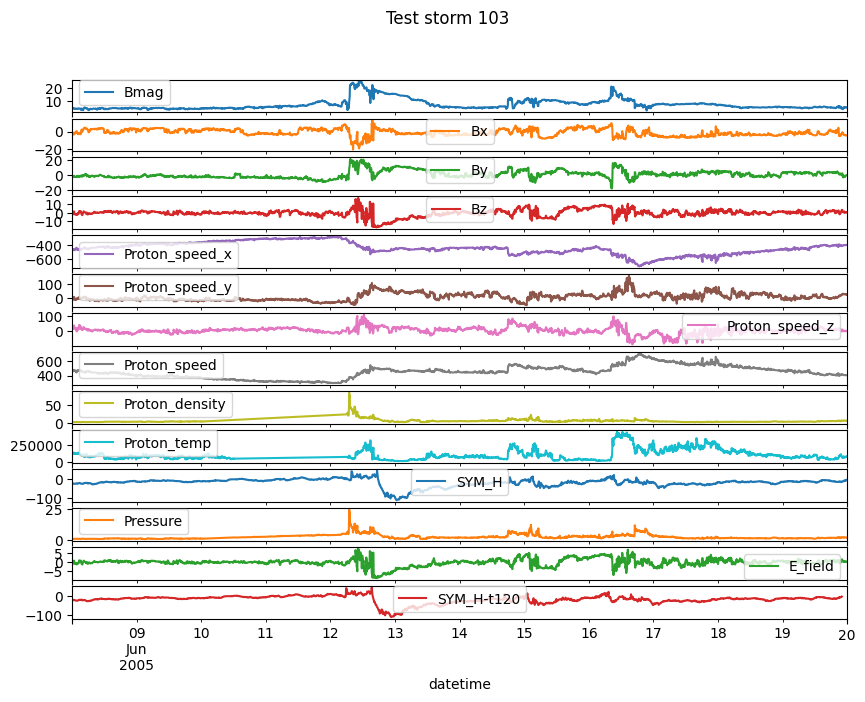

test storm 104


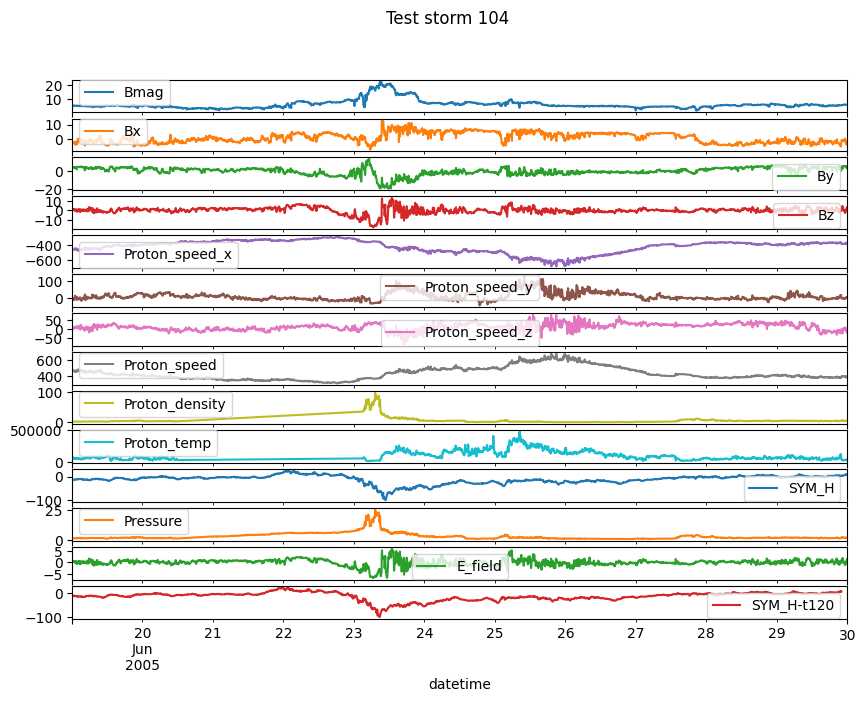

test storm 105


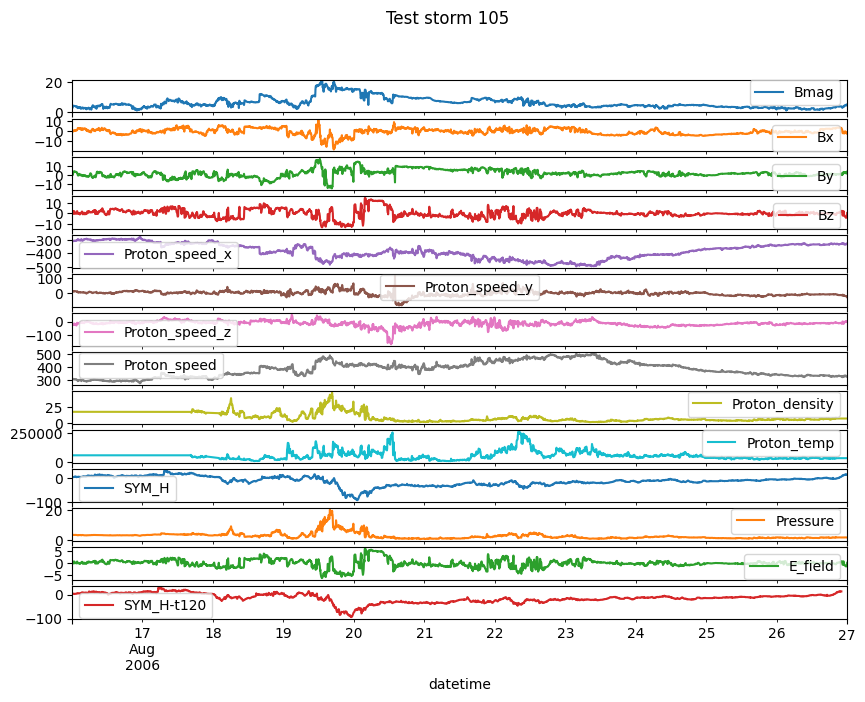

test storm 106


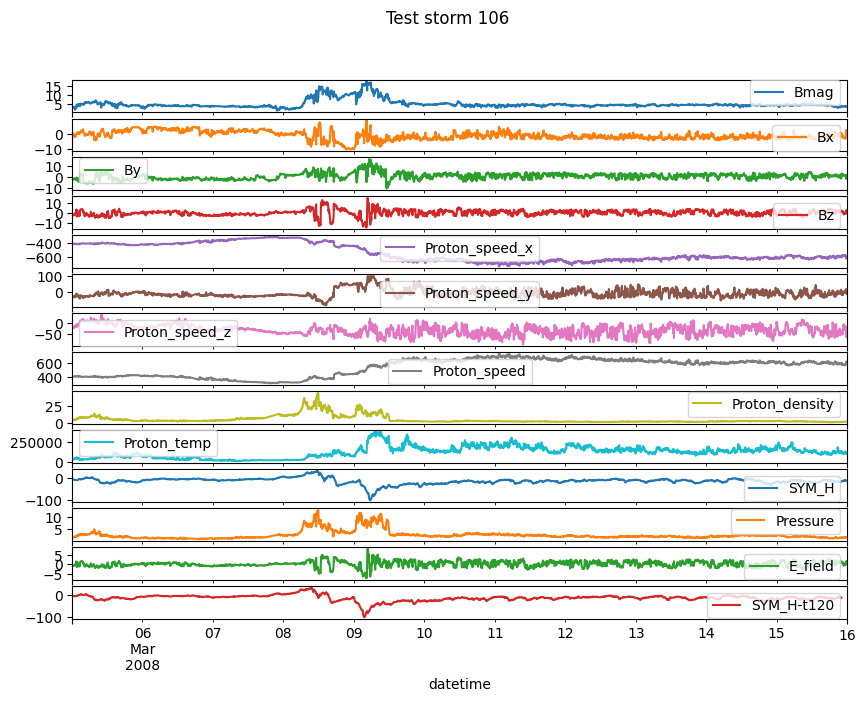

test storm 107


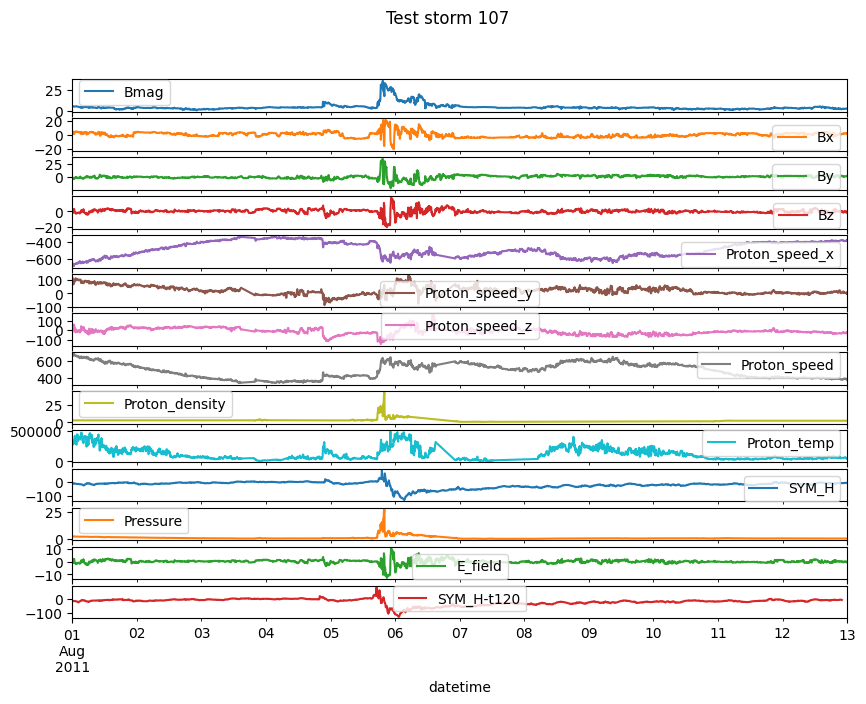

test storm 108


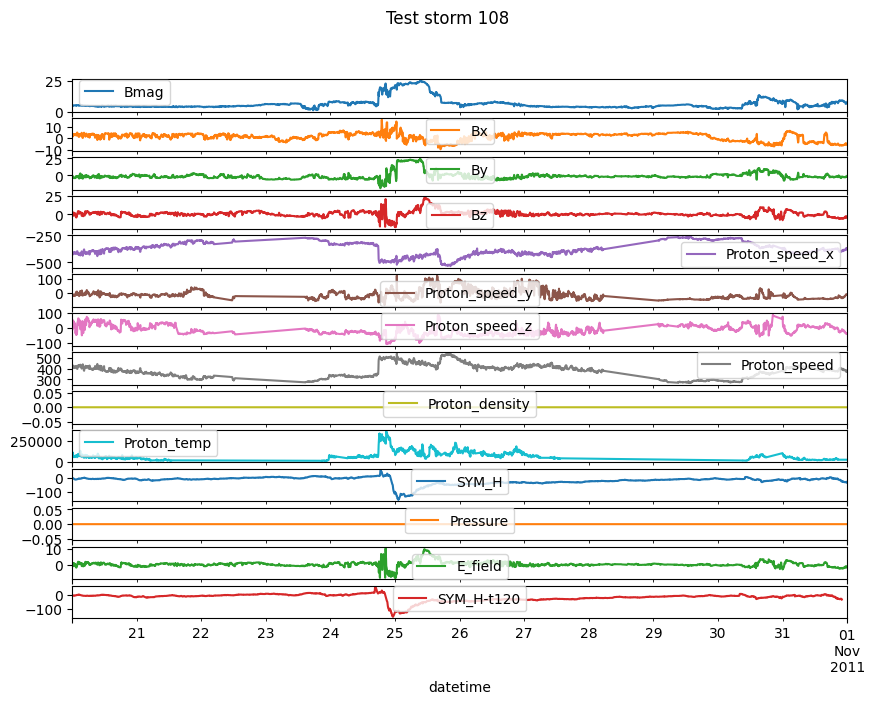

test storm 109


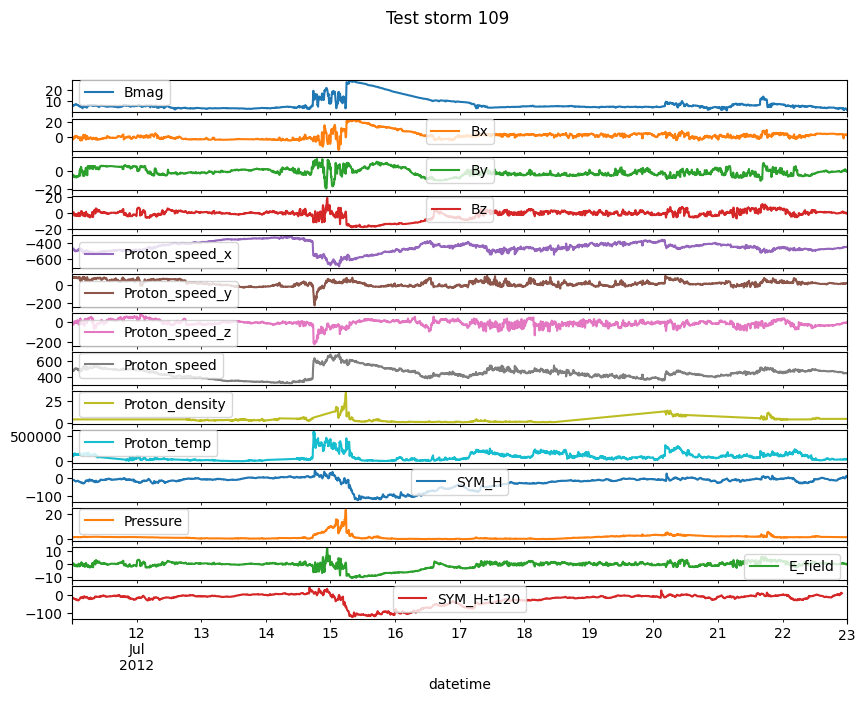

test storm 110


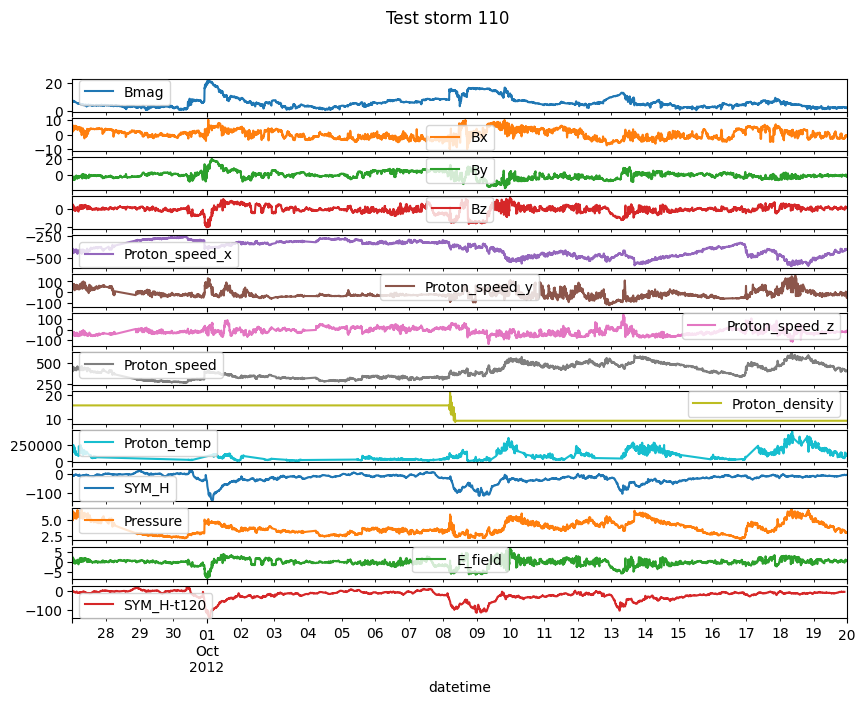

test storm 111


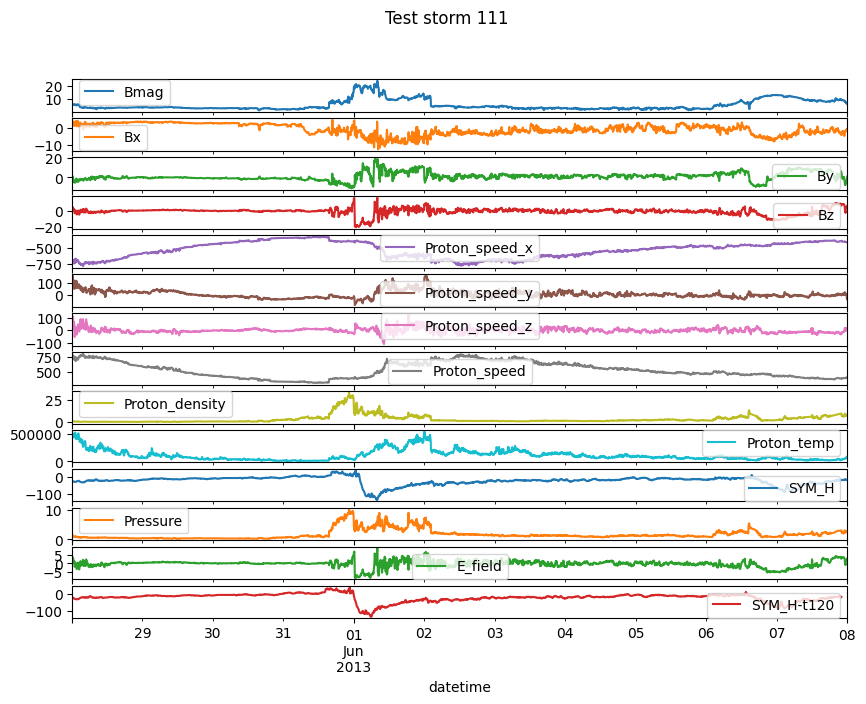

test storm 112


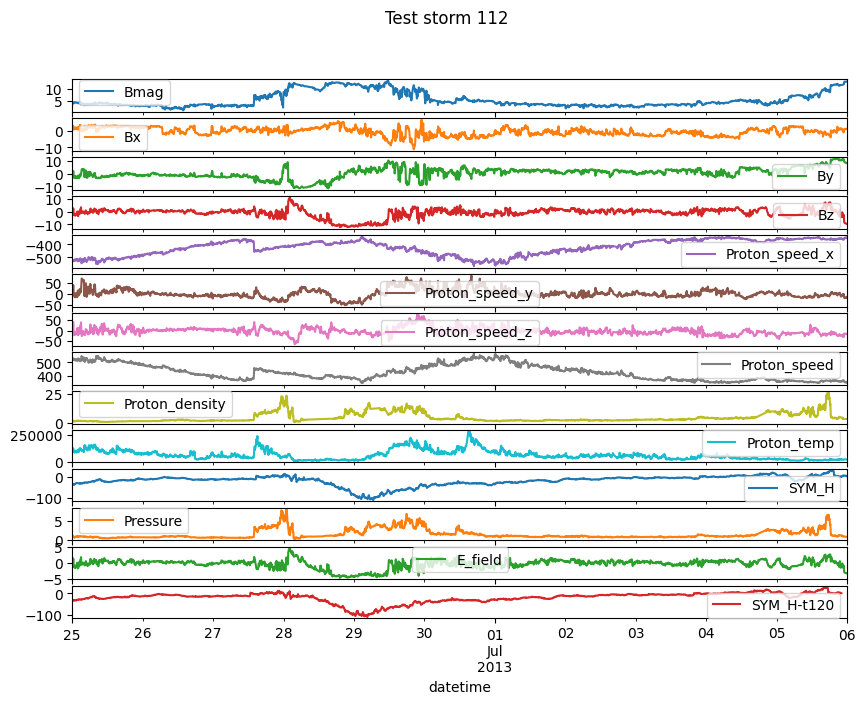

test storm 113


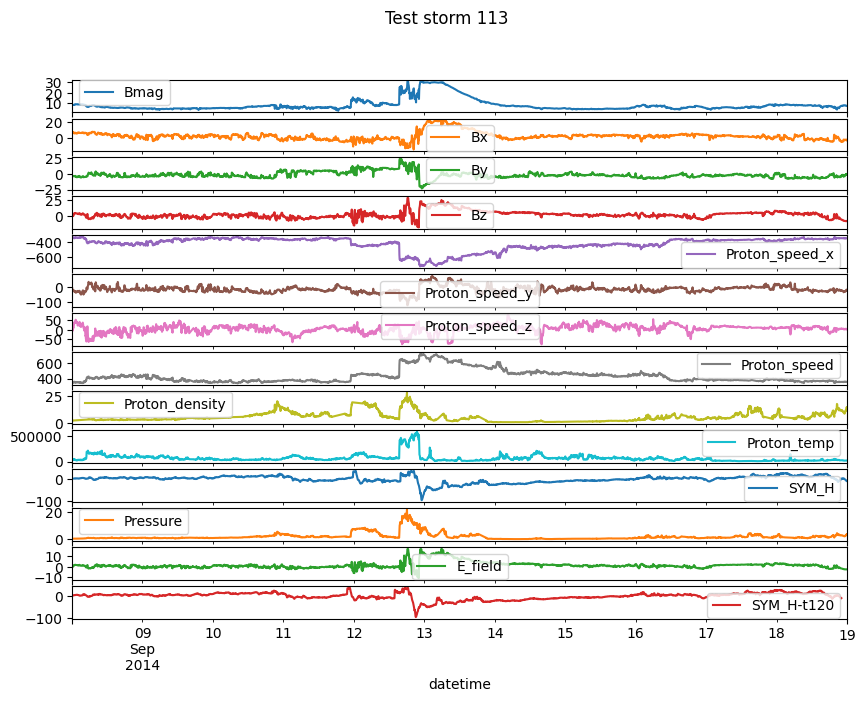

test storm 114


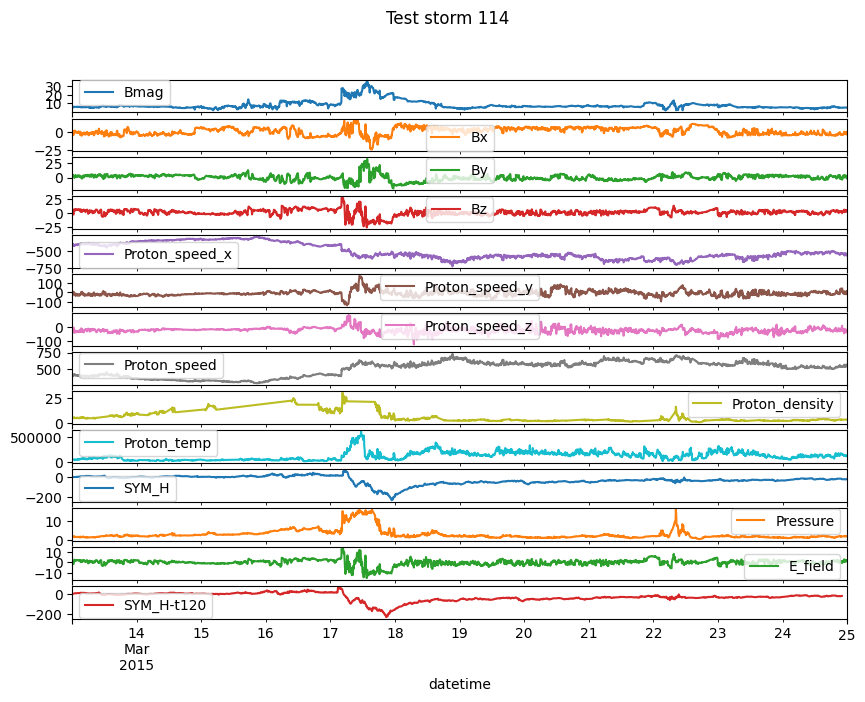

test storm 115


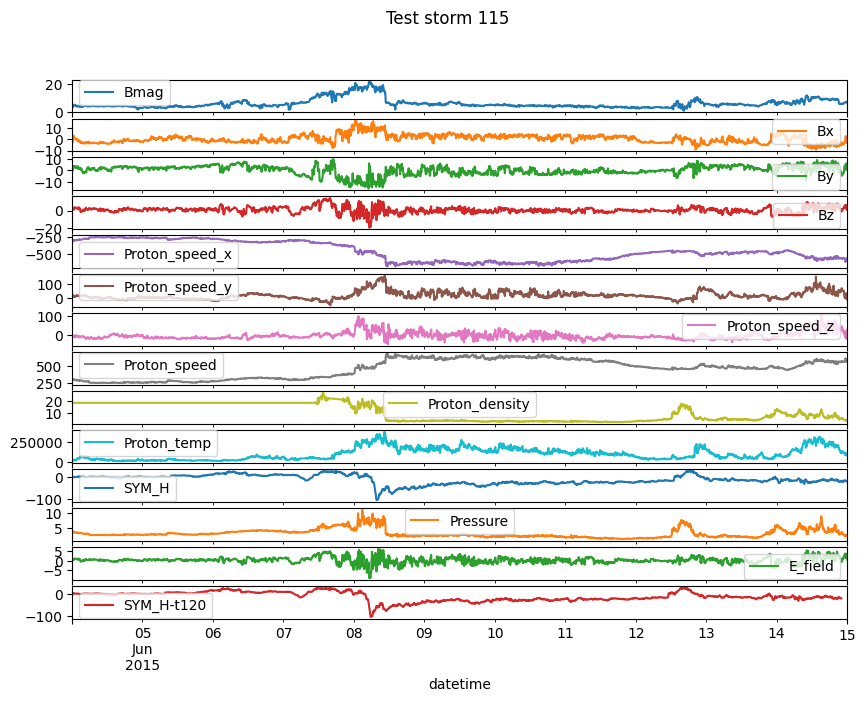

test storm 116


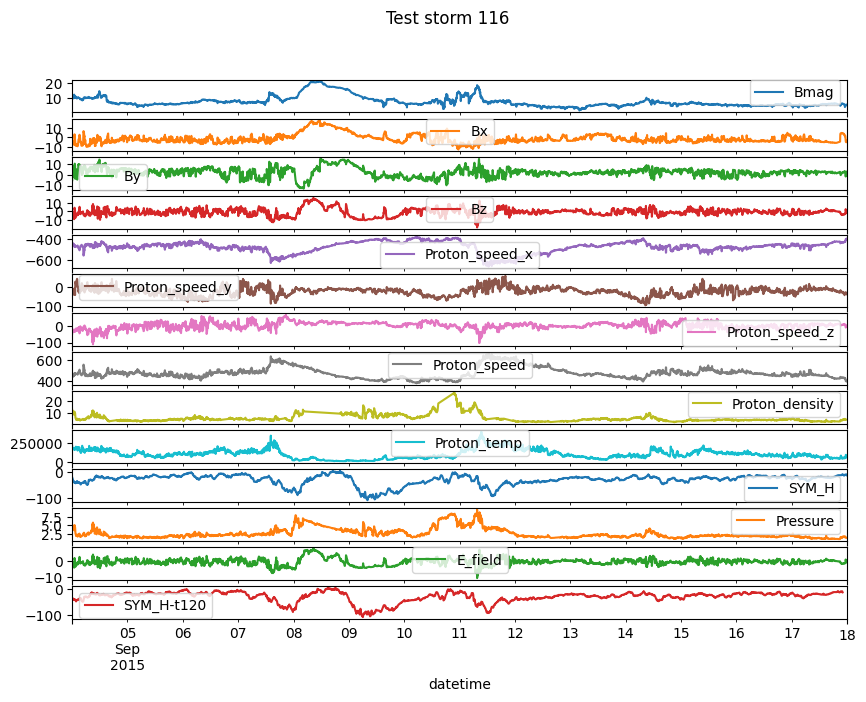

In [9]:
if plot_graphs:
    for storm in test_storms:
        print('test storm', global_index_storm)
        storm.plot(subplots=True, title=f'Test storm {global_index_storm}', figsize = (10, 7))
        global_index_storm += 1
        plt.show();

test key storm 117


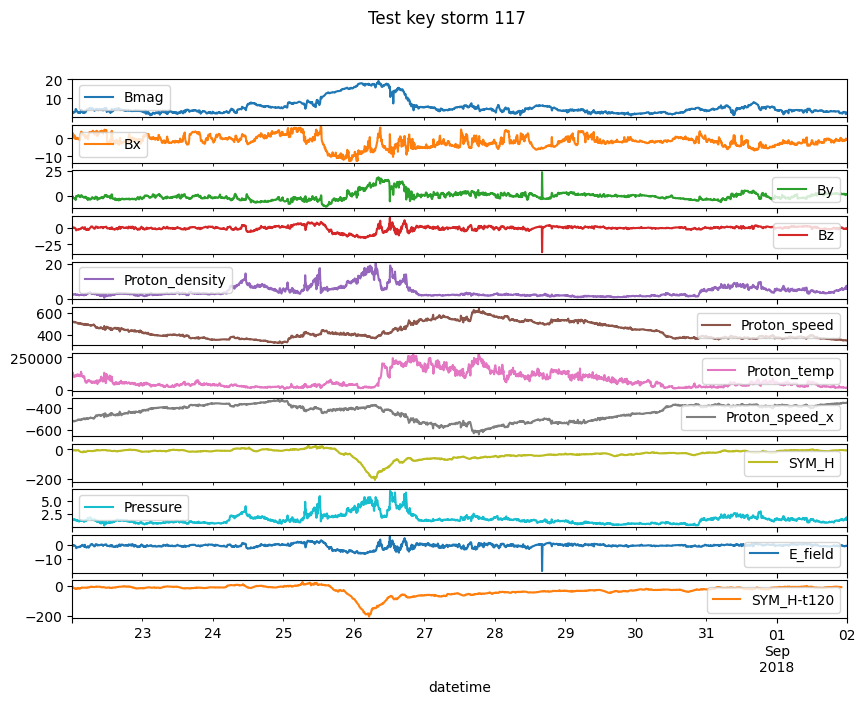

test key storm 118


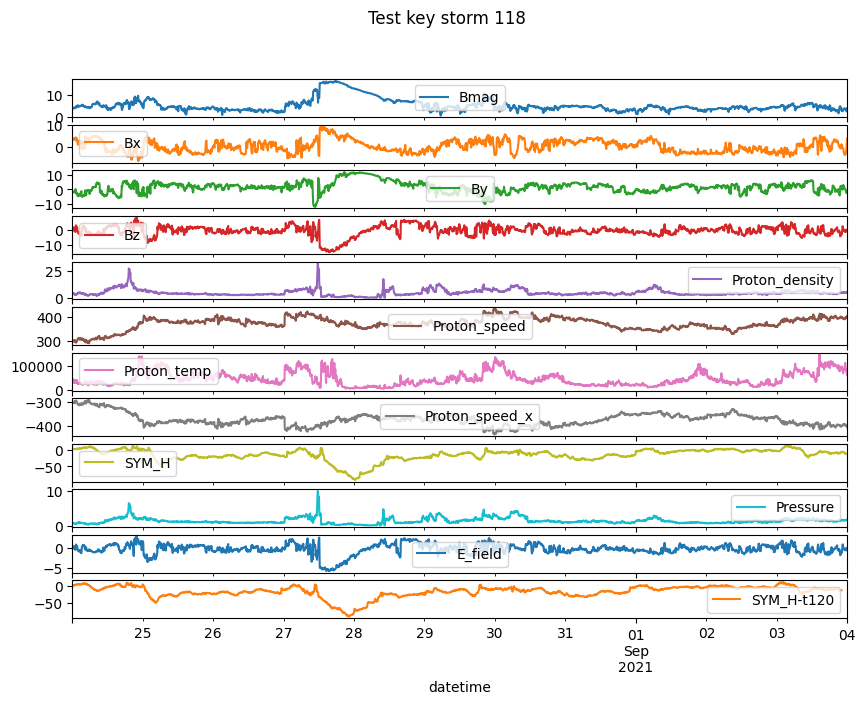

test key storm 119


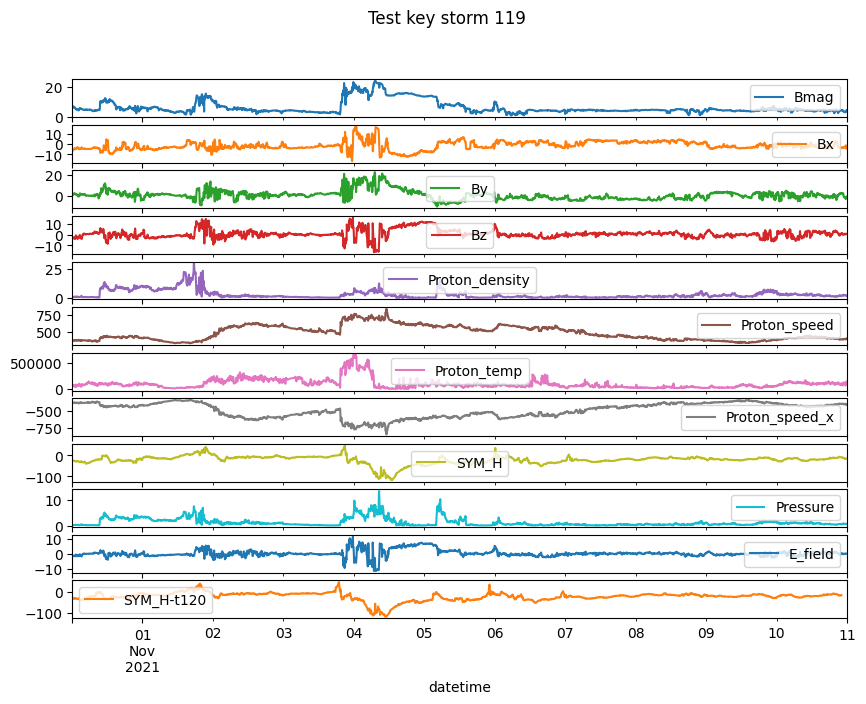

test key storm 120


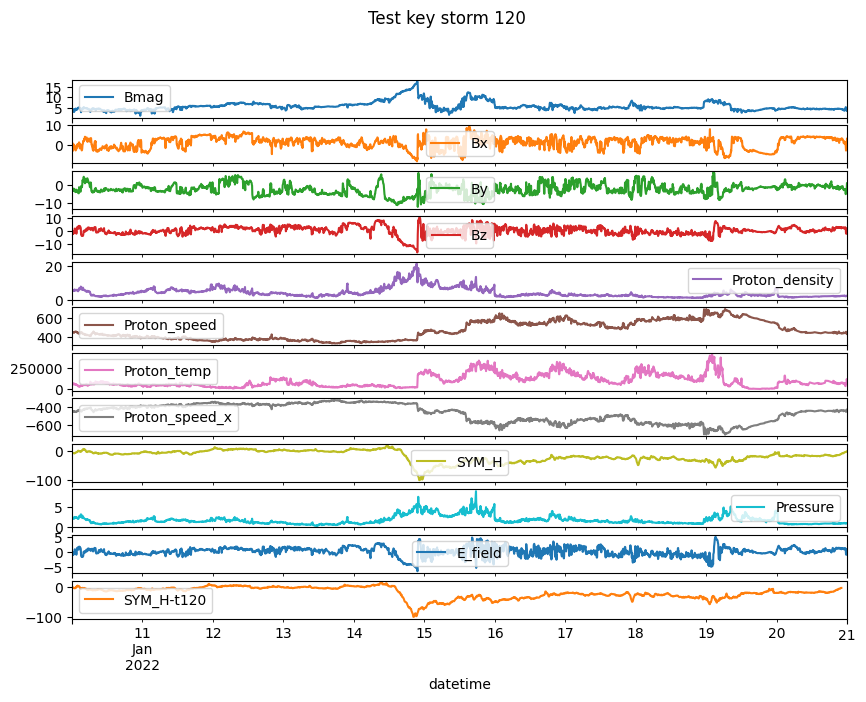

test key storm 121


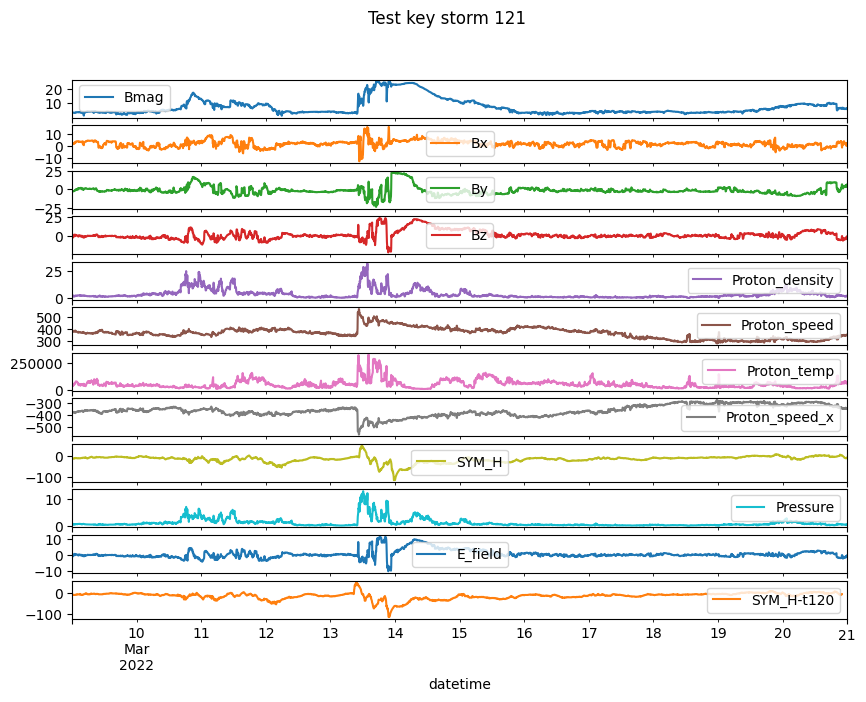

test key storm 122


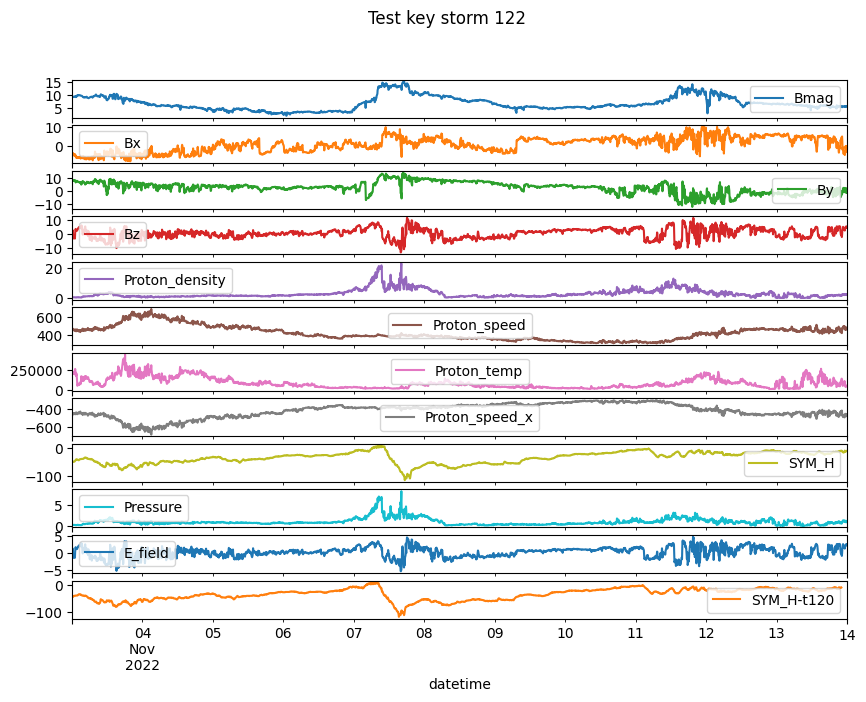

In [10]:
if plot_graphs:
    for storm in test_key_storms:
        print('test key storm', global_index_storm)
        storm.plot(subplots=True, title=f'Test key storm {global_index_storm}', figsize = (10, 7))
        global_index_storm += 1
        plt.show();

## Scale the data <a class="anchor" id="section_1_3"></a>
By default the saved scaled are used, they were created using the commented lines

In [11]:
#scaler = StandardScaler()
#labelScaler = StandardScaler()

#train_storms_all = pd.concat(train_storms + val_storms)

#scaler.fit(train_storms_all[COLS_TO_USE])
#labelScaler.fit(train_storms_all[INDEX_COL].values.reshape(-1, 1))

#pickle.dump(scaler, open('./data/scaler_features_sym.pkl', 'wb'))
#pickle.dump(labelScaler, open('./data/scaler_label_sym.pkl', 'wb'))

scaler = pickle.load(open('./data/scaler_features_sym.pkl', 'rb'))
labelScaler = pickle.load(open('./data/scaler_label_sym.pkl', 'rb'))

for i, storm in enumerate(train_storms):    
    train_storms[i].loc[:, COLS_TO_USE] = scaler.transform(train_storms[i].loc[:, COLS_TO_USE])
    train_storms[i].loc[:, LABEL_COLUMN] = labelScaler.transform(train_storms[i].loc[:, LABEL_COLUMN].values.reshape(-1, 1))
    train_storms[i] = train_storms[i][COLS_ORDER]
    train_storms[i] = train_storms[i].astype('float32')
    
for i, storm in enumerate(val_storms):    
    val_storms[i].loc[:, COLS_TO_USE] = scaler.transform(val_storms[i].loc[:, COLS_TO_USE])    
    val_storms[i][LABEL_COLUMN] = labelScaler.transform(val_storms[i].loc[:, LABEL_COLUMN].values.reshape(-1, 1))
    val_storms[i] = val_storms[i][COLS_ORDER]
    val_storms[i] = val_storms[i].astype('float32')

## Create TensorFlow datasets for the training and validation <a class="anchor" id="section_1_4"></a>

In [12]:
class TimeSeriesDataset:
    def __init__(self, 
                 data, 
                 input_columns,
                 target_columns,
                 input_timesteps,
                 shuffle_on_end = True
                 ):
        self.data = copy.deepcopy(data)
        self.input_columns = input_columns
        self.target_columns = target_columns
        self.input_timesteps = input_timesteps
        self.shuffle = shuffle_on_end
        self.idxs = np.arange(len(self.data) - self.input_timesteps)

    def __len__(self):
        return len(self.data) - self.input_timesteps

    def __getitem__(self,idx):
        idxz = self.idxs[idx]
        x = self.data.iloc[idxz : idxz + self.input_timesteps, :self.input_columns].values
        y = self.data.iloc[idxz + self.input_timesteps - 1, -self.target_columns:].values 
        return x, y
    
    def __call__(self):
        for i in range(self.__len__()):
            yield self.__getitem__(i)
            
            if i == self.__len__()-1:
                self.on_epoch_end()
    
    def on_epoch_end(self):
        if (self.shuffle):
            np.random.shuffle(self.idxs)

def timeseries_dataset_from_df(dfs, batch_size , cols_for_ds, shuffle=False, target_columns = 4):
    dataset = None
    timesteps = lookback

    # iterate through periods
    for ind, period_df in enumerate(dfs):
        print('Processing df', ind)
        # realign features and labels so that first sequence of lookback is 
        #aligned with the lookback + 1 target
        period_gen = TimeSeriesDataset(
            period_df, input_columns = len(cols_for_ds), target_columns = target_columns,
            input_timesteps = timesteps, shuffle_on_end = shuffle
        )
        period_ds = tf.data.Dataset.from_generator(period_gen,
                                    output_signature=(
                                        tf.TensorSpec(shape = (timesteps, len(cols_for_ds)), dtype = tf.float32),
                                        tf.TensorSpec(shape = (target_columns), dtype = tf.float32)
                                    ))
        if dataset is None:
            dataset = period_ds
        else:
            dataset = dataset.concatenate(period_ds)

    dataset = dataset.batch(batch_size)
    if (shuffle):
        dataset = dataset.shuffle(batch_size, seed = 42)
    return dataset

train_ds = timeseries_dataset_from_df(
    train_storms, batch_size, COLS_TO_USE, True, target_columns = 1)

val_ds = timeseries_dataset_from_df(
    val_storms, batch_size, COLS_TO_USE, False, target_columns = 1)

Processing df 0


2024-01-17 12:15:31.125965: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-01-17 12:15:31.126096: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-01-17 12:15:31.126146: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

Processing df 1
Processing df 2
Processing df 3
Processing df 4
Processing df 5
Processing df 6
Processing df 7
Processing df 8
Processing df 9
Processing df 10
Processing df 11
Processing df 12
Processing df 13
Processing df 14
Processing df 15
Processing df 16
Processing df 17
Processing df 18
Processing df 19
Processing df 20
Processing df 21
Processing df 22
Processing df 23
Processing df 24
Processing df 25
Processing df 26
Processing df 27
Processing df 28
Processing df 29
Processing df 30
Processing df 31
Processing df 32
Processing df 33
Processing df 34
Processing df 35
Processing df 36
Processing df 37
Processing df 38
Processing df 39
Processing df 40
Processing df 41
Processing df 42
Processing df 43
Processing df 44
Processing df 45
Processing df 46
Processing df 47
Processing df 48
Processing df 49
Processing df 50
Processing df 51
Processing df 52
Processing df 53
Processing df 54
Processing df 55
Processing df 56
Processing df 57
Processing df 58
Processing df 59
Proces

2024-01-17 12:15:32.306737: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


Processing df 0
Processing df 1
Processing df 2
Processing df 3
Processing df 4
Processing df 5
Processing df 6
Processing df 7
Processing df 8
Processing df 9
Processing df 10
Processing df 11
Processing df 12
Processing df 13
Processing df 14


## Definition of the model <a class="anchor" id="section_1_5"></a>

In [13]:
class Baseline_model(tf.keras.Model):
    def __init__(
        self,
        d_model,
    ):

        super().__init__()
        self.d_model = d_model

    def build(self, input_shape):        
        self.lstm = tf.keras.layers.LSTM(d_model)
        self.dense1 = tf.keras.layers.Dense(d_model, activation = 'elu')
        self.dense2 = tf.keras.layers.Dense(d_model, activation = 'elu')
        self.dense3 = tf.keras.layers.Dense(1, activation = None)        
        
    def call(self, inputs, training):
        x = self.lstm(inputs)
        x = self.dense1(x)
        x = self.dense2(x)
        x = self.dense3(x)        
        return x

    def get_config(self):
        return {
            "d_model": self.d_model,
        }

    @classmethod
    def from_config(cls, config):
        return cls(**config)

In [14]:
model = Baseline_model(
    d_model = d_model,    
)

ex_inp = tf.random.uniform((2, lookback, len(COLS_TO_USE)))
ex_out = model(ex_inp)

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate= 3e-4),
              loss="mae",
              metrics=["mae", "mse"])

model.summary()

Model: "baseline_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 multiple                  71168     
                                                                 
 dense (Dense)               multiple                  16512     
                                                                 
 dense_1 (Dense)             multiple                  16512     
                                                                 
 dense_2 (Dense)             multiple                  129       
                                                                 
Total params: 104321 (407.50 KB)
Trainable params: 104321 (407.50 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


2024-01-17 12:15:33.606575: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8700


## Training of the model <a class="anchor" id="section_1_6"></a>

In [15]:
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor="val_loss",
    mode="min",
    save_best_only=True,
    verbose=1,
)

es = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=10)

stop_nan = tf.keras.callbacks.TerminateOnNaN()


if RETRAIN:
    history = model.fit(
            train_ds,
            epochs=9000,
            validation_data=val_ds,
            callbacks=[
                model_checkpoint_callback,
                es,
                stop_nan,
            ],)

# Evaluation of the model <a class="anchor" id="section_2"></a>

By default the saved model is used, if RETRAIN is true, the best validation model from the training will be used

## Evaluate the test storms <a class="anchor" id="section_2_1"></a>

Test storm number 81, from 1998-06-24 00:00:00 until 1998-07-01 00:00:00, number of batches: 3168
From 1998-06-24 00:00:00 until 1998-07-01 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


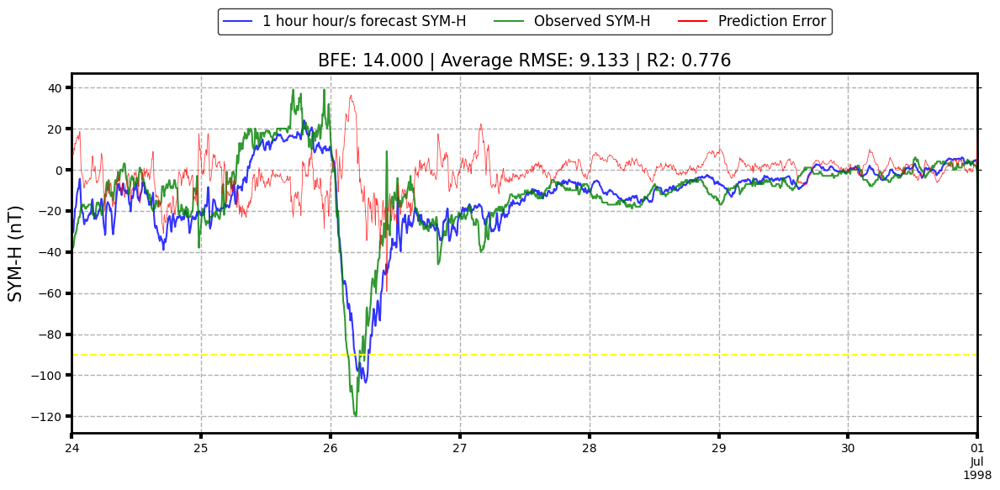

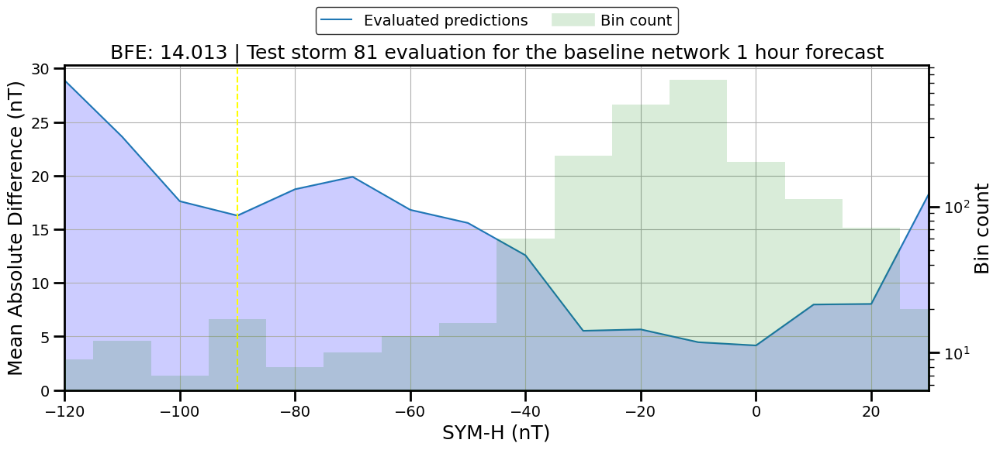

This network predicted_SYM_H --> rmse = 9.133 | r2 = 0.794 | BFE = 14.013
Test storm number 82, from 1998-08-25 00:00:00 until 1998-09-01 00:00:00, number of batches: 3168
From 1998-08-25 00:00:00 until 1998-09-01 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


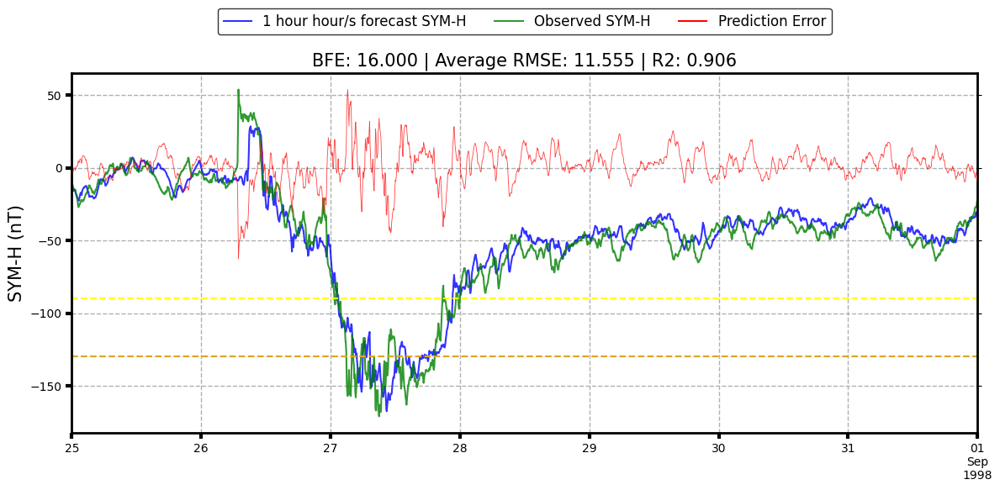

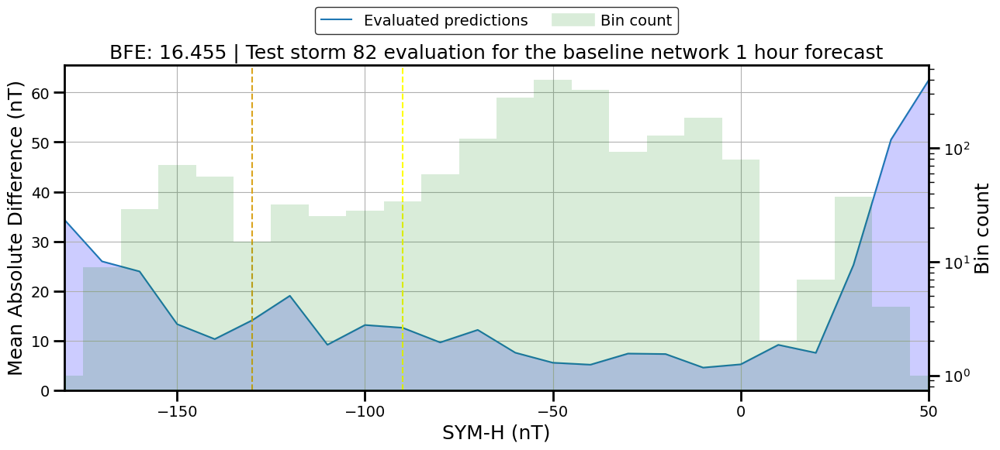

This network predicted_SYM_H --> rmse = 11.555 | r2 = 0.916 | BFE = 16.455
Test storm number 83, from 1998-10-17 00:00:00 until 1998-10-24 00:00:00, number of batches: 3168
From 1998-10-17 00:00:00 until 1998-10-24 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


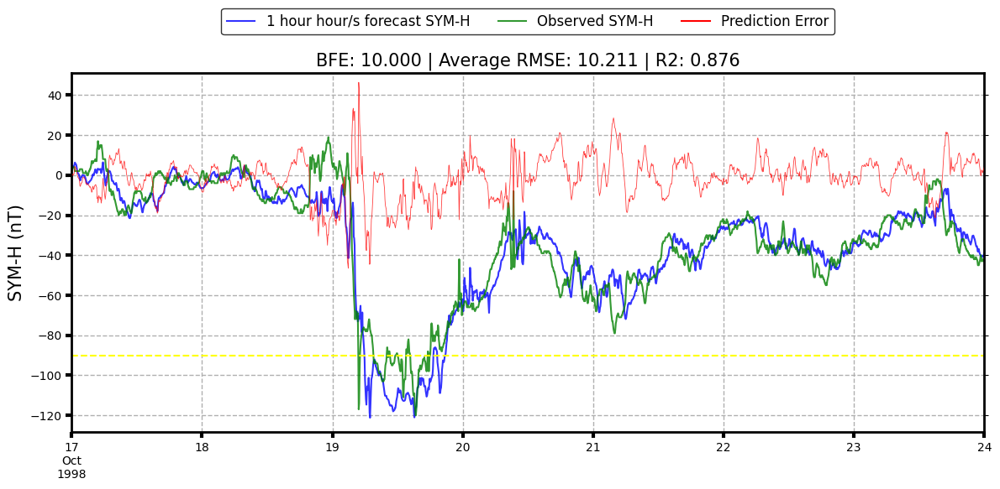

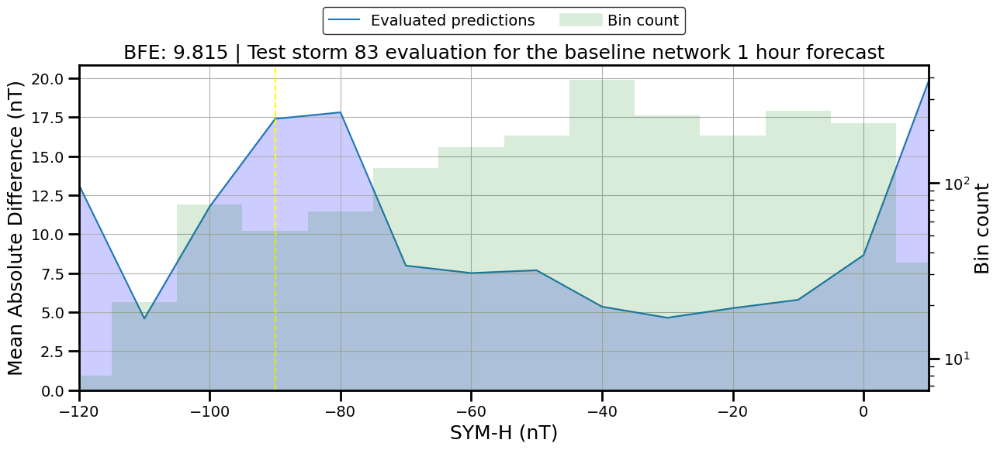

This network predicted_SYM_H --> rmse = 10.211 | r2 = 0.869 | BFE = 9.815
Test storm number 84, from 1998-11-06 00:00:00 until 1998-11-19 00:00:00, number of batches: 4896
From 1998-11-06 00:00:00 until 1998-11-19 00:00:00 shape: (3745, 2)
Metrics comparing SYM_H with predicted_SYM_H


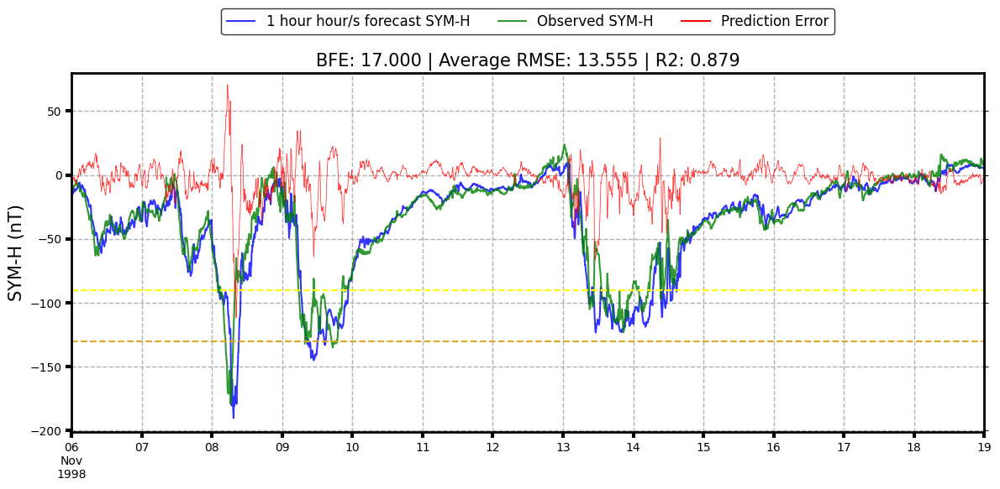

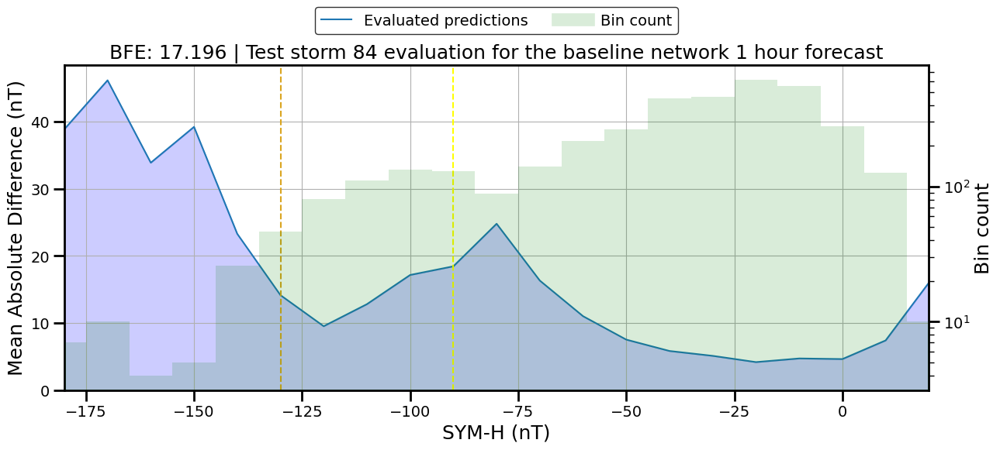

This network predicted_SYM_H --> rmse = 13.555 | r2 = 0.858 | BFE = 17.196
Test storm number 85, from 1999-01-11 00:00:00 until 1999-01-19 00:00:00, number of batches: 3456
From 1999-01-11 00:00:00 until 1999-01-19 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


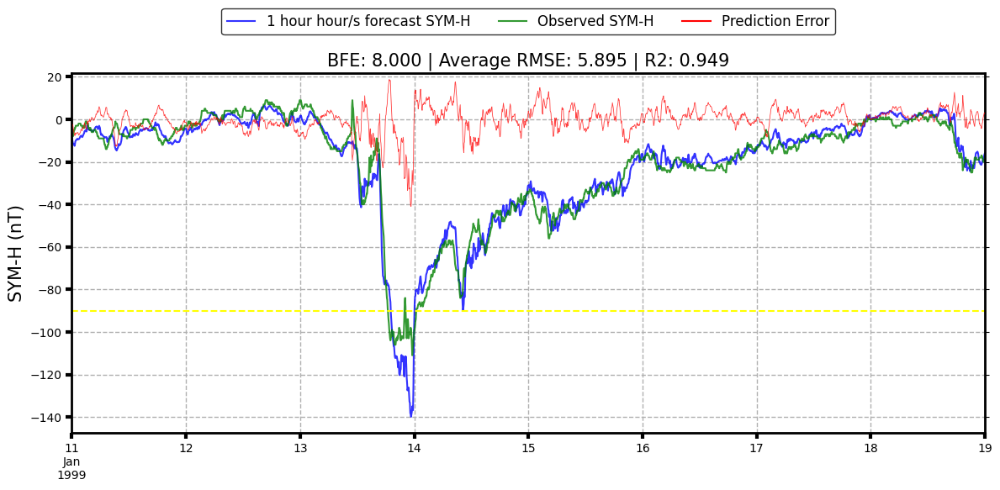

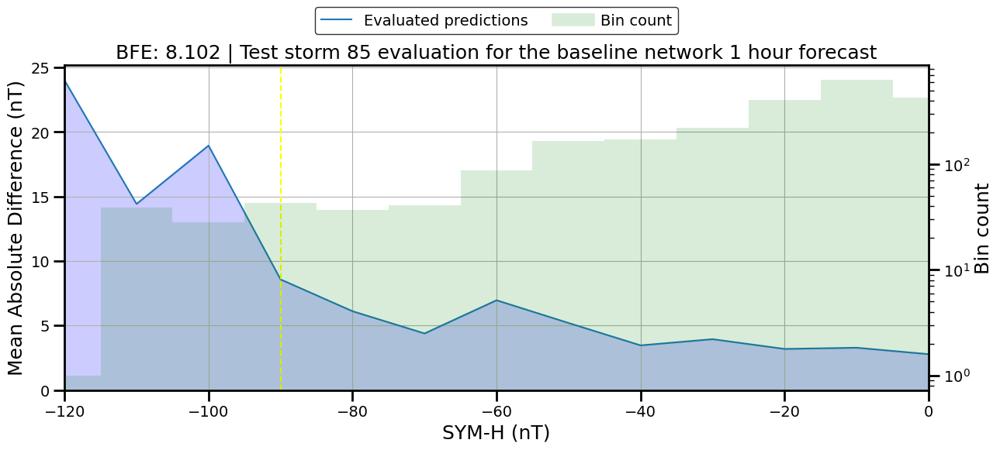

This network predicted_SYM_H --> rmse = 5.895 | r2 = 0.946 | BFE = 8.102
Test storm number 86, from 1999-02-27 00:00:00 until 1999-03-06 00:00:00, number of batches: 3168
From 1999-02-27 00:00:00 until 1999-03-06 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


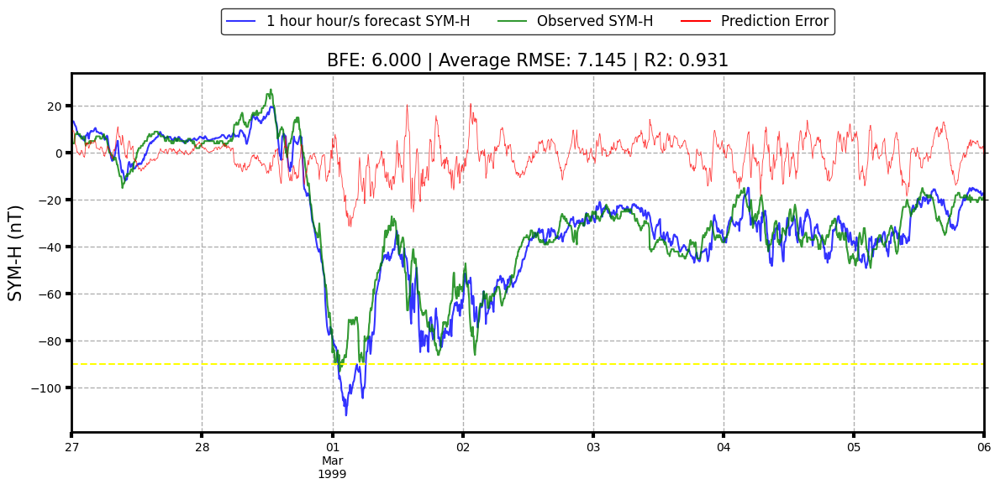

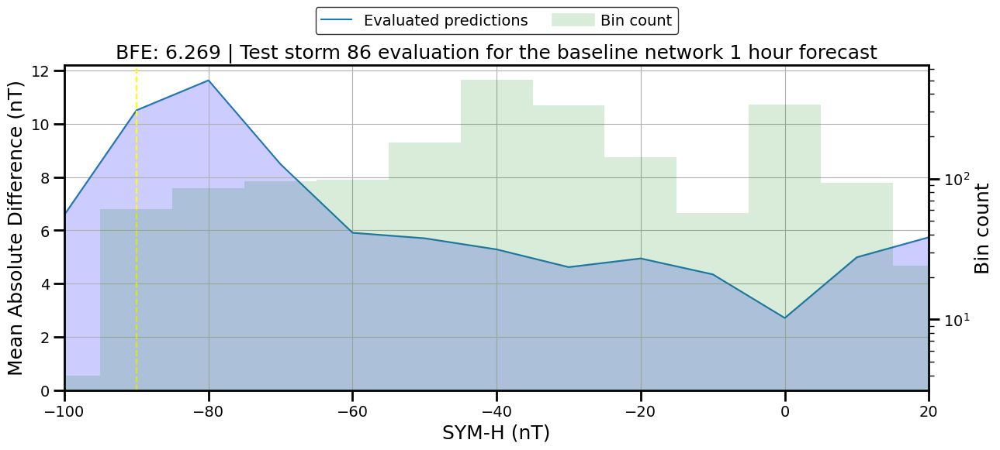

This network predicted_SYM_H --> rmse = 7.145 | r2 = 0.924 | BFE = 6.269
Test storm number 87, from 1999-04-15 00:00:00 until 1999-04-22 00:00:00, number of batches: 3168
From 1999-04-15 00:00:00 until 1999-04-22 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


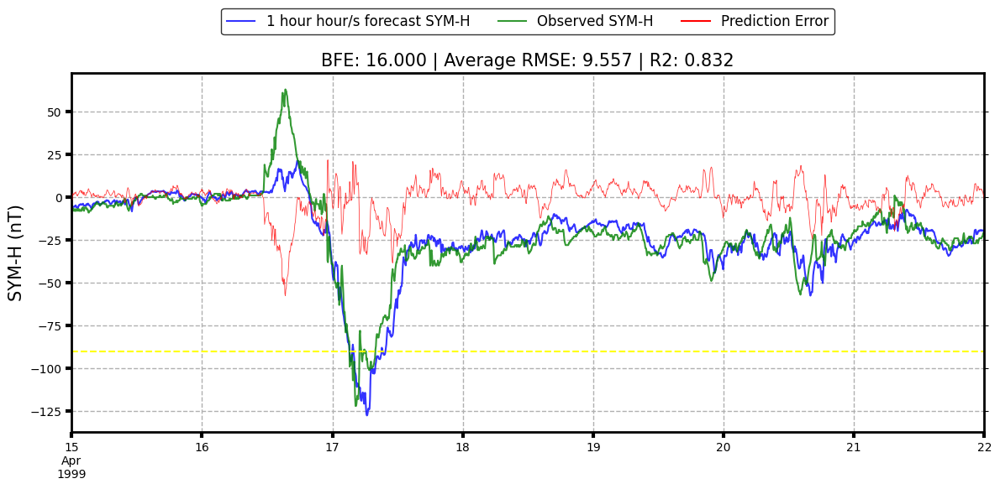

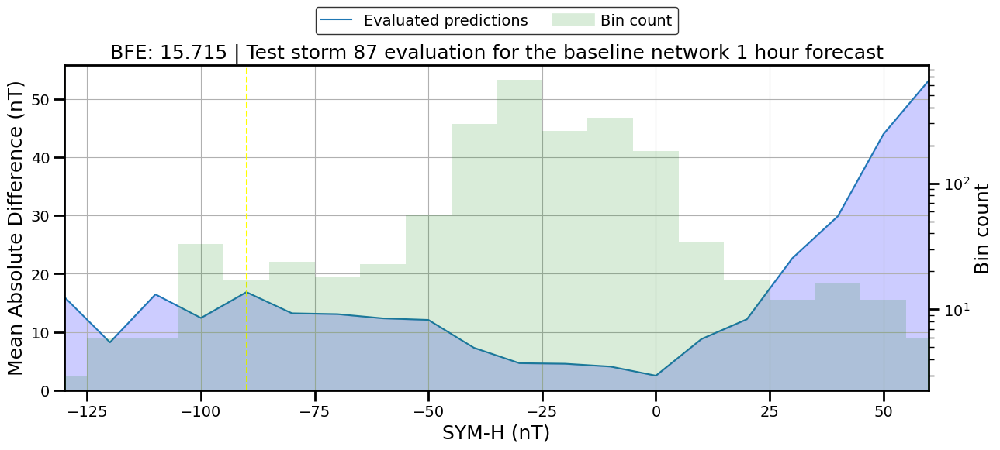

This network predicted_SYM_H --> rmse = 9.557 | r2 = 0.834 | BFE = 15.715
Test storm number 88, from 2000-01-21 00:00:00 until 2000-01-28 00:00:00, number of batches: 3168
From 2000-01-21 00:00:00 until 2000-01-28 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


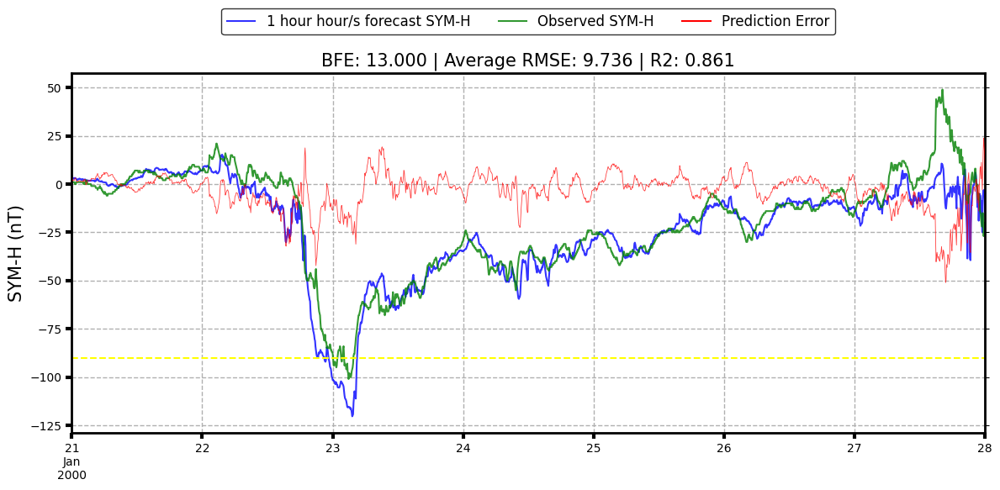

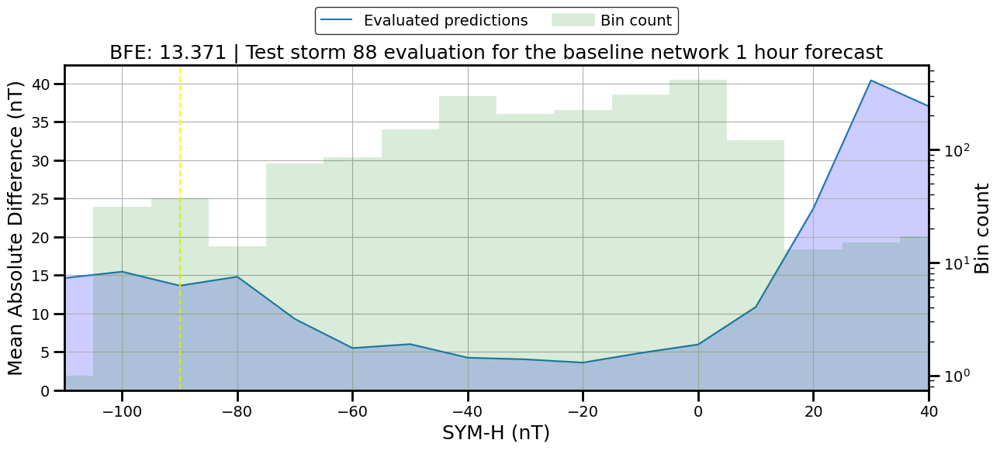

This network predicted_SYM_H --> rmse = 9.736 | r2 = 0.864 | BFE = 13.371
Test storm number 89, from 2000-04-04 00:00:00 until 2000-04-12 00:00:00, number of batches: 3457
From 2000-04-04 00:00:00 until 2000-04-12 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


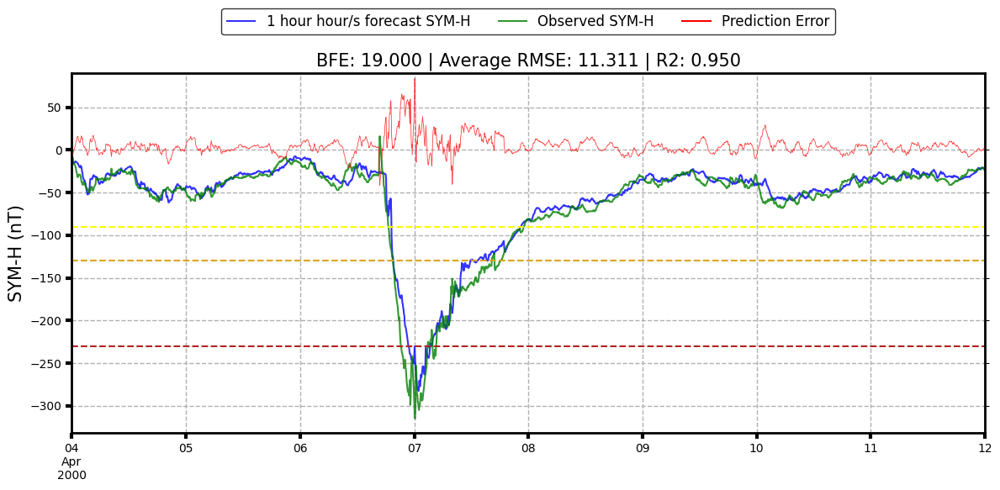

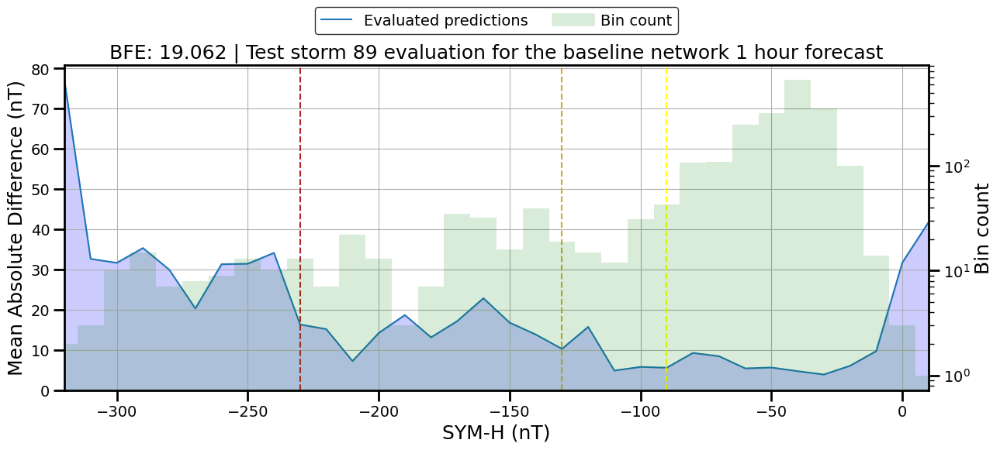

This network predicted_SYM_H --> rmse = 11.311 | r2 = 0.959 | BFE = 19.062
Test storm number 90, from 2000-05-15 00:00:00 until 2000-05-29 00:00:00, number of batches: 5184
From 2000-05-15 00:00:00 until 2000-05-29 00:00:00 shape: (4033, 2)
Metrics comparing SYM_H with predicted_SYM_H


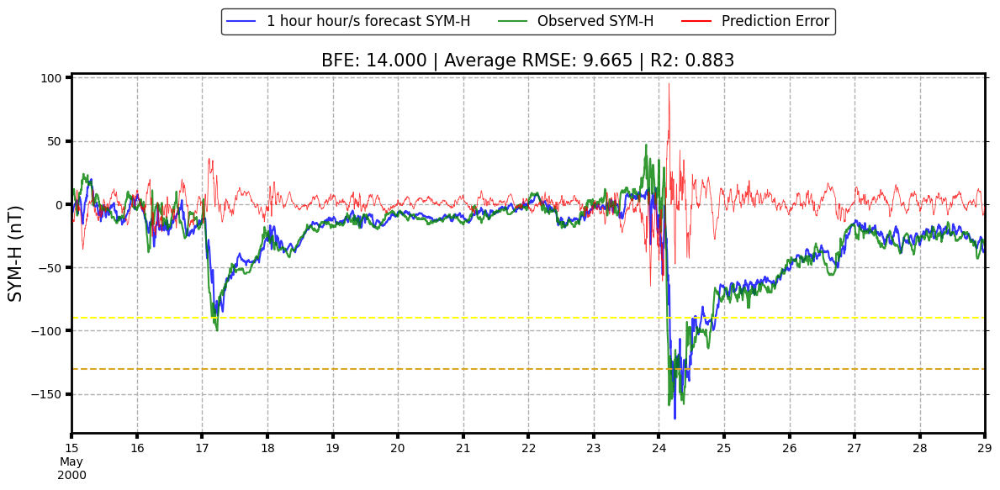

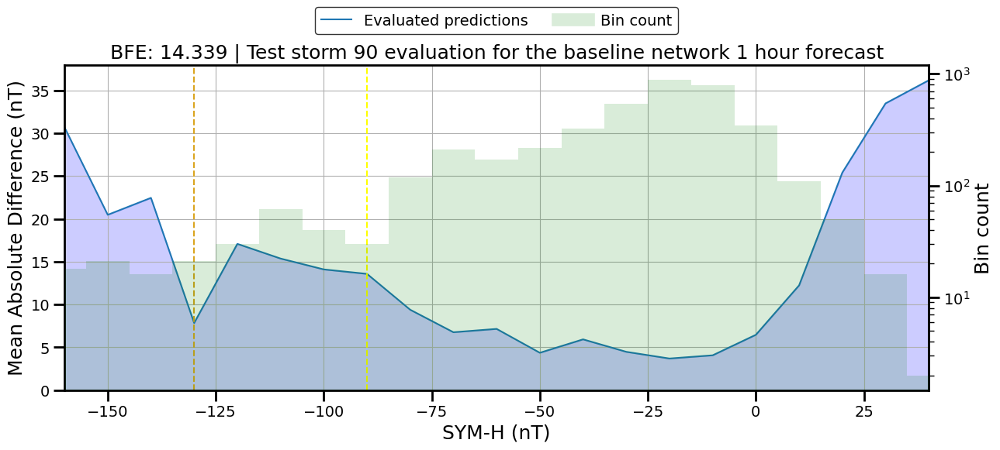

This network predicted_SYM_H --> rmse = 9.665 | r2 = 0.904 | BFE = 14.339
Test storm number 91, from 2001-03-29 00:00:00 until 2001-04-07 00:00:00, number of batches: 3744
From 2001-03-29 00:00:00 until 2001-04-07 00:00:00 shape: (2593, 2)
Metrics comparing SYM_H with predicted_SYM_H


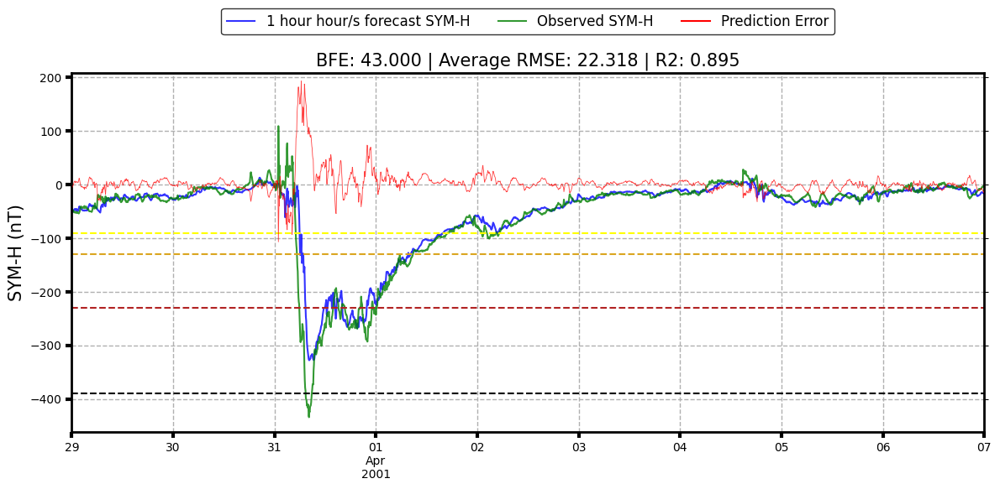

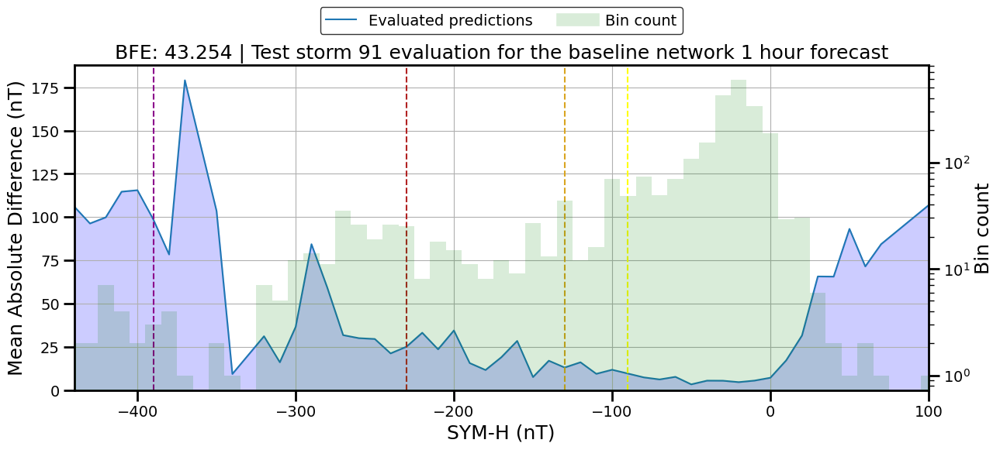

This network predicted_SYM_H --> rmse = 22.318 | r2 = 0.921 | BFE = 43.254
Test storm number 92, from 2001-08-15 00:00:00 until 2001-08-22 00:00:00, number of batches: 3168
From 2001-08-15 00:00:00 until 2001-08-22 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


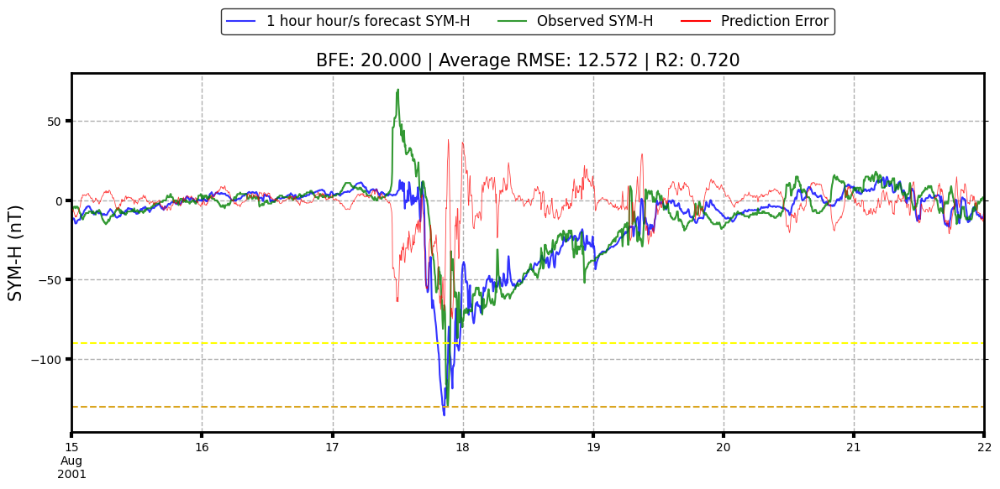

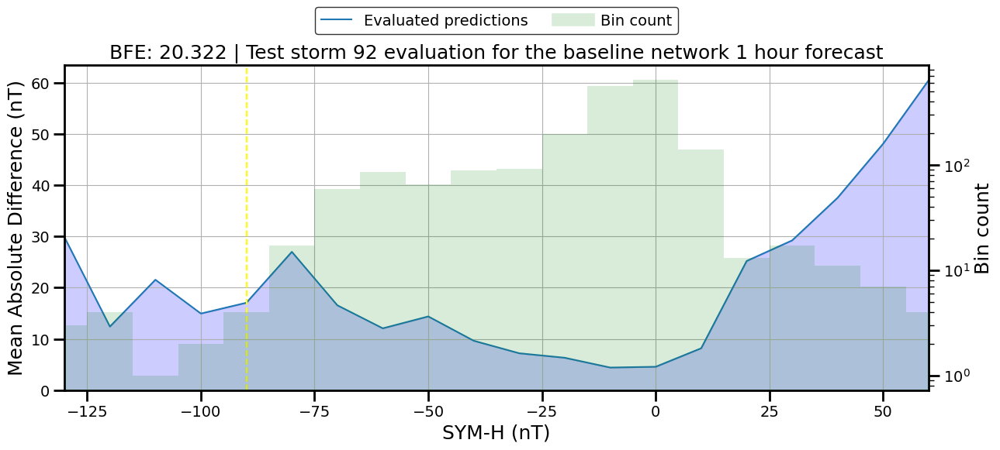

This network predicted_SYM_H --> rmse = 12.572 | r2 = 0.706 | BFE = 20.322
Test storm number 93, from 2002-01-31 00:00:00 until 2002-02-07 00:00:00, number of batches: 3168
From 2002-01-31 00:00:00 until 2002-02-07 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


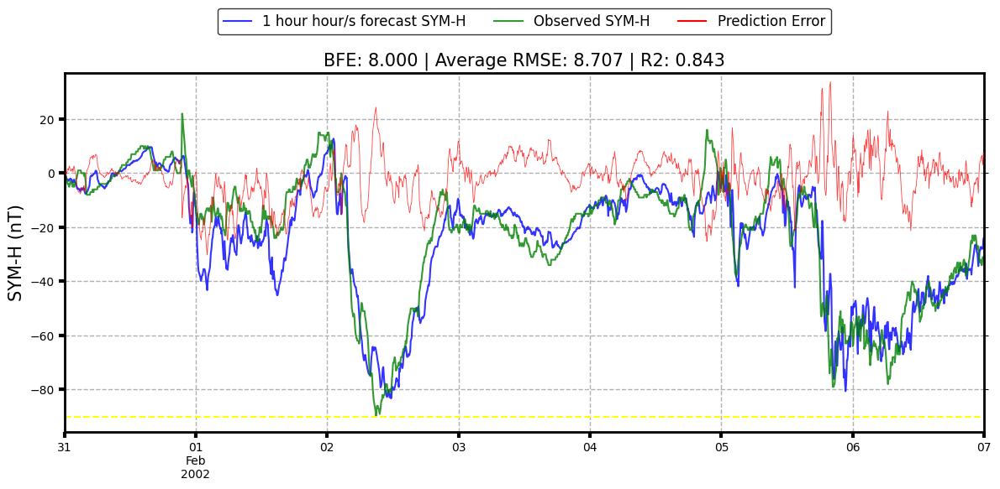

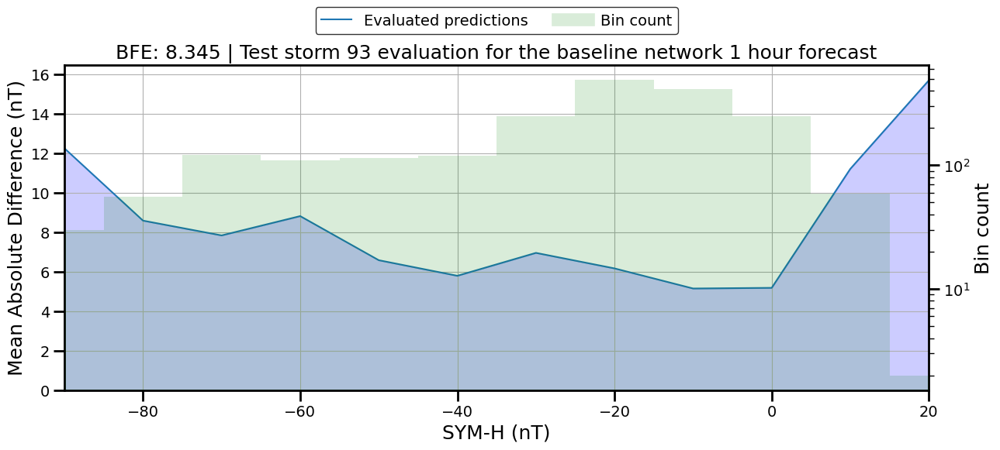

This network predicted_SYM_H --> rmse = 8.707 | r2 = 0.860 | BFE = 8.345
Test storm number 94, from 2002-03-22 00:00:00 until 2002-03-29 00:00:00, number of batches: 3168
From 2002-03-22 00:00:00 until 2002-03-29 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


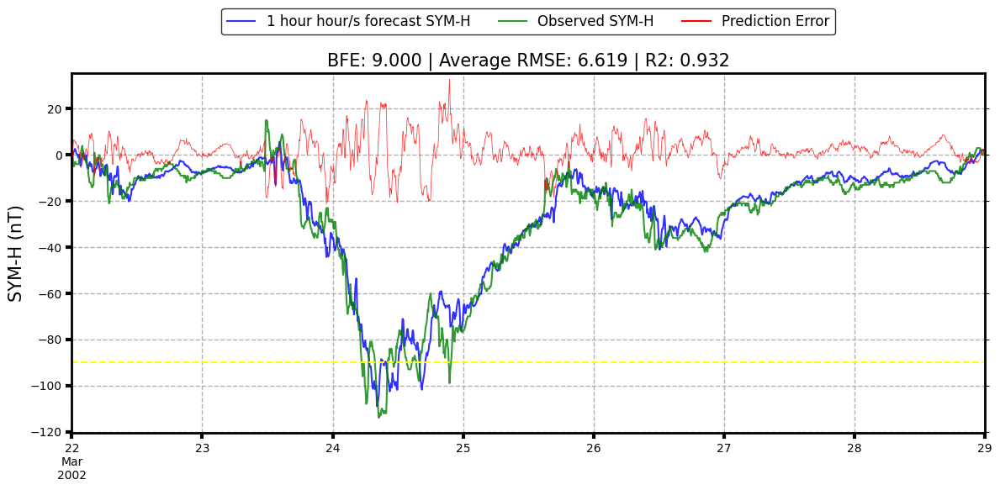

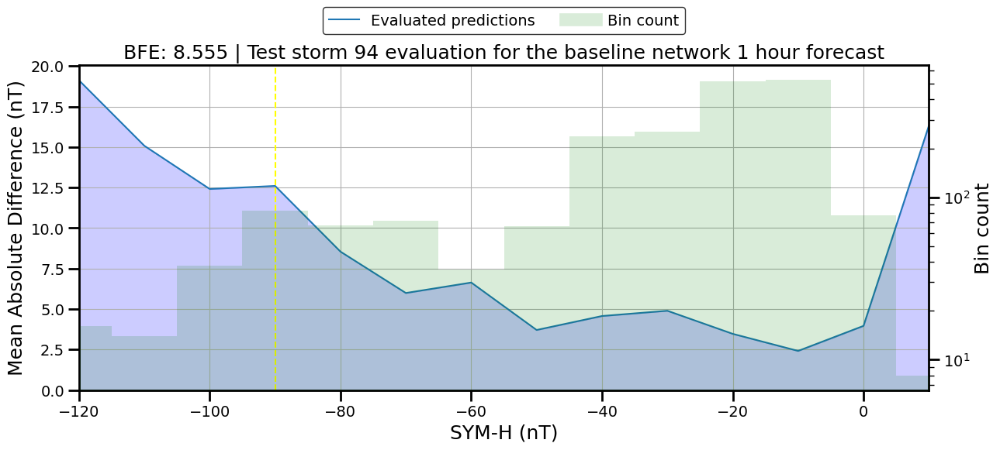

This network predicted_SYM_H --> rmse = 6.619 | r2 = 0.936 | BFE = 8.555
Test storm number 95, from 2002-09-02 00:00:00 until 2002-09-13 00:00:00, number of batches: 4320
From 2002-09-02 00:00:00 until 2002-09-13 00:00:00 shape: (3169, 2)
Metrics comparing SYM_H with predicted_SYM_H


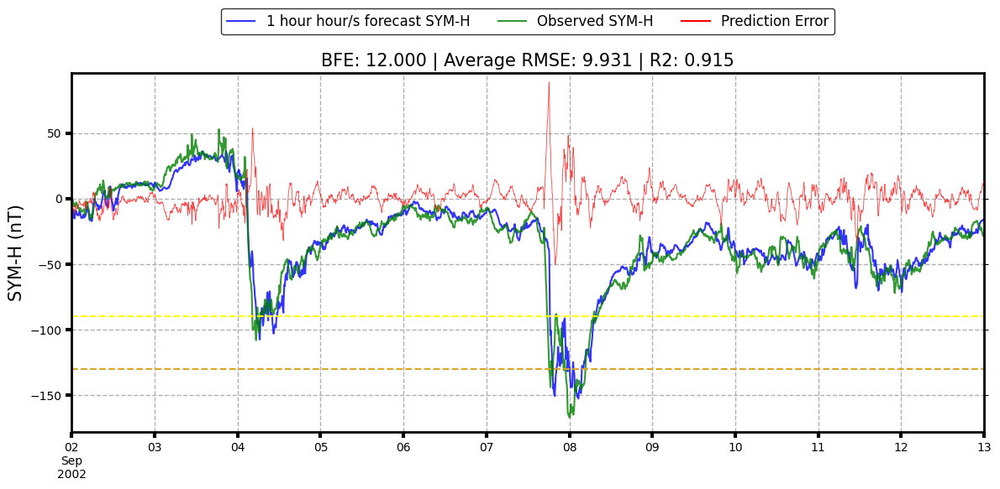

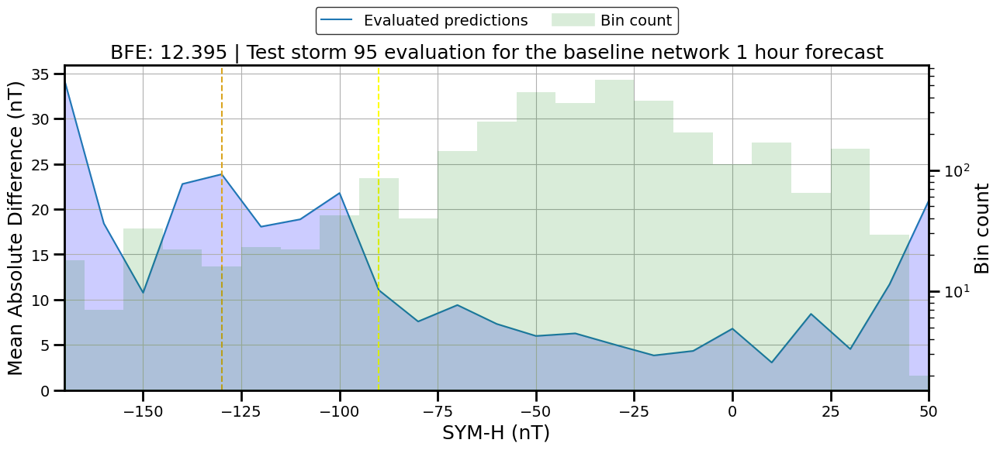

This network predicted_SYM_H --> rmse = 9.931 | r2 = 0.925 | BFE = 12.395
Test storm number 96, from 2003-05-27 00:00:00 until 2003-06-07 00:00:00, number of batches: 4320
From 2003-05-27 00:00:00 until 2003-06-07 00:00:00 shape: (3169, 2)
Metrics comparing SYM_H with predicted_SYM_H


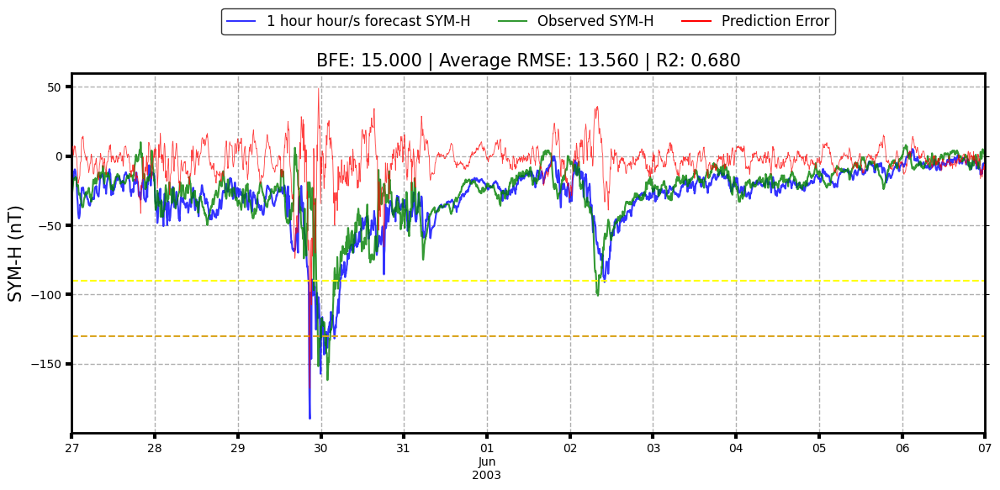

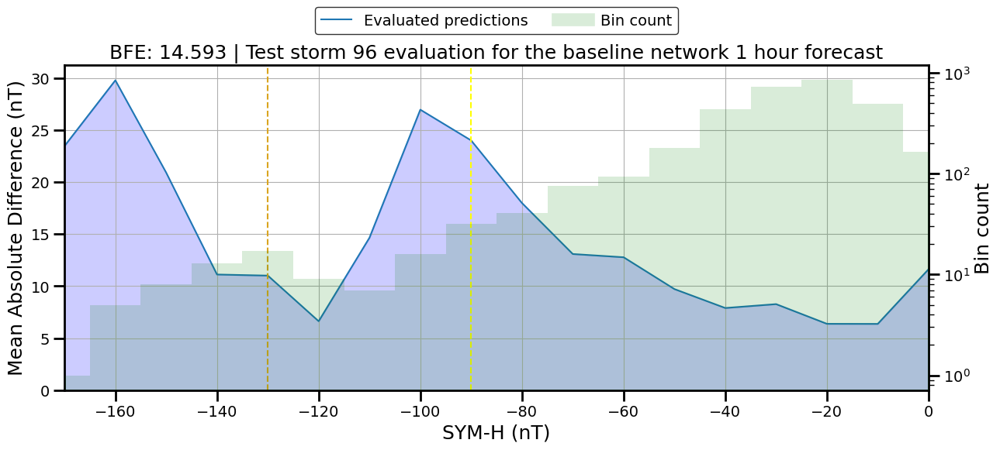

This network predicted_SYM_H --> rmse = 13.560 | r2 = 0.651 | BFE = 14.593
Test storm number 97, from 2003-06-15 00:00:00 until 2003-06-23 00:00:00, number of batches: 3456
From 2003-06-15 00:00:00 until 2003-06-23 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


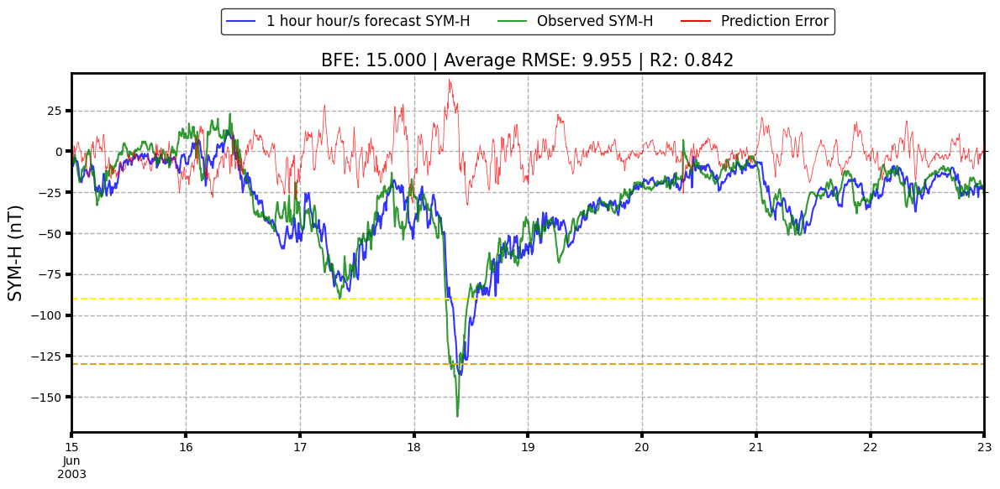

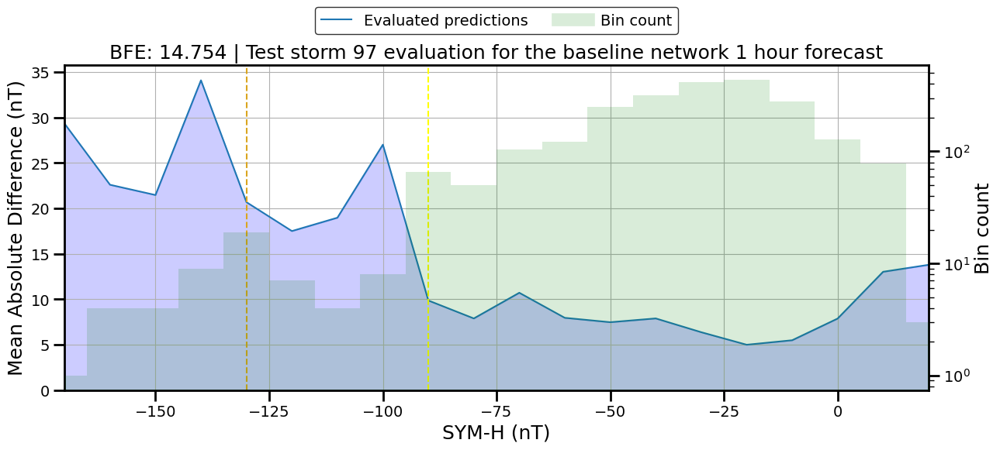

This network predicted_SYM_H --> rmse = 9.955 | r2 = 0.863 | BFE = 14.754
Test storm number 98, from 2003-07-10 00:00:00 until 2003-07-21 00:00:00, number of batches: 4320
From 2003-07-10 00:00:00 until 2003-07-21 00:00:00 shape: (3169, 2)
Metrics comparing SYM_H with predicted_SYM_H


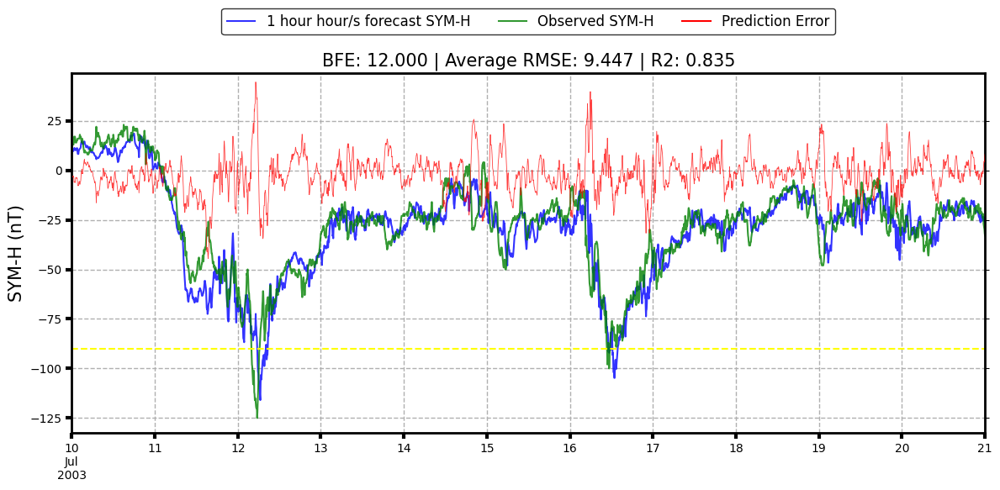

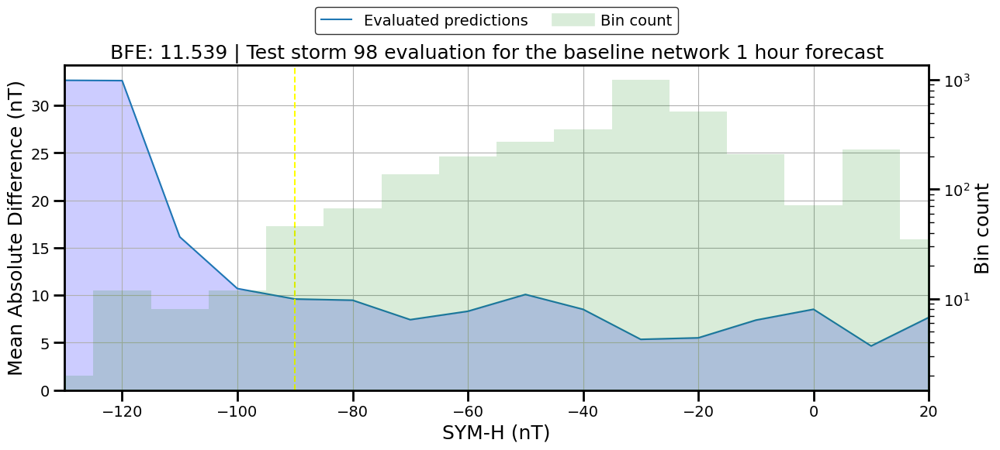

This network predicted_SYM_H --> rmse = 9.447 | r2 = 0.835 | BFE = 11.539
Test storm number 99, from 2004-01-20 00:00:00 until 2004-01-27 00:00:00, number of batches: 3168
From 2004-01-20 00:00:00 until 2004-01-27 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


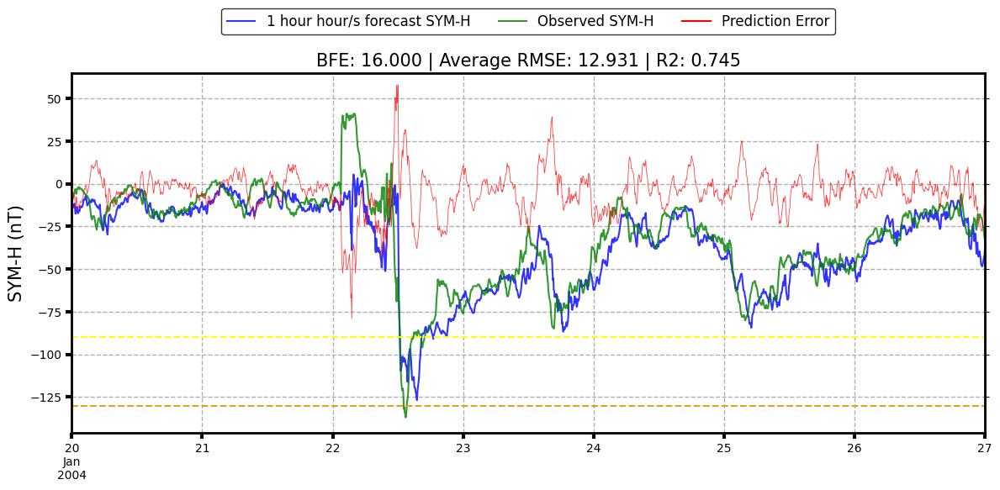

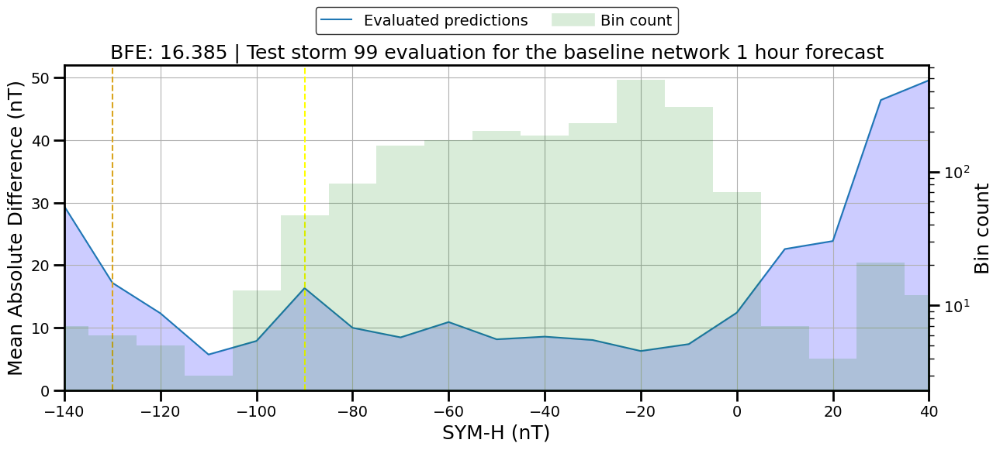

This network predicted_SYM_H --> rmse = 12.931 | r2 = 0.770 | BFE = 16.385
Test storm number 100, from 2004-02-09 00:00:00 until 2004-02-16 00:00:00, number of batches: 3168
From 2004-02-09 00:00:00 until 2004-02-16 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


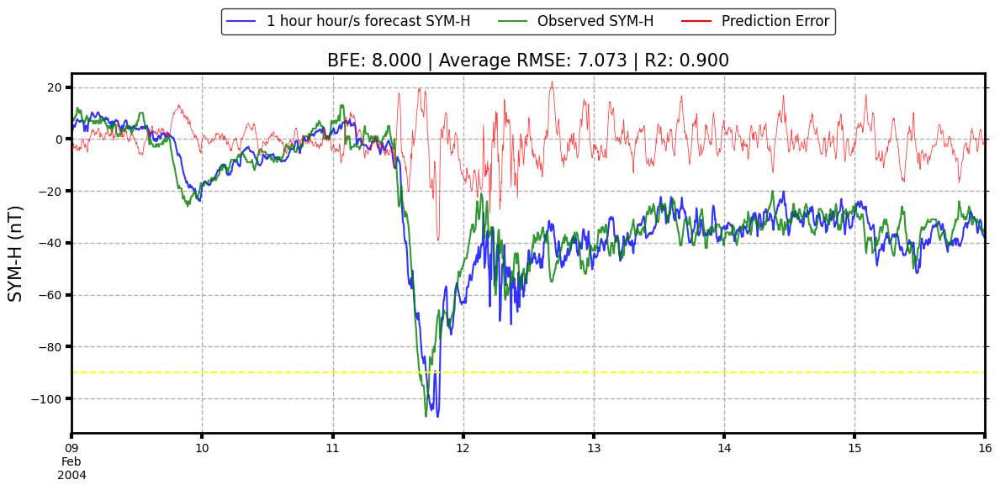

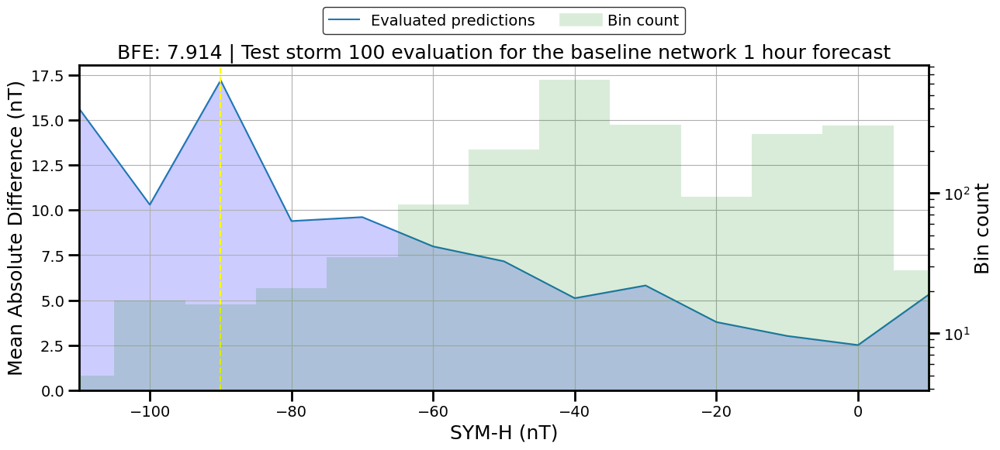

This network predicted_SYM_H --> rmse = 7.073 | r2 = 0.890 | BFE = 7.914
Test storm number 101, from 2004-11-05 00:00:00 until 2004-11-17 00:00:00, number of batches: 4608
From 2004-11-05 00:00:00 until 2004-11-17 00:00:00 shape: (3457, 2)
Metrics comparing SYM_H with predicted_SYM_H


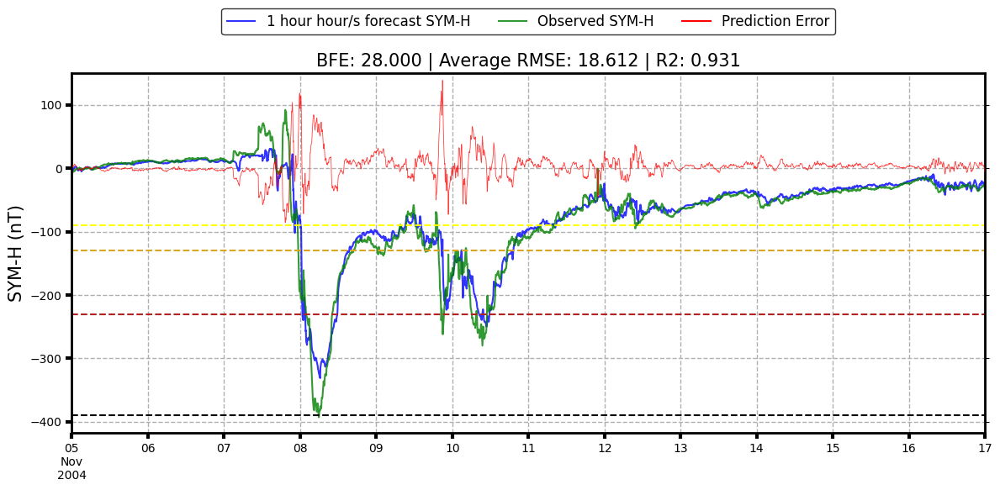

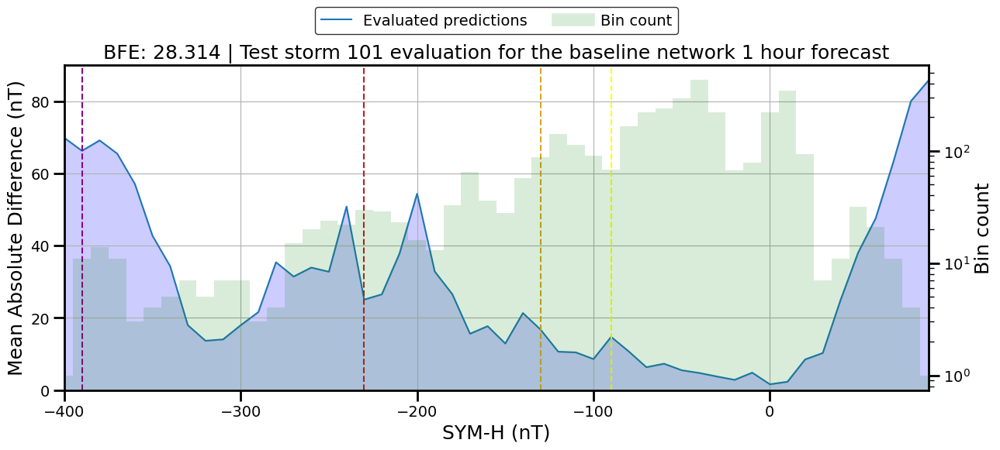

This network predicted_SYM_H --> rmse = 18.612 | r2 = 0.943 | BFE = 28.314
Test storm number 102, from 2005-01-05 00:00:00 until 2005-01-13 00:00:00, number of batches: 3456
From 2005-01-05 00:00:00 until 2005-01-13 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


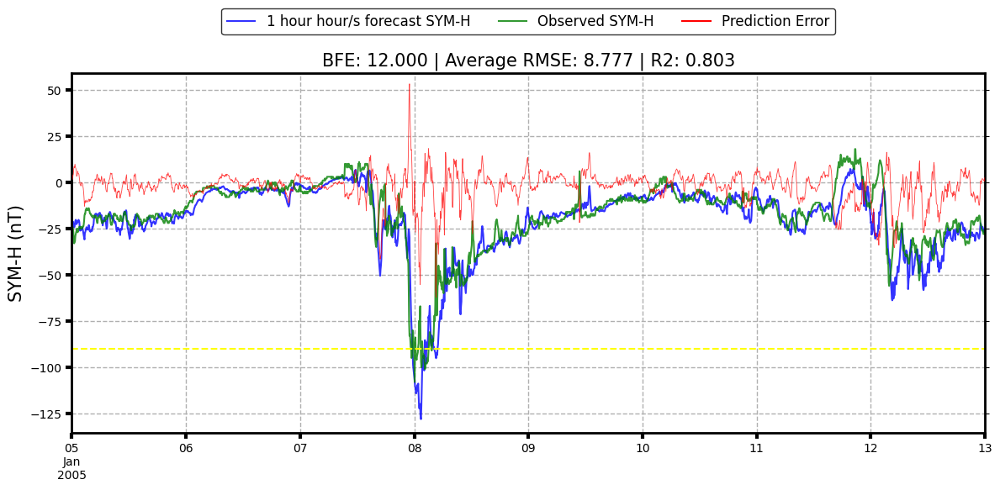

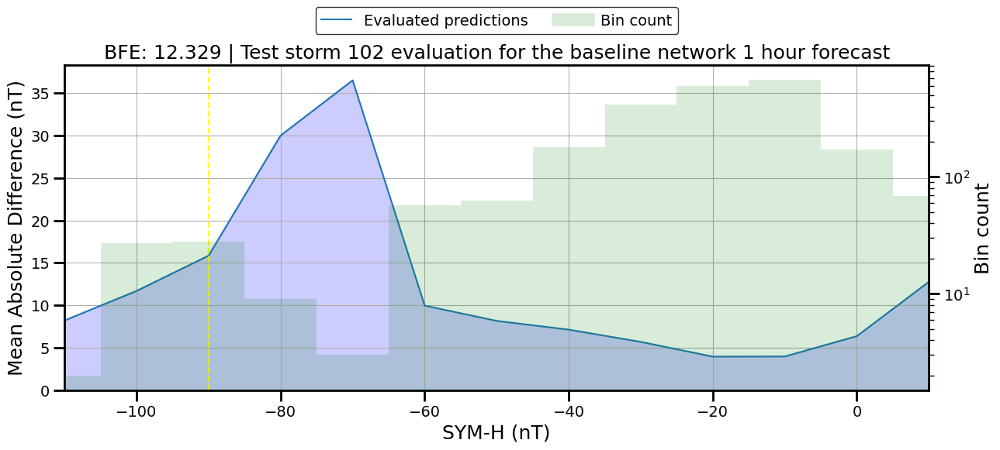

This network predicted_SYM_H --> rmse = 8.777 | r2 = 0.775 | BFE = 12.329
Test storm number 103, from 2005-06-10 00:00:00 until 2005-06-18 00:00:00, number of batches: 3456
From 2005-06-10 00:00:00 until 2005-06-18 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


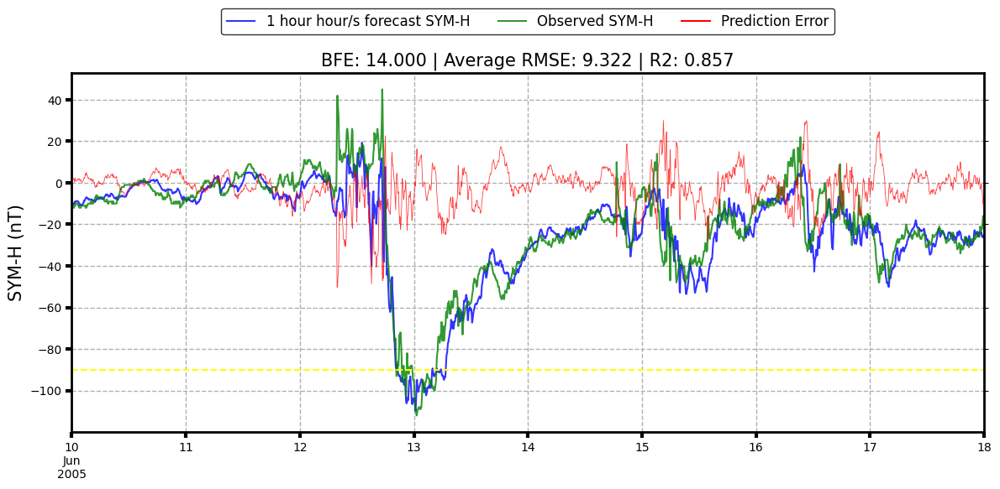

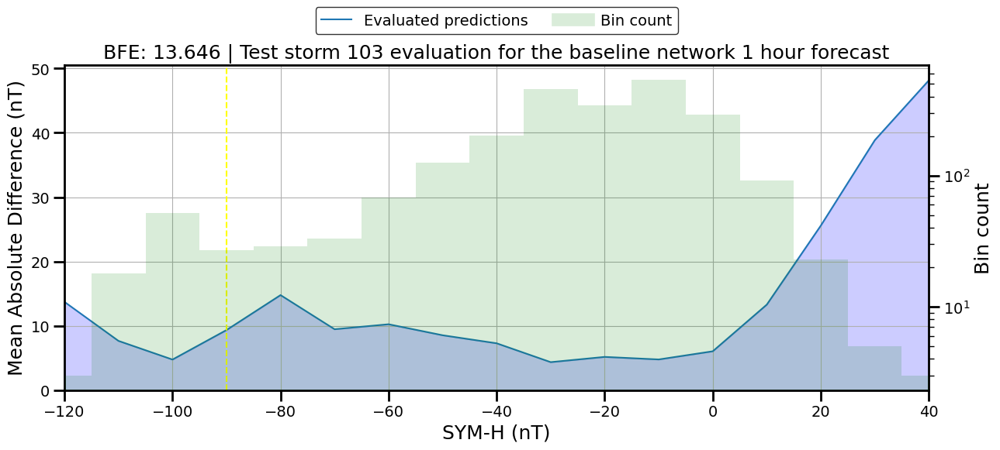

This network predicted_SYM_H --> rmse = 9.322 | r2 = 0.861 | BFE = 13.646
Test storm number 104, from 2005-06-21 00:00:00 until 2005-06-28 00:00:00, number of batches: 3168
From 2005-06-21 00:00:00 until 2005-06-28 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


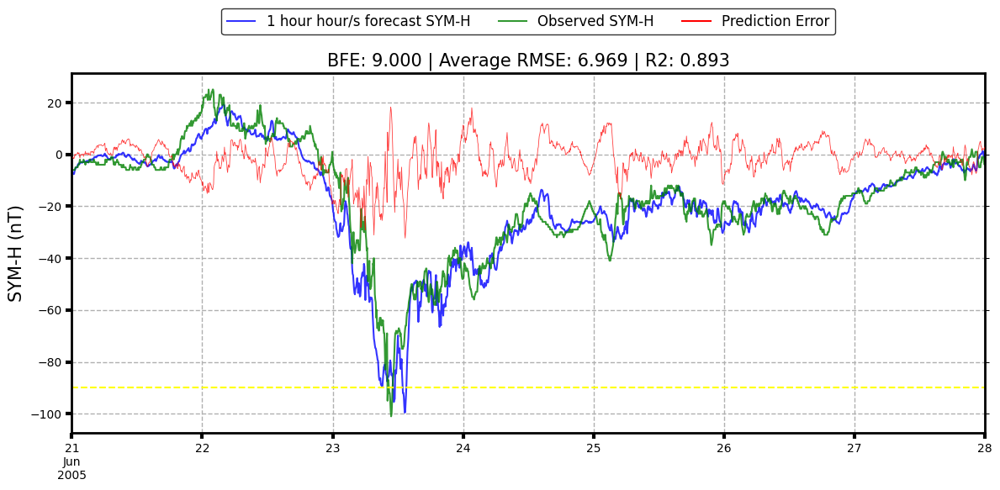

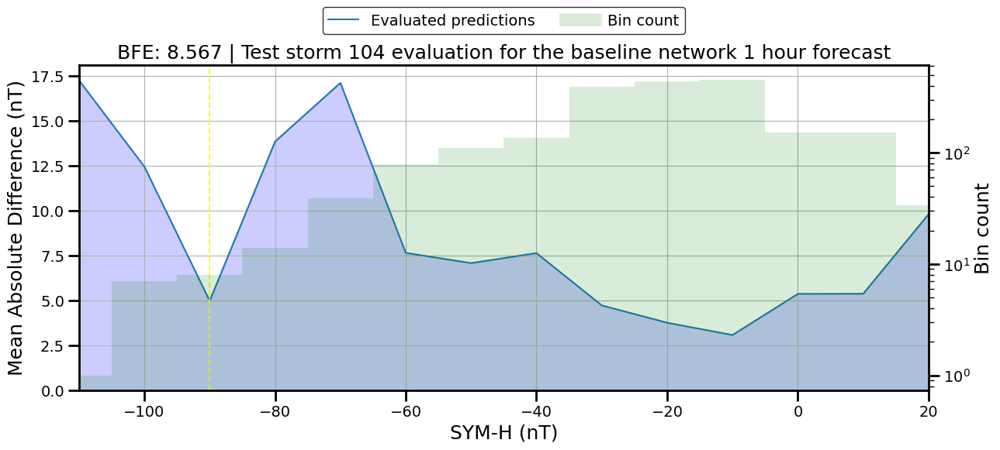

This network predicted_SYM_H --> rmse = 6.969 | r2 = 0.884 | BFE = 8.567
Test storm number 105, from 2006-08-18 00:00:00 until 2006-08-25 00:00:00, number of batches: 3168
From 2006-08-18 00:00:00 until 2006-08-25 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


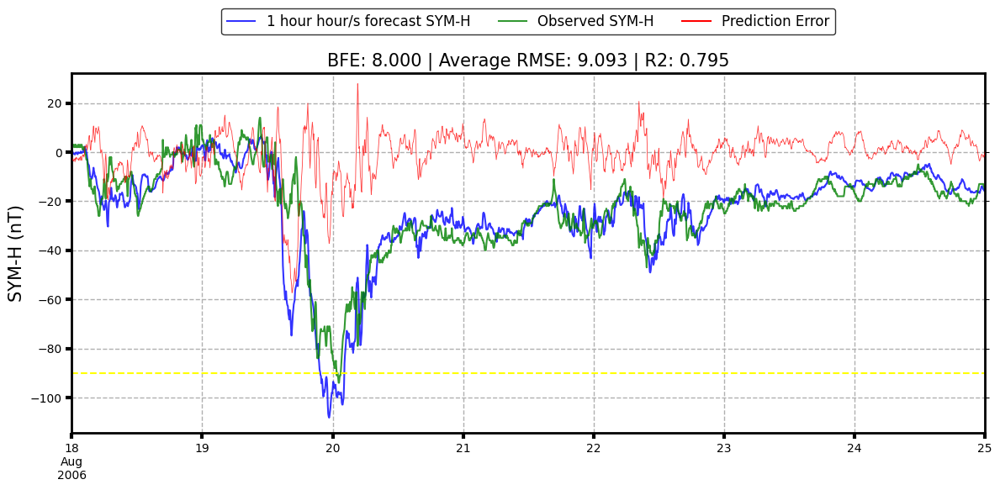

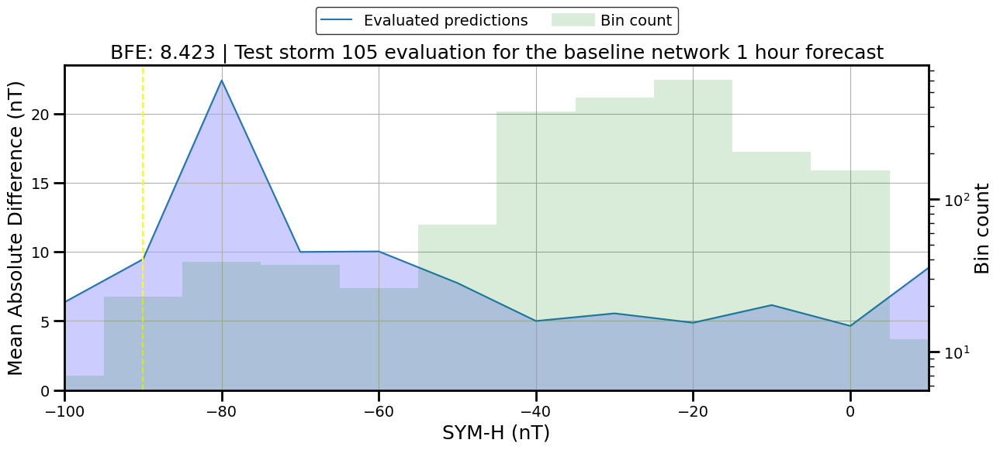

This network predicted_SYM_H --> rmse = 9.093 | r2 = 0.732 | BFE = 8.423
Test storm number 106, from 2008-03-07 00:00:00 until 2008-03-14 00:00:00, number of batches: 3168
From 2008-03-07 00:00:00 until 2008-03-14 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


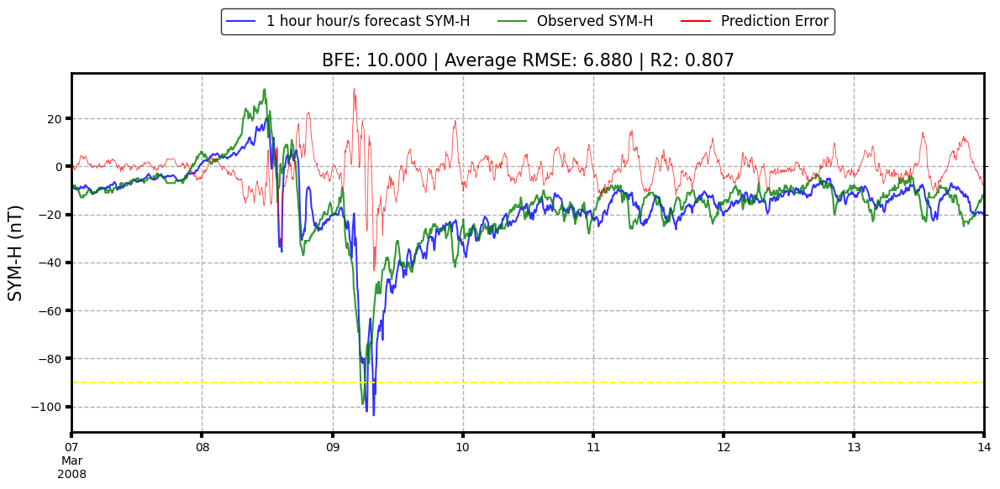

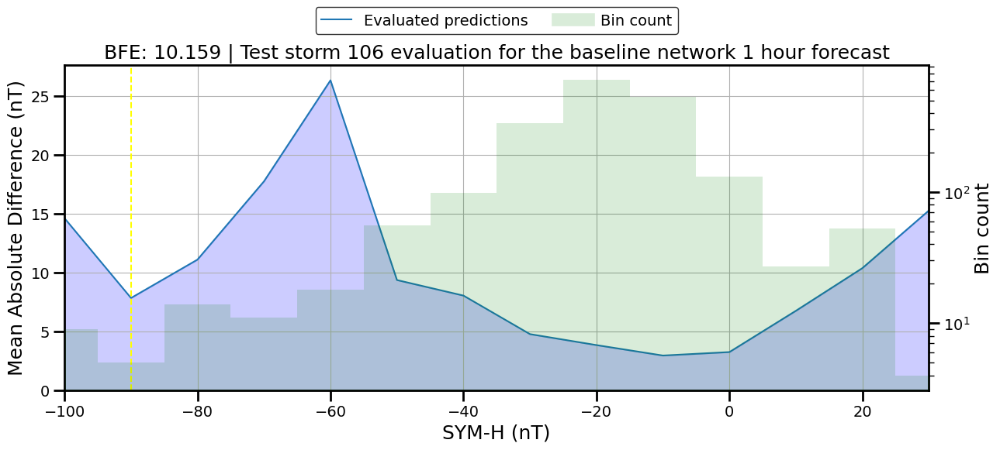

This network predicted_SYM_H --> rmse = 6.880 | r2 = 0.810 | BFE = 10.159
Test storm number 107, from 2011-08-03 00:00:00 until 2011-08-11 00:00:00, number of batches: 3457
From 2011-08-03 00:00:00 until 2011-08-11 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


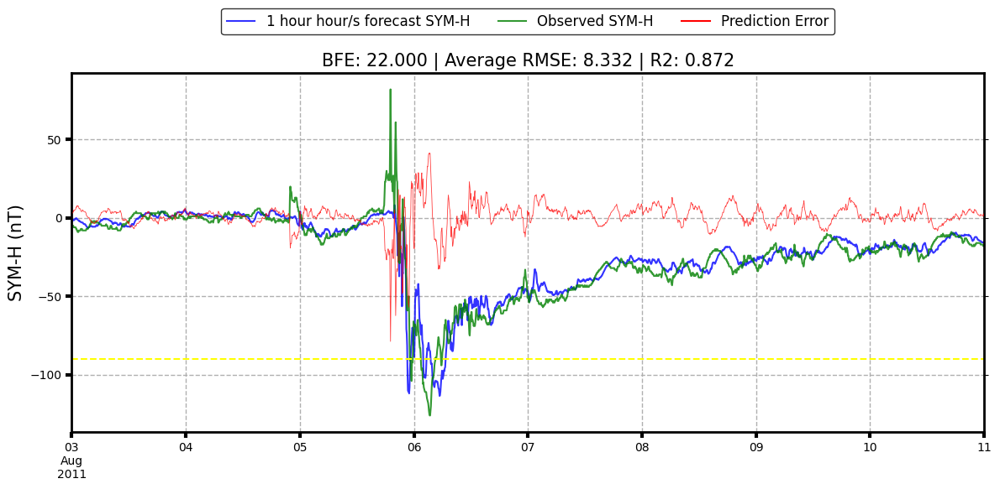

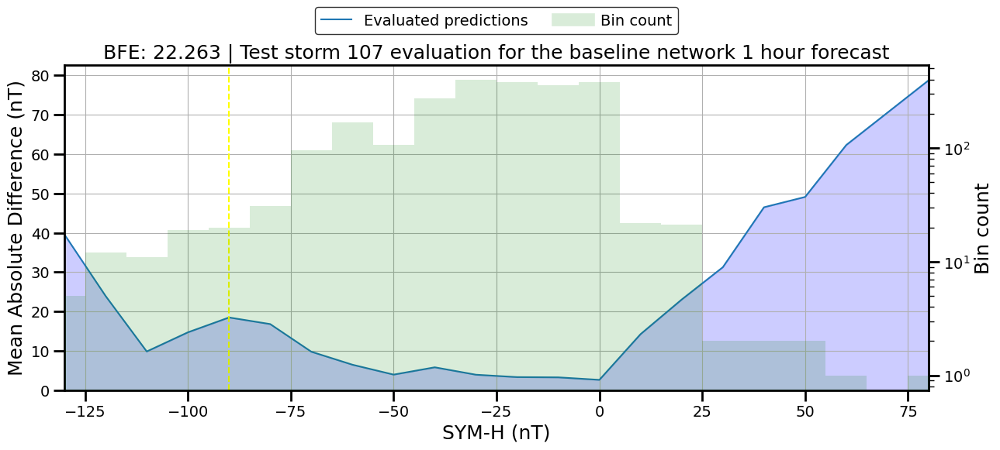

This network predicted_SYM_H --> rmse = 8.332 | r2 = 0.888 | BFE = 22.263
Test storm number 108, from 2011-10-22 00:00:00 until 2011-10-30 00:00:00, number of batches: 3456
From 2011-10-22 00:00:00 until 2011-10-30 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


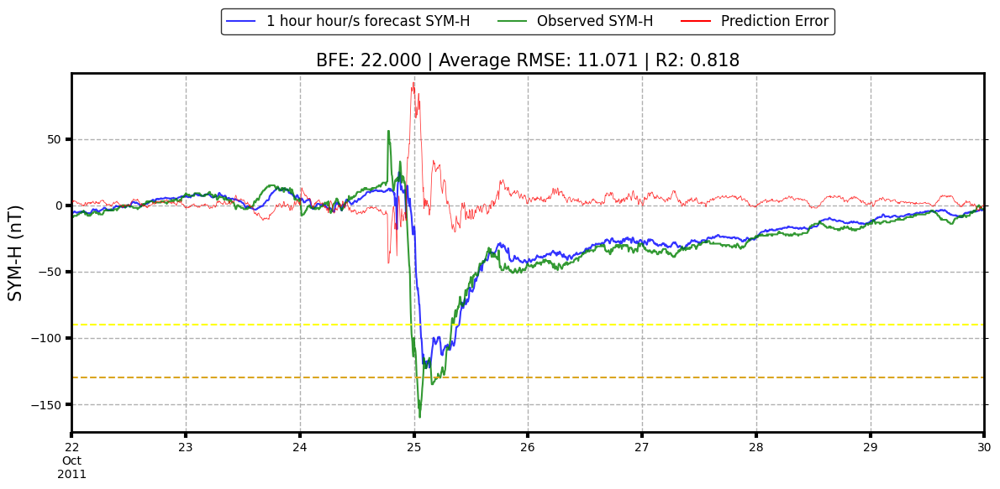

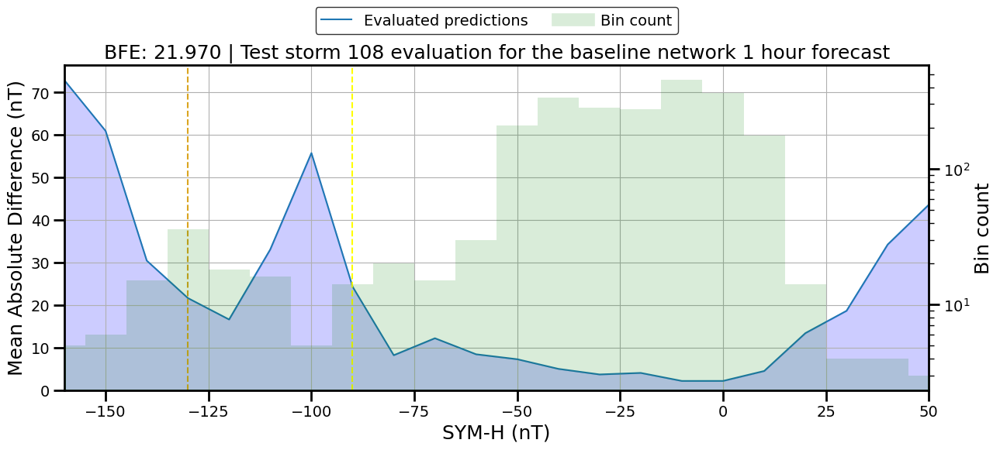

This network predicted_SYM_H --> rmse = 11.071 | r2 = 0.867 | BFE = 21.970
Test storm number 109, from 2012-07-13 00:00:00 until 2012-07-21 00:00:00, number of batches: 3456
From 2012-07-13 00:00:00 until 2012-07-21 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


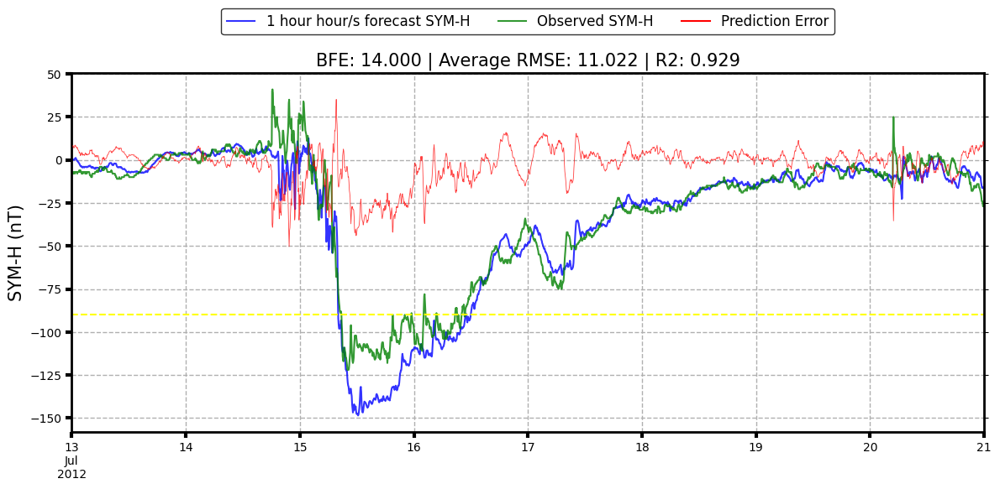

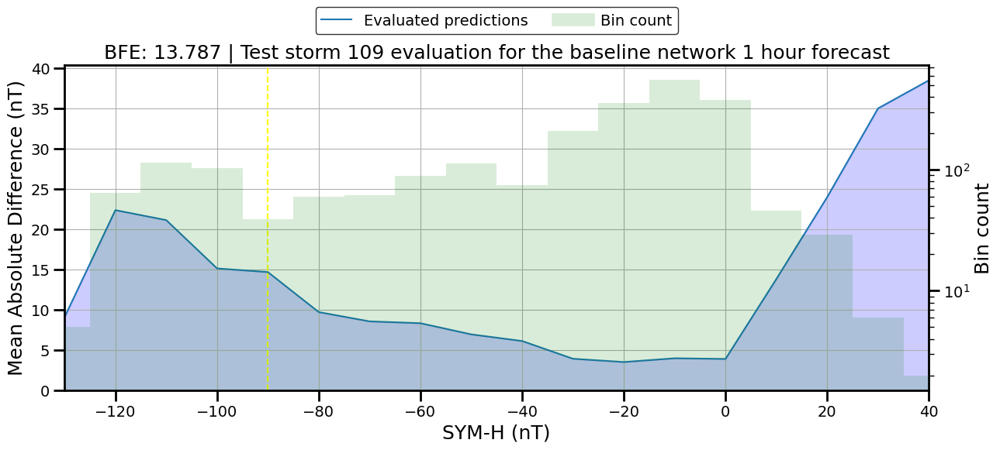

This network predicted_SYM_H --> rmse = 11.022 | r2 = 0.908 | BFE = 13.787
Test storm number 110, from 2012-09-29 00:00:00 until 2012-10-18 00:00:00, number of batches: 6624
From 2012-09-29 00:00:00 until 2012-10-18 00:00:00 shape: (5473, 2)
Metrics comparing SYM_H with predicted_SYM_H


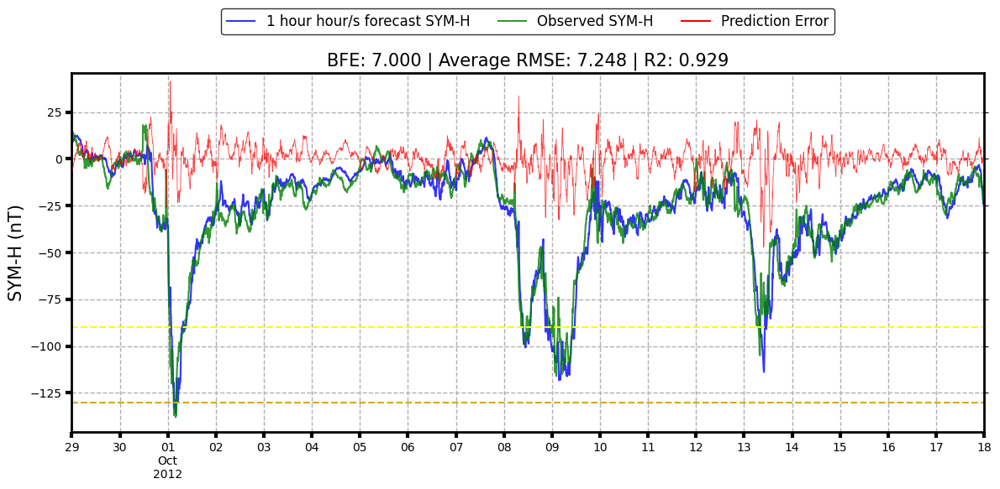

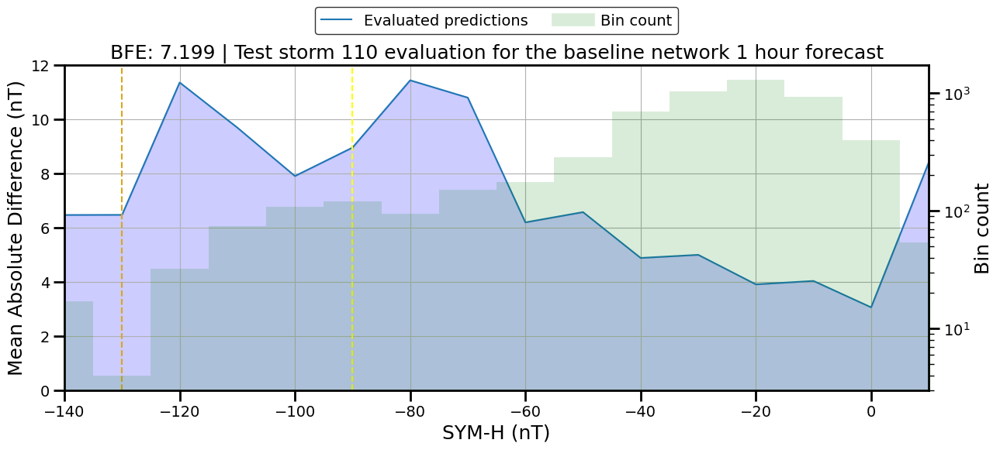

This network predicted_SYM_H --> rmse = 7.248 | r2 = 0.922 | BFE = 7.199
Test storm number 111, from 2013-05-30 00:00:00 until 2013-06-06 00:00:00, number of batches: 3168
From 2013-05-30 00:00:00 until 2013-06-06 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


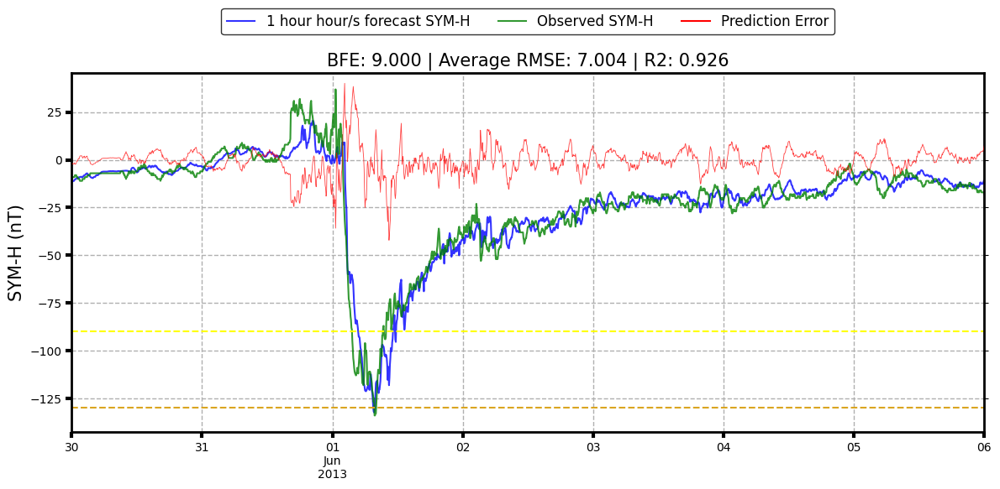

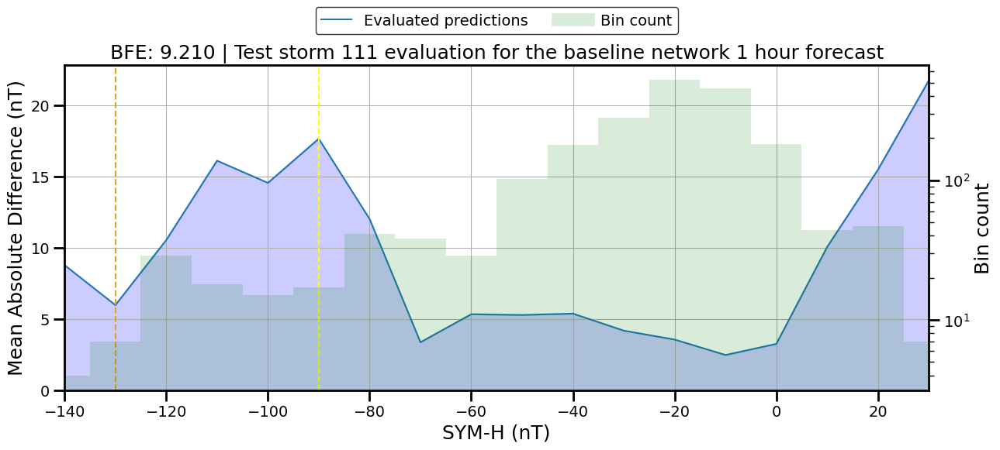

This network predicted_SYM_H --> rmse = 7.004 | r2 = 0.929 | BFE = 9.210
Test storm number 112, from 2013-06-27 00:00:00 until 2013-07-04 00:00:00, number of batches: 3169
From 2013-06-27 00:00:00 until 2013-07-04 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


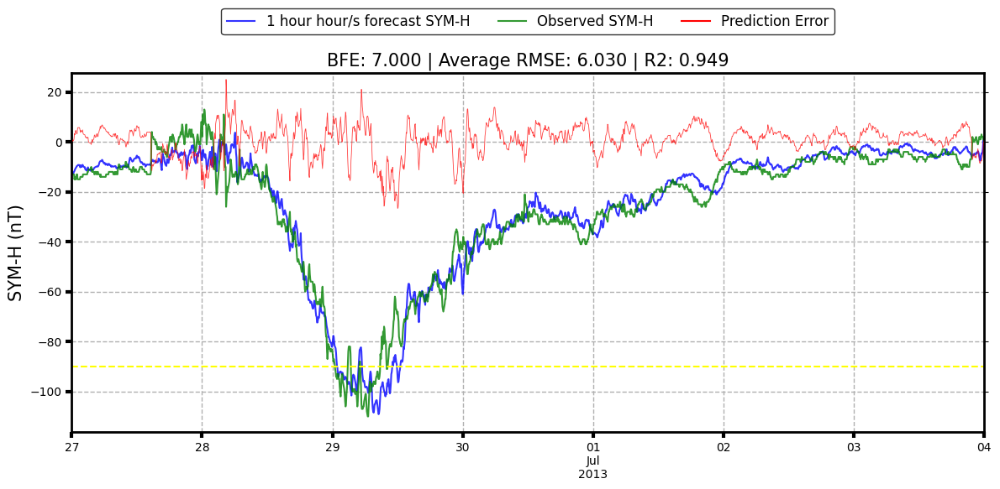

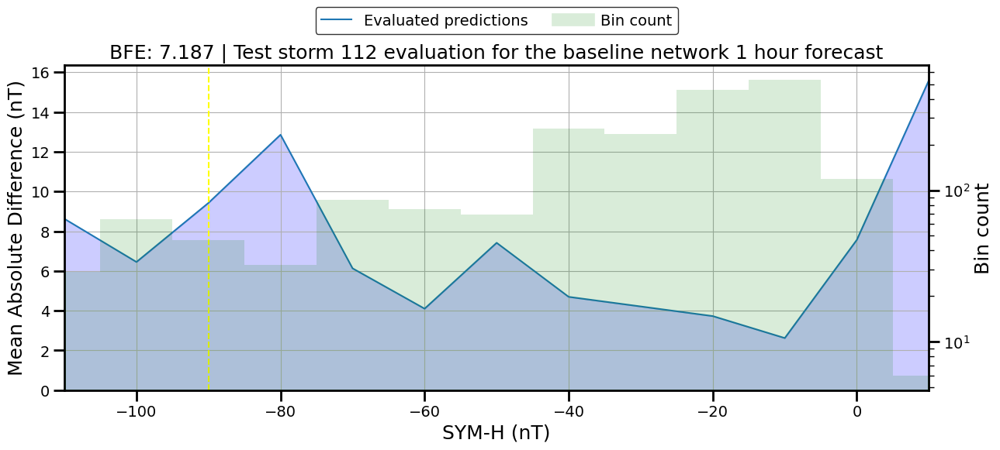

This network predicted_SYM_H --> rmse = 6.030 | r2 = 0.946 | BFE = 7.187
Test storm number 113, from 2014-09-10 00:00:00 until 2014-09-17 00:00:00, number of batches: 3168
From 2014-09-10 00:00:00 until 2014-09-17 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


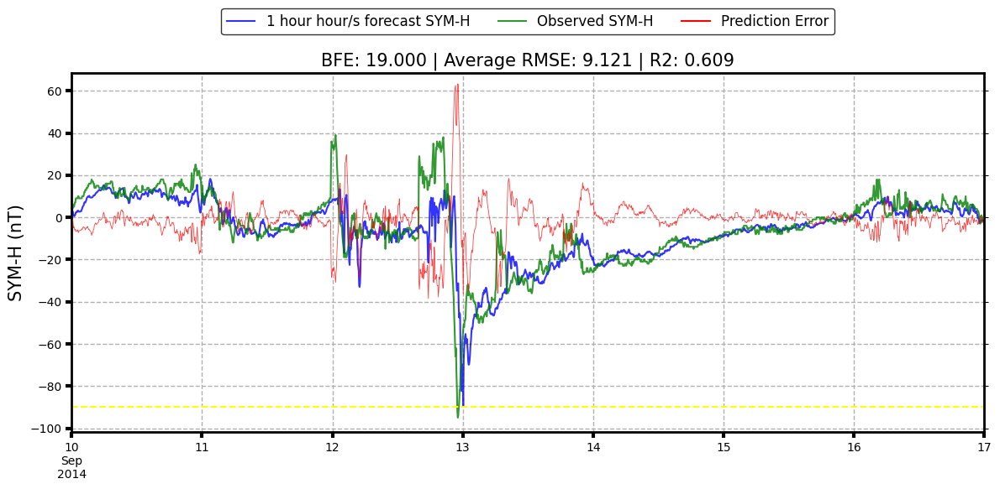

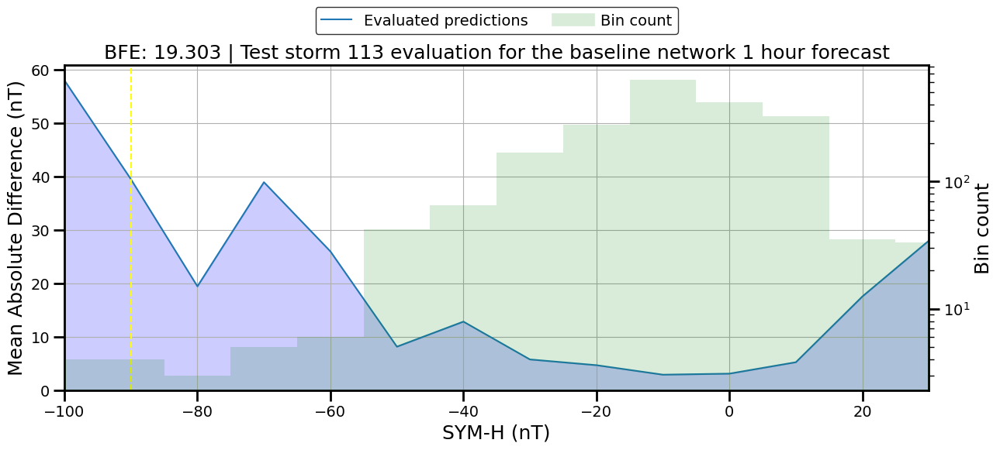

This network predicted_SYM_H --> rmse = 9.121 | r2 = 0.704 | BFE = 19.303
Test storm number 114, from 2015-03-15 00:00:00 until 2015-03-23 00:00:00, number of batches: 3456
From 2015-03-15 00:00:00 until 2015-03-23 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


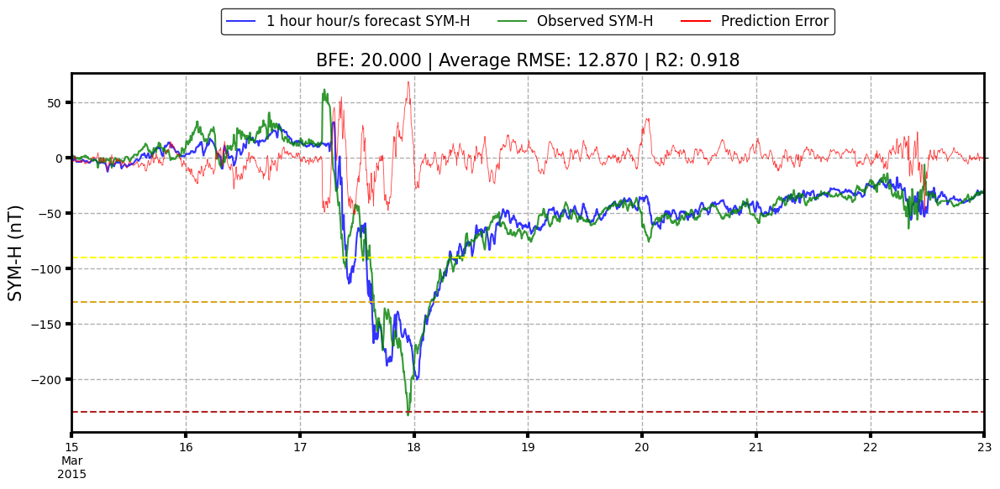

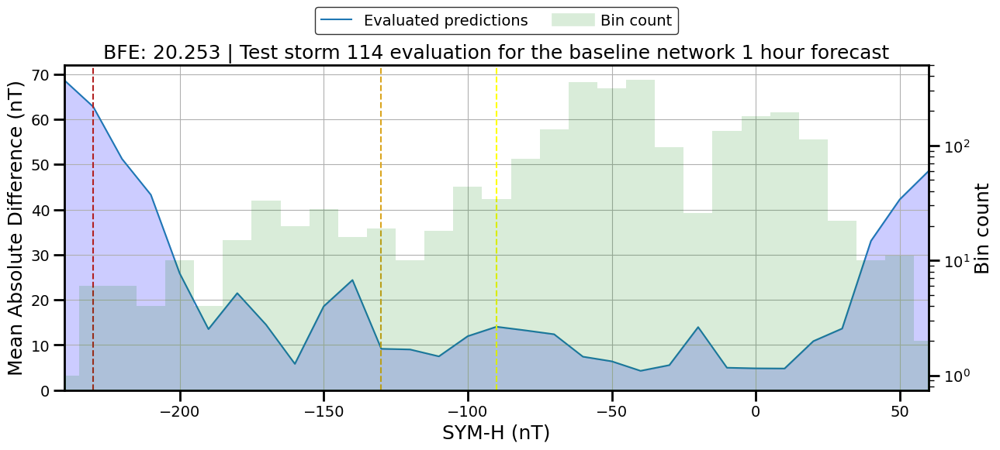

This network predicted_SYM_H --> rmse = 12.870 | r2 = 0.924 | BFE = 20.253
Test storm number 115, from 2015-06-06 00:00:00 until 2015-06-13 00:00:00, number of batches: 3168
From 2015-06-06 00:00:00 until 2015-06-13 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


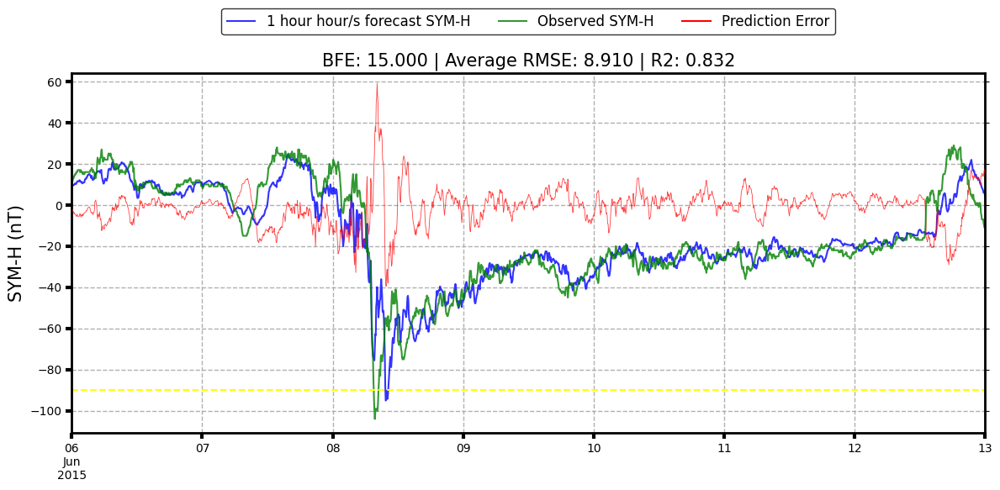

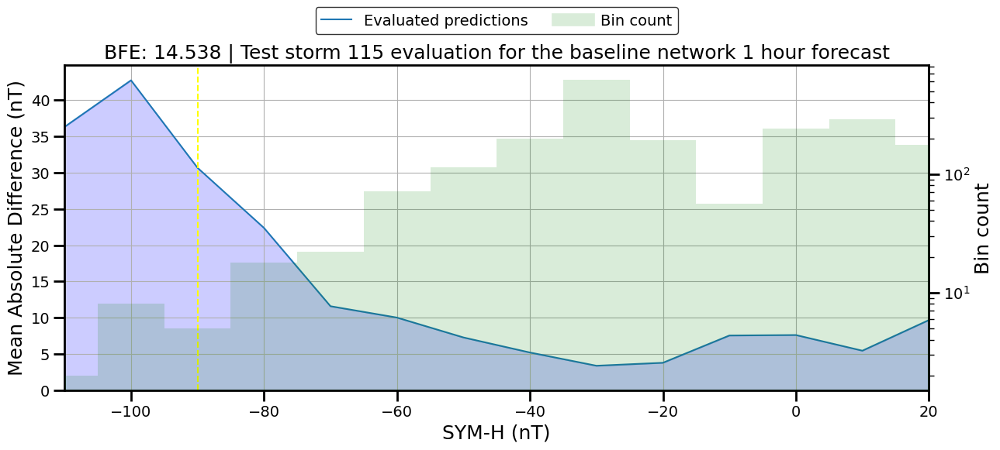

This network predicted_SYM_H --> rmse = 8.910 | r2 = 0.865 | BFE = 14.538
Test storm number 116, from 2015-09-06 00:00:00 until 2015-09-16 00:00:00, number of batches: 4032
From 2015-09-06 00:00:00 until 2015-09-16 00:00:00 shape: (2881, 2)
Metrics comparing SYM_H with predicted_SYM_H


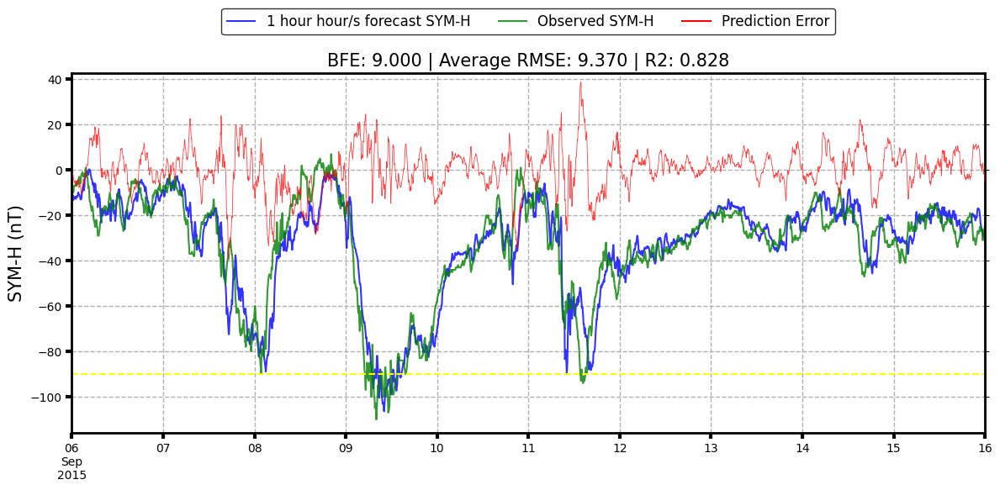

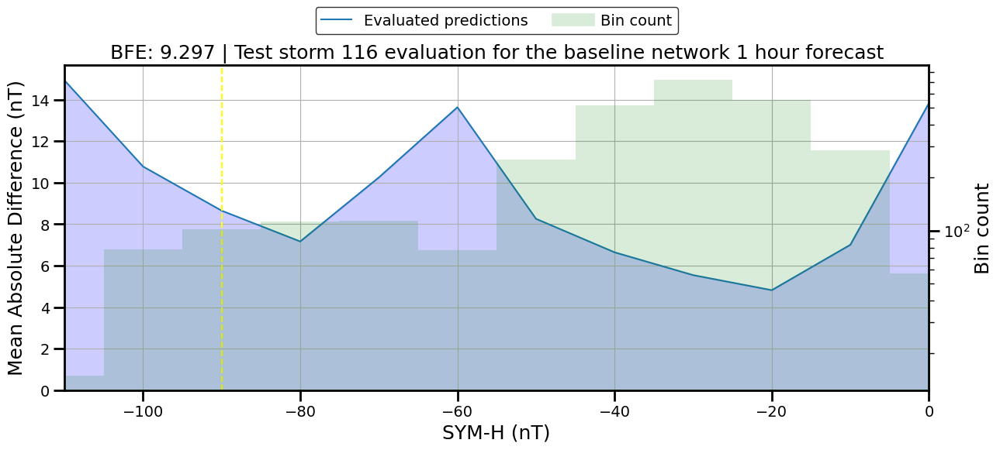

This network predicted_SYM_H --> rmse = 9.370 | r2 = 0.835 | BFE = 9.297


,StormIndex,Network BFE,Network RMSE,Network R2
0,81,14.013000,9.133000,0.794
1,82,16.455000,11.555000,0.916
2,83,9.815000,10.211000,0.869
3,84,17.195999,13.555000,0.858
4,85,8.102000,5.895000,0.946
5,86,6.269000,7.145000,0.924
6,87,15.715000,9.557000,0.834
7,88,13.371000,9.736000,0.864
8,89,19.062000,11.311000,0.959
9,90,14.339000,9.665000,0.904


In [16]:
if RETRAIN:
    model.load_weights(checkpoint_filepath)
else:
    model = tf.keras.models.load_model('./prediction_models/baseline_model_2h')

start_index_storm = len(storm_dates.TRAIN_STORMS) + len(storm_dates.VALIDATION_STORMS) + 1

summary_columns = ["StormIndex",f"Network BFE", "Network RMSE", "Network R2"]

original_index = "SYM_H"
predicted_index = "predicted_SYM_H"
output_columns = ["storm_index", "datetime", original_index, predicted_index]

summary_df_test_baseline = None

all_predictions_dfs = []

for index_strm, test_storm in enumerate(test_storms):
    
    start_date = utils.convert_to_datetime(storm_dates.TEST_STORMS[index_strm][0])
    end_date = utils.convert_to_datetime(storm_dates.TEST_STORMS[index_strm][1])

    ln = len(test_storm)
    batch = np.zeros((ln - lookback, lookback, len(COLS_TO_USE)), dtype=np.float32)
    print(f"Test storm number {index_strm + start_index_storm}, from {start_date} until {end_date}, number of batches:", ln)

    labels = np.zeros((ln - lookback, 1), dtype=np.float32)

    for i in range(ln - lookback):
        batch[i] = scaler.transform(test_storm.iloc[i : i + lookback][COLS_TO_USE])
        labels[i] = test_storm.iloc[i + lookback - 1][LABEL_COLUMN]

    labels = labels.reshape(len(labels), 1)
    
    predicton_batches = []    
    
    for i in range(len(batch) // batch_size + 1):
        prediction = model(batch[i * batch_size : (i + 1) * batch_size], training = False).numpy()
        predicton_batches.append(prediction)
        
    predictions = np.vstack(predicton_batches).reshape(-1, 1)

    predictions_df = pd.DataFrame(columns = [predicted_index], data = predictions)    
    predictions_df[predicted_index] = labelScaler.inverse_transform(predictions_df[predicted_index].values.reshape(-1, 1))
    predictions_df[original_index] = labels
    predictions_df["storm_index"] = index_strm + start_index_storm    
    predictions_df.index = test_storm.index[lookback -1: -1]
    predictions_df = predictions_df.shift(np.abs(SHIFT_VALUE))
    predictions_df = predictions_df.dropna()
    predictions_df = predictions_df[[original_index, predicted_index]]

    print(f'From {predictions_df[start_date : end_date].index[0]} ' +
         f'until {predictions_df[start_date : end_date].index[-1]} ' +
         f'shape: {predictions_df[start_date : end_date].shape}')
    
    all_predictions_dfs.append(predictions_df[start_date:end_date])
    
    summary_df_test_baseline_data = [
        str(index_strm + start_index_storm)    
    ]
    
    print(f'Metrics comparing {original_index} with {predicted_index}')
    if plot_graphs:
        utils.plot_prediction_sym(predictions_df[start_date:end_date], '1 hour', index_strm + start_index_storm, False)
        plt.tight_layout();
        plt.show();
        utils.plot_evaluation_sym(predictions_df[start_date:end_date], f'Test storm {index_strm + start_index_storm} evaluation for the baseline network 1 hour forecast')
        plt.tight_layout();
        plt.show();

    rmse = metrics.rmse(
        predictions_df[start_date : end_date][original_index],
        predictions_df[start_date : end_date][predicted_index]        
    )
    r2 = metrics.r2m(
        predictions_df[start_date : end_date][original_index],
        predictions_df[start_date : end_date][predicted_index]        
    )
    
    bfe = metrics.calculate_BFE(
        predictions_df[start_date : end_date][original_index],
        predictions_df[start_date : end_date][predicted_index]
    )
    
    summary_df_test_baseline_data.append(bfe)
    summary_df_test_baseline_data.append(rmse)
    summary_df_test_baseline_data.append(r2)
    print(f'This network {predicted_index} --> rmse = {rmse:.3f} | r2 = {r2:.3f} | BFE = {bfe:.3f}')
    
    if summary_df_test_baseline is None:
        summary_df_test_baseline = pd.DataFrame([summary_df_test_baseline_data], columns = summary_columns)
    else:
        summary_df_test_baseline = pd.concat([
            summary_df_test_baseline,
            pd.DataFrame(
                data = [summary_df_test_baseline_data],
                columns = summary_columns
            )
        ])
    
data_for_means = ['Mean:']
for col in summary_df_test_baseline.columns[1:]:
    data_for_means.append(np.mean(summary_df_test_baseline[col]))
    
summary_df_test_baseline = pd.concat([
    summary_df_test_baseline,
    pd.DataFrame(
        data = [data_for_means],
        columns = summary_columns,
    )
], ignore_index = True)

all_preds_test = pd.concat(all_predictions_dfs)
global_rmse = metrics.rmse(all_preds_test[original_index], all_preds_test[predicted_index])
global_r2 = metrics.r2m(all_preds_test[original_index], all_preds_test[predicted_index])
global_bfe = metrics.calculate_BFE(all_preds_test[original_index], all_preds_test[predicted_index])
data_for_global = ['Global:', global_bfe, global_rmse, global_r2]

summary_df_test_baseline = pd.concat([
    summary_df_test_baseline,
    pd.DataFrame(
        data = [data_for_global],
        columns = summary_columns,
    )
], ignore_index = True)

display(summary_df_test_baseline.round(3))

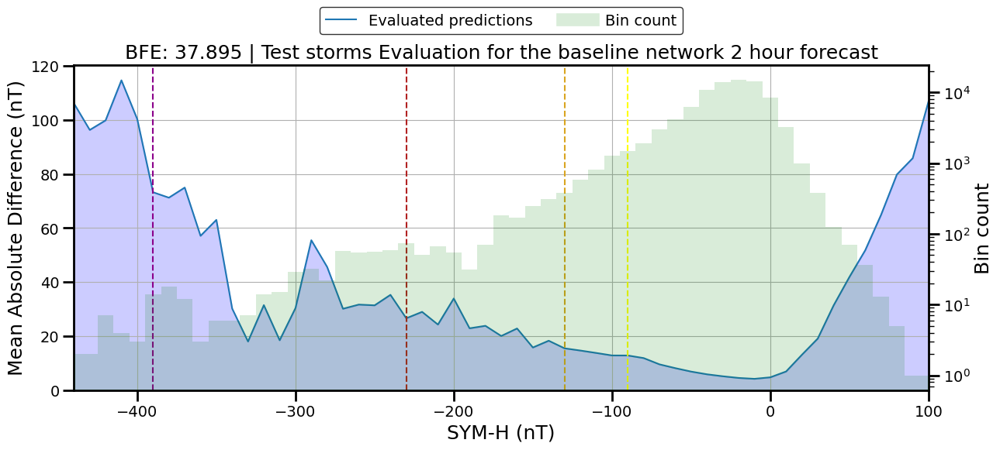

In [17]:
all_preds_test.to_csv('predictions/all_predictions_test_network_sym_2h.csv')

fig, ax = plt.subplots(1, 1, figsize=(13, 6))

utils.plot_evaluation_sym(all_preds_test, 'Test storms Evaluation for the baseline network 2 hour forecast', 
                          ax = ax)
plt.tight_layout()
plt.savefig('./figs/bfe_test_baseline_sym_2h_transparent.png', transparent = True)
plt.savefig('./figs/bfe_test_baseline_sym_2h.png', transparent = False)

,StormIndex,Network BFE,Network RMSE,Network R2
0,81,25.470,13.298,0.563
1,82,20.865,15.155,0.856
2,83,12.681,12.958,0.789
3,84,20.651,16.428,0.792
4,85,10.833,10.092,0.840
5,86,10.173,10.693,0.829
6,87,21.545,12.355,0.723
7,88,11.819,9.968,0.858
8,89,32.143,19.606,0.876
9,90,19.670,14.682,0.777


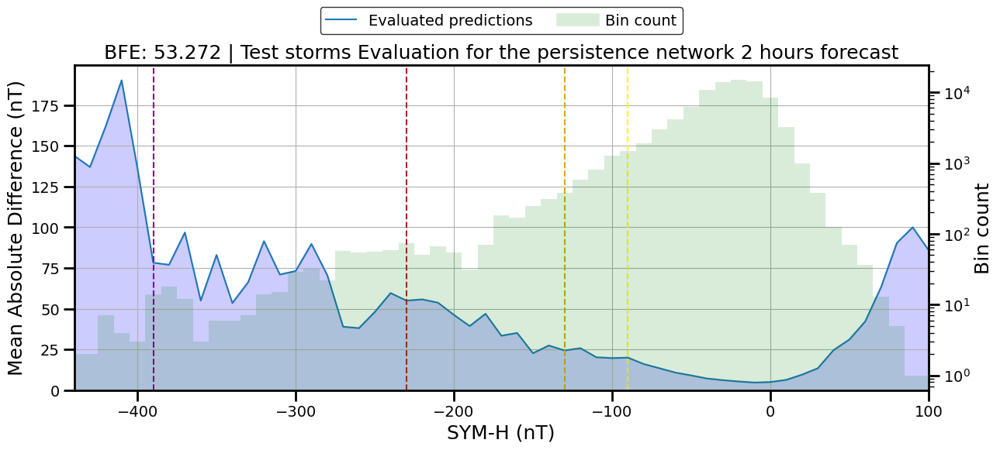

In [18]:
persistence_test_dfs = []

summary_df_test_persistence = None

for index_strm, test_storm in enumerate(test_storms):    
    persistence_df = test_storm[[INDEX_COL]].copy()
    persistence_df['persistence_' + INDEX_COL] = persistence_df[INDEX_COL].shift(np.abs(SHIFT_VALUE))        
    start_date = utils.convert_to_datetime(storm_dates.TEST_STORMS[index_strm][0])
    end_date = utils.convert_to_datetime(storm_dates.TEST_STORMS[index_strm][1])
    persistence_df = persistence_df[start_date : end_date]
    persistence_test_dfs.append(persistence_df)
    rmse = metrics.rmse(
        persistence_df[start_date : end_date][INDEX_COL],
        persistence_df[start_date : end_date]['persistence_' + INDEX_COL]        
    )
    r2 = metrics.r2m(
        persistence_df[start_date : end_date][INDEX_COL],
        persistence_df[start_date : end_date]['persistence_' + INDEX_COL]        
    )
    
    bfe = metrics.calculate_BFE(
        persistence_df[start_date : end_date][INDEX_COL],
        persistence_df[start_date : end_date]['persistence_' + INDEX_COL]
    )
    summary_df_test_persistence_data = [
        str(index_strm + start_index_storm)    
    ]    
    summary_df_test_persistence_data.append(bfe)
    summary_df_test_persistence_data.append(rmse)
    summary_df_test_persistence_data.append(r2)
    if summary_df_test_persistence is None:
        summary_df_test_persistence = pd.DataFrame([summary_df_test_persistence_data], 
                                                   columns = summary_columns)
    else:
        summary_df_test_persistence = pd.concat([
            summary_df_test_persistence,
            pd.DataFrame(
                data = [summary_df_test_persistence_data],
                columns = summary_columns
            )
        ])

data_for_means = ['Mean:']
for col in summary_df_test_persistence.columns[1:]:
    data_for_means.append(np.mean(summary_df_test_persistence[col]))
    
summary_df_test_persistence = pd.concat([
    summary_df_test_persistence,
    pd.DataFrame(
        data = [data_for_means],
        columns = summary_columns,
    )
], ignore_index = True)

persistence_test = pd.concat(persistence_test_dfs)
global_rmse = metrics.rmse(persistence_test[INDEX_COL], persistence_test['persistence_' + INDEX_COL])
global_r2 = metrics.r2m(persistence_test[INDEX_COL], persistence_test['persistence_' + INDEX_COL])
global_bfe = metrics.calculate_BFE(persistence_test[INDEX_COL], persistence_test['persistence_' + INDEX_COL])
data_for_global = ['Global:', global_bfe, global_rmse, global_r2]

summary_df_test_persistence = pd.concat([
    summary_df_test_persistence,
    pd.DataFrame(
        data = [data_for_global],
        columns = summary_columns,
    )
], ignore_index = True)

display(summary_df_test_persistence.round(3))

fig, ax = plt.subplots(1, 1, figsize=(13, 6))

utils.plot_evaluation_sym(persistence_test, 'Test storms Evaluation for the persistence network 2 hours forecast', 
                          ax = ax)
plt.tight_layout()
plt.savefig('./figs/bfe_test_persistence_sym_2h_transparent.png', transparent = True)
plt.savefig('./figs/bfe_test_persistence_sym_2h.png', transparent = False)

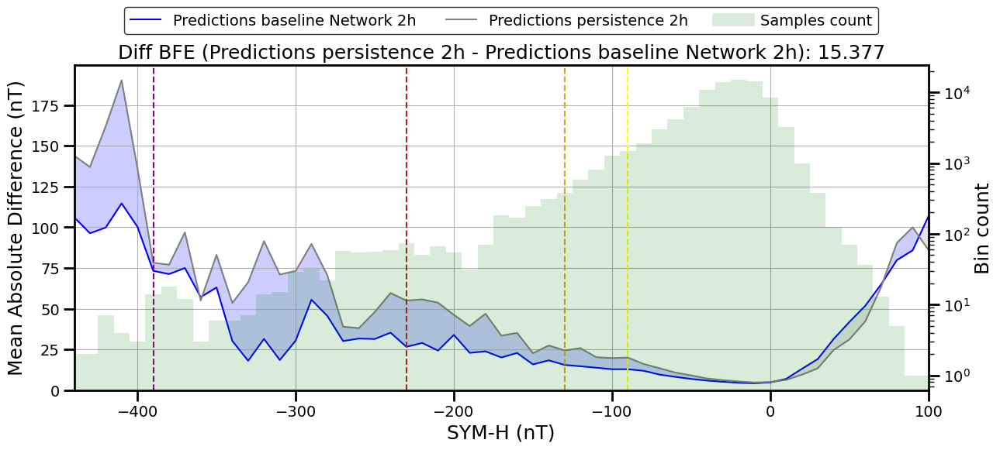

In [19]:
fig, ax = plt.subplots(1, 1, figsize=(13, 6))
utils.plot_comparison_sym(all_preds_test, persistence_test, 
                          'Predictions baseline Network 2h', 
                          'Predictions persistence 2h', ax = ax)
plt.tight_layout()
plt.savefig('./figs/comparison_test_persistence_baseline_2h_sym_transparent.png', transparent = True)
plt.savefig('./figs/comparison_test_persistence_baseline_2h_sym.png', transparent = False)

## Evaluate the test key storms <a class="anchor" id="section_2_2"></a>

Test storm number 117, from 2018-08-24 00:00:00 until 2018-08-31 00:00:00, number of batches: 3168
From 2018-08-24 00:00:00 until 2018-08-31 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


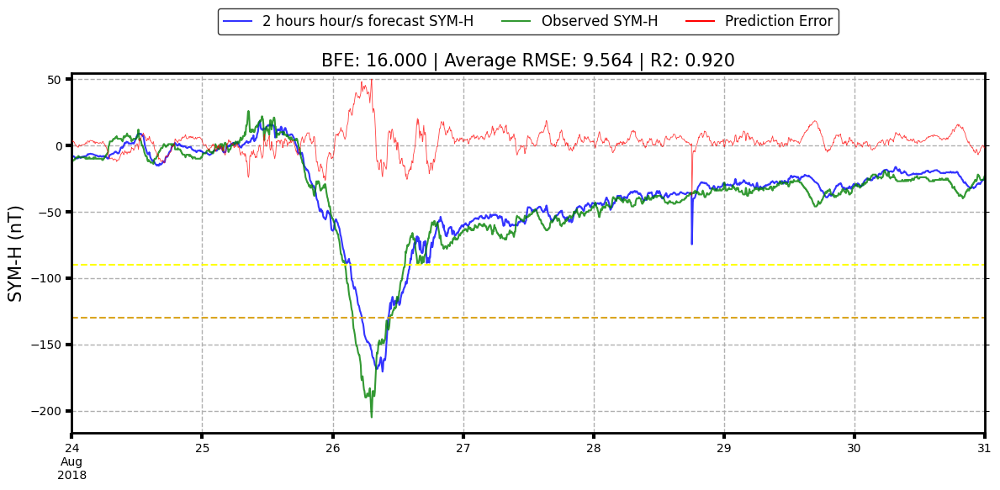

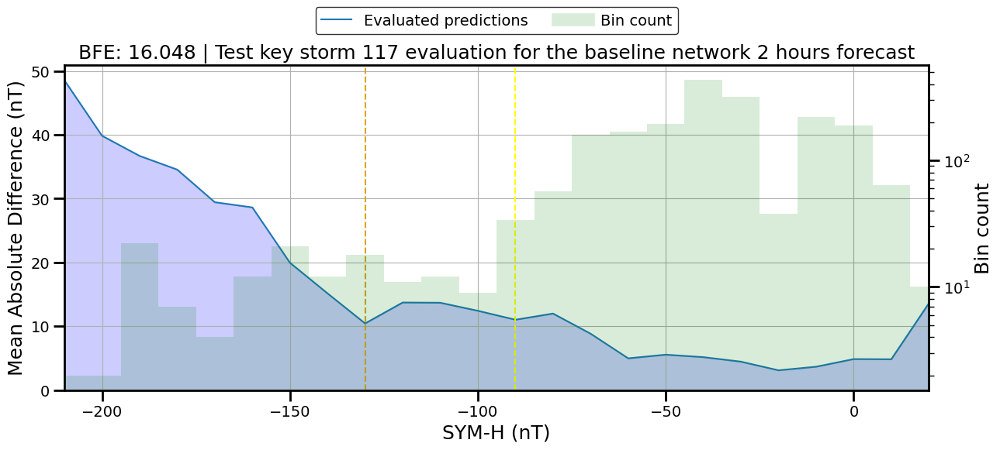

This network predicted_SYM_H --> rmse = 9.564 | r2 = 0.933 | BFE = 16.048
Test storm number 118, from 2021-08-26 00:00:00 until 2021-09-02 00:00:00, number of batches: 3168
From 2021-08-26 00:00:00 until 2021-09-02 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


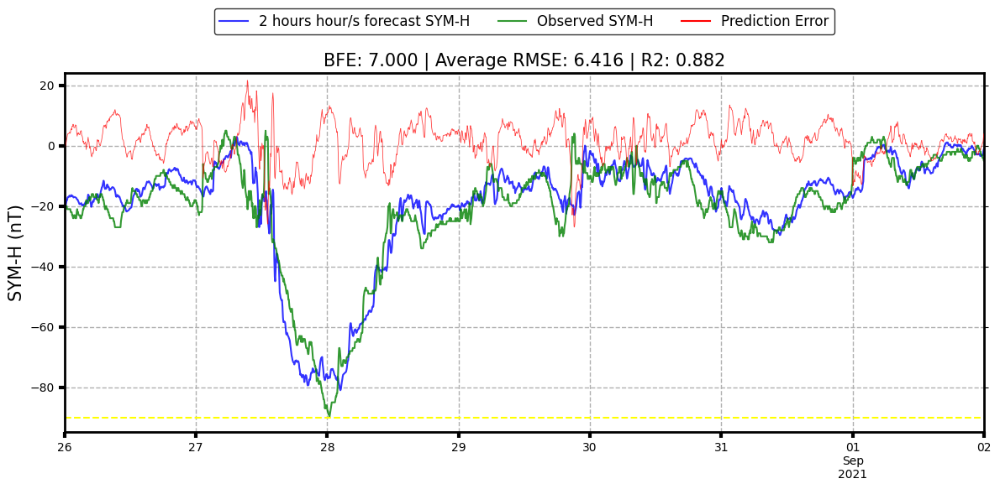

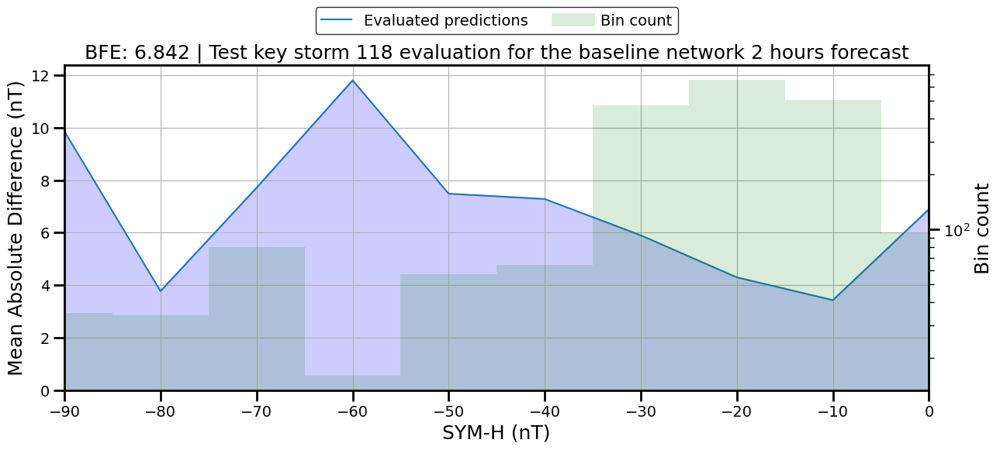

This network predicted_SYM_H --> rmse = 6.416 | r2 = 0.875 | BFE = 6.842
Test storm number 119, from 2021-11-02 00:00:00 until 2021-11-09 00:00:00, number of batches: 3168
From 2021-11-02 00:00:00 until 2021-11-09 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


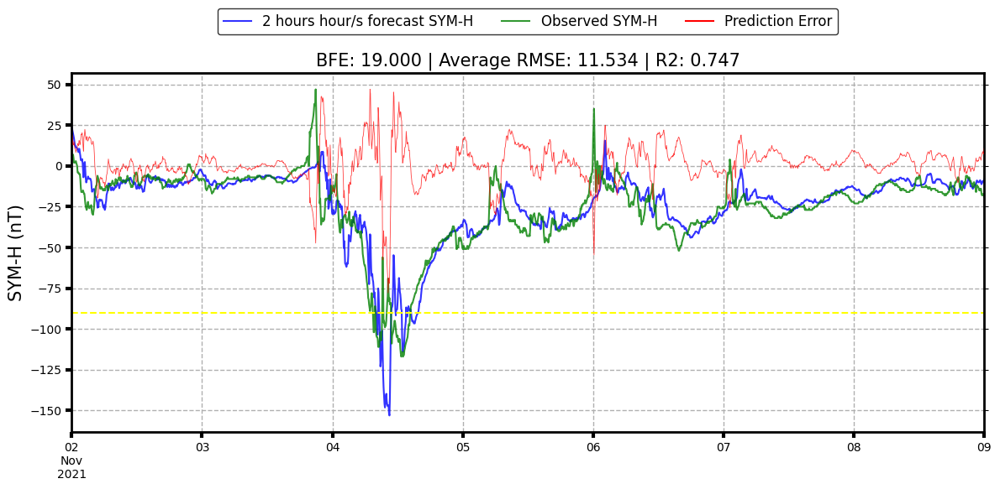

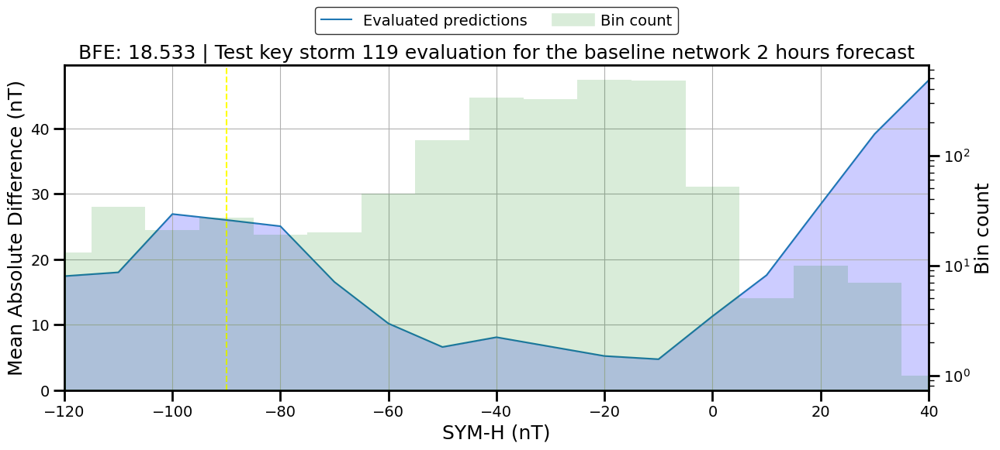

This network predicted_SYM_H --> rmse = 11.534 | r2 = 0.745 | BFE = 18.533
Test storm number 120, from 2022-01-12 00:00:00 until 2022-01-19 00:00:00, number of batches: 3168
From 2022-01-12 00:00:00 until 2022-01-19 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


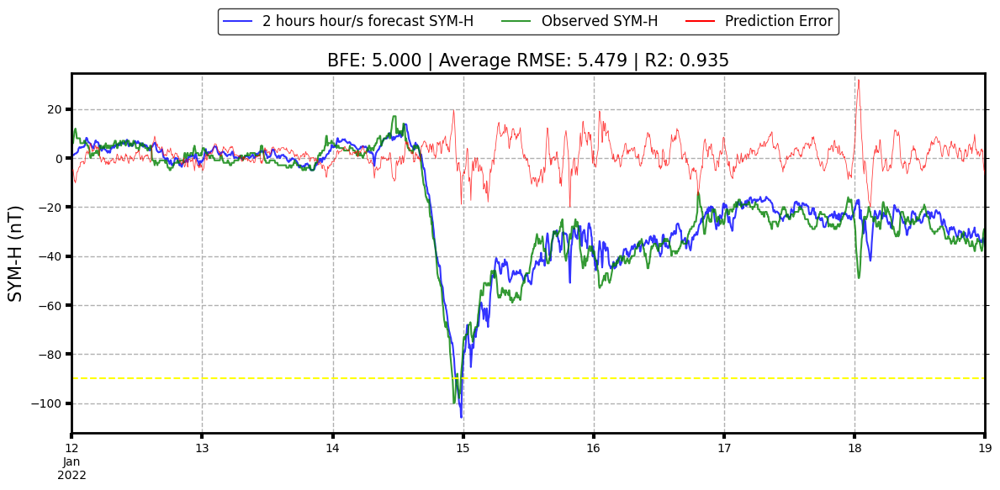

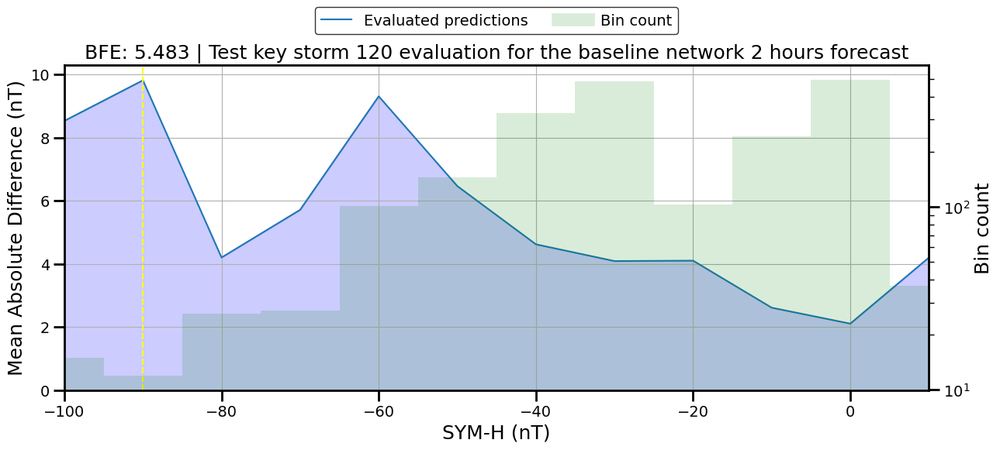

This network predicted_SYM_H --> rmse = 5.479 | r2 = 0.938 | BFE = 5.483
Test storm number 121, from 2022-03-11 00:00:00 until 2022-03-19 00:00:00, number of batches: 3456
From 2022-03-11 00:00:00 until 2022-03-19 00:00:00 shape: (2305, 2)
Metrics comparing SYM_H with predicted_SYM_H


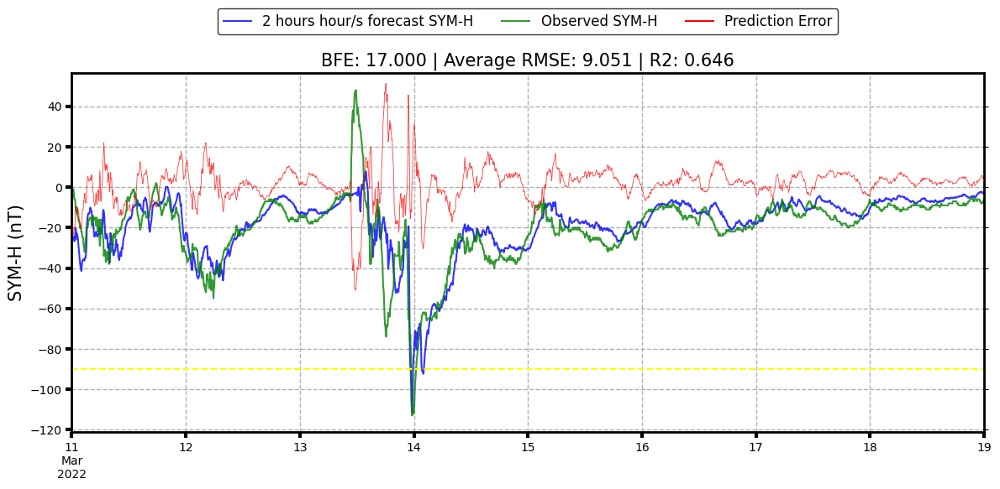

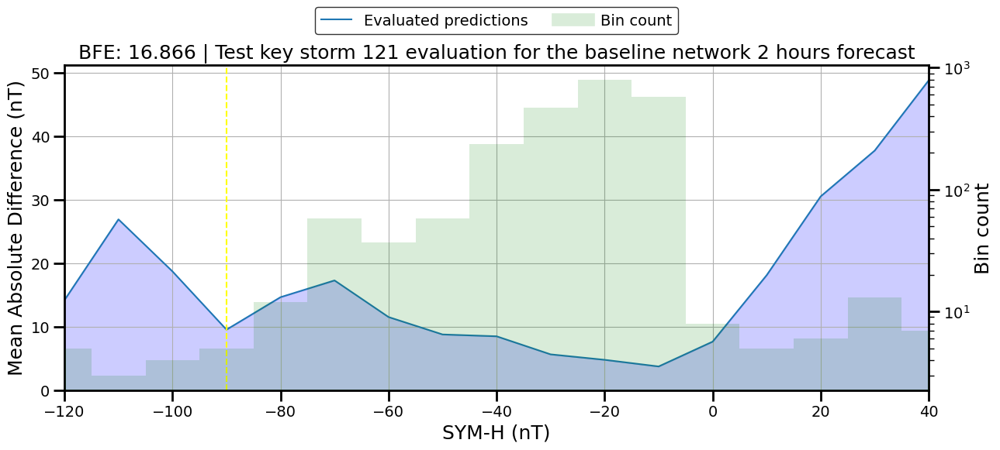

This network predicted_SYM_H --> rmse = 9.051 | r2 = 0.694 | BFE = 16.866
Test storm number 122, from 2022-11-05 00:00:00 until 2022-11-12 00:00:00, number of batches: 3168
From 2022-11-05 00:00:00 until 2022-11-12 00:00:00 shape: (2017, 2)
Metrics comparing SYM_H with predicted_SYM_H


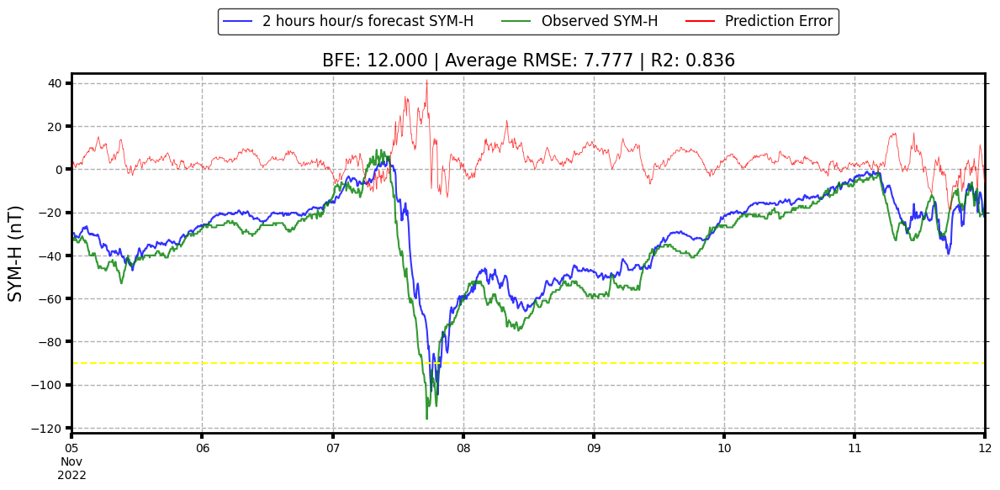

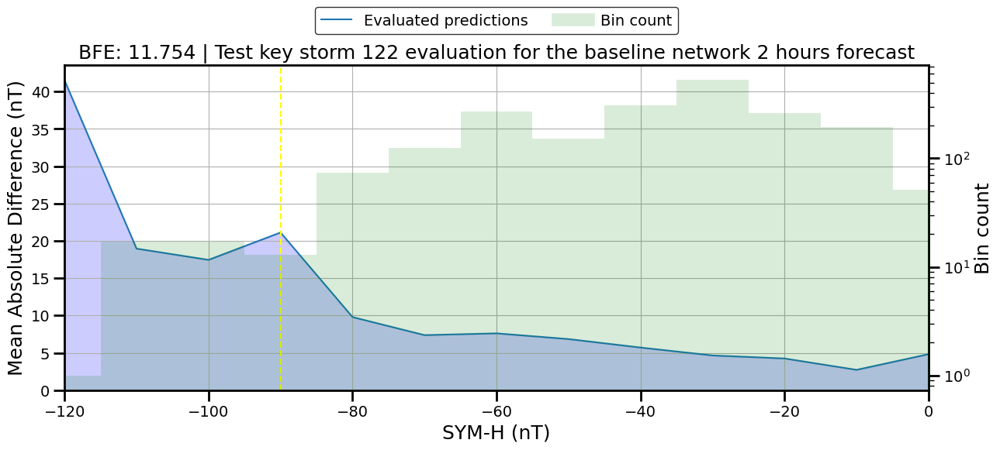

This network predicted_SYM_H --> rmse = 7.777 | r2 = 0.869 | BFE = 11.754


,StormIndex,Network BFE,Network RMSE,Network R2
0,117,16.048000,9.564,0.933
1,118,6.842000,6.416,0.875
2,119,18.533001,11.534,0.745
3,120,5.483000,5.479,0.938
4,121,16.865999,9.051,0.694
5,122,11.754000,7.777,0.869
6,Mean:,12.588000,8.304,0.843
7,Global:,19.367001,8.557,0.882


In [20]:
start_index_storm = len(storm_dates.TRAIN_STORMS) + len(storm_dates.VALIDATION_STORMS) + len(storm_dates.TEST_STORMS) + 1

original_index = "SYM_H"
predicted_index = "predicted_SYM_H"
output_columns = ["storm_index", "datetime", original_index, predicted_index]

summary_df_test_key_baseline = None

all_predictions_dfs_test_key = []

for index_strm, test_storm in enumerate(test_key_storms):
    
    start_date = utils.convert_to_datetime(storm_dates.TEST_KEY_STORMS[index_strm][0])
    end_date = utils.convert_to_datetime(storm_dates.TEST_KEY_STORMS[index_strm][1])

    ln = len(test_storm)
    batch = np.zeros((ln - lookback, lookback, len(COLS_TO_USE)), dtype=np.float32)
    print(f"Test storm number {index_strm + start_index_storm}, from {start_date} until {end_date}, number of batches:", ln)

    labels = np.zeros((ln - lookback, 1), dtype=np.float32)

    for i in range(ln - lookback):
        batch[i] = scaler.transform(test_storm.iloc[i : i + lookback][COLS_TO_USE])
        labels[i] = test_storm.iloc[i + lookback - 1][LABEL_COLUMN]

    labels = labels.reshape(len(labels), 1)
    
    predicton_batches = []    
    
    for i in range(len(batch) // batch_size + 1):
        prediction = model(batch[i * batch_size : (i + 1) * batch_size], training = False).numpy()
        predicton_batches.append(prediction)
        
    predictions = np.vstack(predicton_batches).reshape(-1, 1)

    predictions_df = pd.DataFrame(columns = [predicted_index], data = predictions)    
    predictions_df[predicted_index] = labelScaler.inverse_transform(predictions_df[predicted_index].values.reshape(-1, 1))
    predictions_df[original_index] = labels
    predictions_df["storm_index"] = index_strm + start_index_storm    
    predictions_df.index = test_storm.index[lookback -1: -1]
    predictions_df = predictions_df.shift(np.abs(SHIFT_VALUE))
    predictions_df = predictions_df.dropna()
    predictions_df = predictions_df[[original_index, predicted_index]]

    print(f'From {predictions_df[start_date : end_date].index[0]} ' +
         f'until {predictions_df[start_date : end_date].index[-1]} ' +
         f'shape: {predictions_df[start_date : end_date].shape}')
    
    all_predictions_dfs_test_key.append(predictions_df[start_date:end_date])
    
    summary_df_test_key_baseline_data = [
        str(index_strm + start_index_storm)    
    ]
    
    print(f'Metrics comparing {original_index} with {predicted_index}')
    if plot_graphs:
        utils.plot_prediction_sym(predictions_df[start_date:end_date], '2 hours', index_strm + start_index_storm, False)
        plt.tight_layout();
        plt.show();
        utils.plot_evaluation_sym(predictions_df[start_date:end_date], f'Test key storm {index_strm + start_index_storm} evaluation for the baseline network 2 hours forecast')
        plt.tight_layout();
        plt.show();
        
    rmse = metrics.rmse(
        predictions_df[start_date : end_date][original_index],
        predictions_df[start_date : end_date][predicted_index]        
    )
    r2 = metrics.r2m(
        predictions_df[start_date : end_date][original_index],
        predictions_df[start_date : end_date][predicted_index]        
    )
    
    bfe = metrics.calculate_BFE(
        predictions_df[start_date : end_date][original_index],
        predictions_df[start_date : end_date][predicted_index]
    )
    
    summary_df_test_key_baseline_data.append(bfe)
    summary_df_test_key_baseline_data.append(rmse)
    summary_df_test_key_baseline_data.append(r2)
    print(f'This network {predicted_index} --> rmse = {rmse:.3f} | r2 = {r2:.3f} | BFE = {bfe:.3f}')
    
    if summary_df_test_key_baseline is None:
        summary_df_test_key_baseline = pd.DataFrame([summary_df_test_key_baseline_data], columns = summary_columns)
    else:
        summary_df_test_key_baseline = pd.concat([
            summary_df_test_key_baseline,
            pd.DataFrame(
                data = [summary_df_test_key_baseline_data],
                columns = summary_columns
            )
        ])
    
data_for_means = ['Mean:']
for col in summary_df_test_key_baseline.columns[1:]:
    data_for_means.append(np.mean(summary_df_test_key_baseline[col]))
    
summary_df_test_key_baseline = pd.concat([
    summary_df_test_key_baseline,
    pd.DataFrame(
        data = [data_for_means],
        columns = summary_columns,
    )
], ignore_index = True)

all_preds_test_key = pd.concat(all_predictions_dfs_test_key)
global_rmse = metrics.rmse(all_preds_test_key[original_index], all_preds_test_key[predicted_index])
global_r2 = metrics.r2m(all_preds_test_key[original_index], all_preds_test_key[predicted_index])
global_bfe = metrics.calculate_BFE(all_preds_test_key[original_index], all_preds_test_key[predicted_index])
data_for_global = ['Global:', global_bfe, global_rmse, global_r2]

summary_df_test_key_baseline = pd.concat([
    summary_df_test_key_baseline,
    pd.DataFrame(
        data = [data_for_global],
        columns = summary_columns,
    )
], ignore_index = True)

display(summary_df_test_key_baseline.round(3))

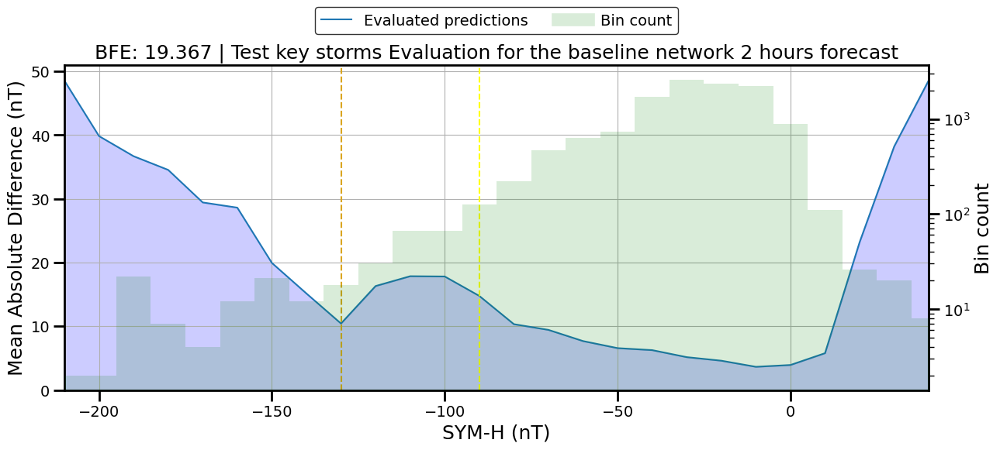

In [21]:
all_preds_test_key = pd.concat(all_predictions_dfs_test_key)
all_preds_test_key.to_csv('predictions/all_predictions_test_key_network_sym_2h.csv')

fig, ax = plt.subplots(1, 1, figsize=(13, 6))

utils.plot_evaluation_sym(all_preds_test_key, 'Test key storms Evaluation for the baseline network 2 hours forecast', ax = ax)
plt.tight_layout()
plt.savefig('./figs/bfe_test_key_baseline_sym_2h_transparent.png', transparent = True)
plt.savefig('./figs/bfe_test_key_baseline_sym_2h.png', transparent = False)

,StormIndex,Network BFE,Network RMSE,Network R2
0,117,22.326,13.153,0.874
1,118,9.084,8.009,0.806
2,119,19.595,12.998,0.677
3,120,11.372,8.537,0.850
4,121,31.543,13.291,0.340
5,122,12.947,8.934,0.827
6,Mean:,17.811,10.820,0.729
7,Global:,24.028,11.128,0.801


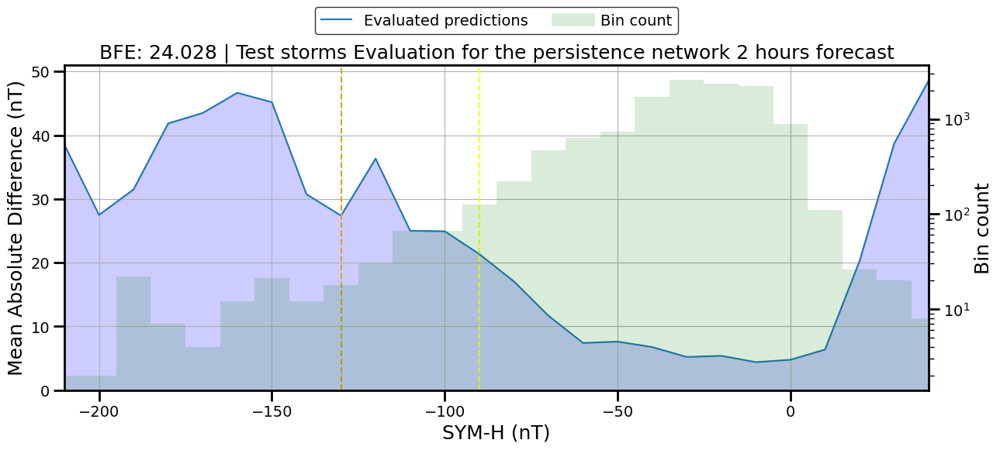

In [22]:
persistence_test_key_dfs = []

summary_df_test_key_persistence = None

for index_strm, test_key_storm in enumerate(test_key_storms):    
    persistence_df = test_key_storm[[INDEX_COL]].copy()
    persistence_df['persistence_' + INDEX_COL] = persistence_df[INDEX_COL].shift(np.abs(SHIFT_VALUE))        
    start_date = utils.convert_to_datetime(storm_dates.TEST_KEY_STORMS[index_strm][0])
    end_date = utils.convert_to_datetime(storm_dates.TEST_KEY_STORMS[index_strm][1])
    persistence_df = persistence_df[start_date : end_date]
    persistence_test_key_dfs.append(persistence_df)
    rmse = metrics.rmse(
        persistence_df[start_date : end_date][INDEX_COL],
        persistence_df[start_date : end_date]['persistence_' + INDEX_COL]        
    )
    r2 = metrics.r2m(
        persistence_df[start_date : end_date][INDEX_COL],
        persistence_df[start_date : end_date]['persistence_' + INDEX_COL]        
    )
    
    bfe = metrics.calculate_BFE(
        persistence_df[start_date : end_date][INDEX_COL],
        persistence_df[start_date : end_date]['persistence_' + INDEX_COL]
    )
    summary_df_test_key_persistence_data = [
        str(index_strm + start_index_storm)    
    ]    
    summary_df_test_key_persistence_data.append(bfe)
    summary_df_test_key_persistence_data.append(rmse)
    summary_df_test_key_persistence_data.append(r2)
    if summary_df_test_key_persistence is None:
        summary_df_test_key_persistence = pd.DataFrame([summary_df_test_key_persistence_data], 
                                                   columns = summary_columns)
    else:
        summary_df_test_key_persistence = pd.concat([
            summary_df_test_key_persistence,
            pd.DataFrame(
                data = [summary_df_test_key_persistence_data],
                columns = summary_columns
            )
        ])

data_for_means = ['Mean:']
for col in summary_df_test_key_persistence.columns[1:]:
    data_for_means.append(np.mean(summary_df_test_key_persistence[col]))
    
summary_df_test_key_persistence = pd.concat([
    summary_df_test_key_persistence,
    pd.DataFrame(
        data = [data_for_means],
        columns = summary_columns,
    )
], ignore_index = True)

persistence_test_key = pd.concat(persistence_test_key_dfs)
global_rmse = metrics.rmse(persistence_test_key[INDEX_COL], persistence_test_key['persistence_' + INDEX_COL])
global_r2 = metrics.r2m(persistence_test_key[INDEX_COL], persistence_test_key['persistence_' + INDEX_COL])
global_bfe = metrics.calculate_BFE(persistence_test_key[INDEX_COL], persistence_test_key['persistence_' + INDEX_COL])
data_for_global = ['Global:', global_bfe, global_rmse, global_r2]

summary_df_test_key_persistence = pd.concat([
    summary_df_test_key_persistence,
    pd.DataFrame(
        data = [data_for_global],
        columns = summary_columns,
    )
], ignore_index = True)

display(summary_df_test_key_persistence.round(3))

fig, ax = plt.subplots(1, 1, figsize=(13, 6))

utils.plot_evaluation_sym(persistence_test_key, 'Test storms Evaluation for the persistence network 2 hours forecast', 
                          ax = ax)
plt.tight_layout()
plt.savefig('./figs/bfe_test_key_persistence_sym_2h_transparent.png', transparent = True)
plt.savefig('./figs/bfe_test_key_persistence_sym_2h.png', transparent = False)

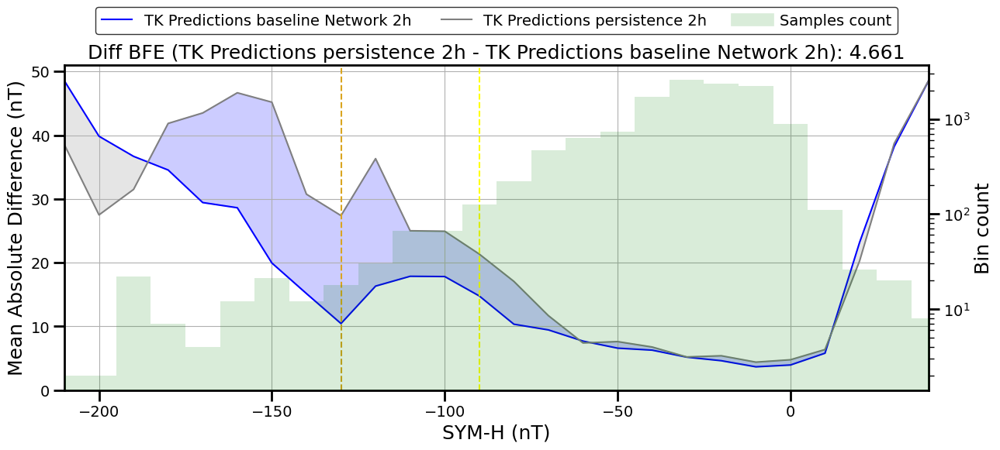

In [23]:
fig, ax = plt.subplots(1, 1, figsize=(13, 6))
utils.plot_comparison_sym(all_preds_test_key, persistence_test_key, 
                          'TK Predictions baseline Network 2h', 
                          'TK Predictions persistence 2h', ax = ax)
plt.tight_layout()
plt.savefig('./figs/comparison_test_key_persistence_baseline_2h_sym_transparent.png', transparent = True)
plt.savefig('./figs/comparison_test_key_persistence_baseline_2h_sym.png', transparent = False)

## Comparison to the 1 hour ahead model <a class="anchor" id="section_2_3"></a>

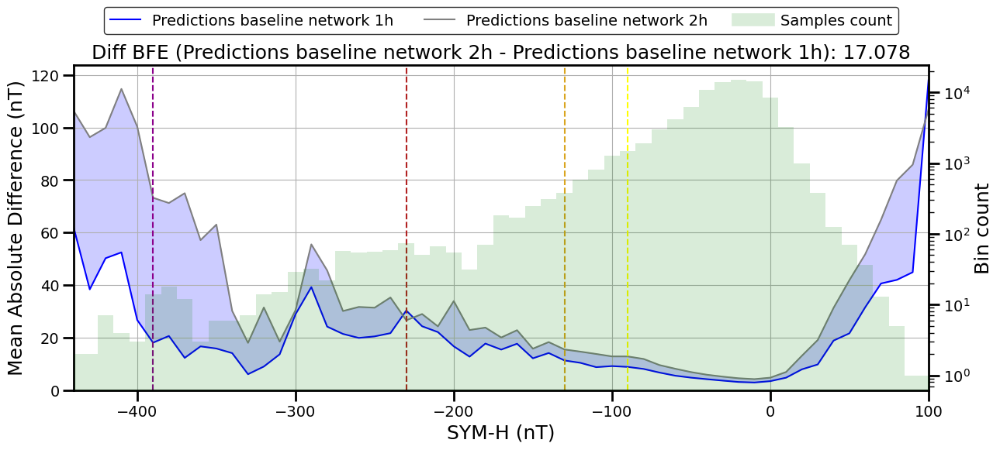

In [24]:
all_preds_network_1h = pd.read_csv('predictions/all_predictions_test_network_sym_1h.csv', parse_dates = ['datetime'], index_col = 'datetime')
fig, ax = plt.subplots(1, 1, figsize=(13, 6))
utils.plot_comparison_sym(all_preds_network_1h, all_preds_test, 
                          'Predictions baseline network 1h', 'Predictions baseline network 2h', ax = ax)
plt.tight_layout()
plt.savefig('./figs/test_only_comparison_baseline_1h_2h_sym_transparent.png', transparent = True)
plt.savefig('./figs/test_only_comparison_baseline_1h_2h_sym.png', transparent = False)